# **$\color{blue}{\text{ValueInvestor: Stock market forecasting}}$**  

It's a portfolio investment company and it makes investments in the emerging markets around the world. The company profits by investing in profitable companies, buying, holding and selling company stocks based on value investing principles.

* **$\color{blue}{\text{The goal of this work:}}$**    

The goal of this work is to establish a robust intelligent system to aid the company's value investing efforts using stock market data. I make investment decisions and based on intrinsic value of companies and do not trade on the basis of daily market volatility.

* **$\color{blue}{\text{Data Description:}}$**  

A set of portfolio companies trading data from emerging markets including 2020 Q1-Q2-Q3-Q4 2021 Q1 stock prices. Each company stock is provided in different sheets. Each market's operating days varies based on the country of the company and the market the stocks are exchanged. Use only 2020 data and predict with 2021 Q1 data.

* **$\color{blue}{\text{The planing of this work:}}$** 
For each company, I'll include the following process.
1.   **Data exploration**
2.   **Data preprocessing**
3.   **Data visualization**
4.   **Statistics tests**   
      4.1.  **Rooling tests**          
      4.2.  **Augmented Dickey-Fuller test**           
      4.3.  **Make the data stationary**
5.   **Price Forecasting**    
      4.1.  **ARIMA**             
      4.2.  **ARIMAX**   
      4.3.  **LSTM**   
      4.4.  **GRU**    
6.  **Make recommendations using tree based models**   
7.   **Conclusion**
Let's start!

In [739]:
#import necessary libraries
import warnings
warnings.filterwarnings('ignore')
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns
import time
from tqdm import tqdm_notebook
%matplotlib inline
# any plot will be in this notebook not in another open window
from matplotlib.pylab import rcParams
rcParams['figure.figsize']=20,10
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
#from statsmodels.tsa.arima_model import ARIMA
from statsmodels.graphics.tsaplots import plot_predict
from statsmodels.tsa.arima.model import ARIMA
from pmdarima.arima import auto_arima
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error
import math
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import accuracy_score
#keras
from keras.models import Sequential
from keras.metrics import MeanSquaredError
from keras.layers import Dense, SimpleRNN, GRU, LSTM, Dropout
from tensorflow.keras.optimizers import SGD
#recommendation
from sklearn.ensemble import RandomForestRegressor
from tensorflow.keras.utils import to_categorical
from pprint import pprint
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import roc_curve, auc
from sklearn.model_selection import GridSearchCV
from keras.wrappers.scikit_learn import KerasRegressor
from imblearn.combine import SMOTETomek
from imblearn.under_sampling import TomekLinks
from hyperopt import fmin, tpe, hp, STATUS_OK, Trials
import sys
from keras.layers import BatchNormalization
from hyperopt.pyll.base import scope
from sklearn.ensemble import RandomForestClassifier 
from sklearn import metrics
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import train_test_split
from keras.callbacks import EarlyStopping
from keras.models import Sequential
from keras.layers.core import Dense, Dropout, Activation
from tensorflow.keras.optimizers import SGD, Adam, RMSprop 
from keras.callbacks import EarlyStopping
import statsmodels.api
from sklearn.preprocessing import LabelEncoder
import xgboost as xgb
import lightgbm as lgbm
import catboost as cb
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.ensemble import StackingClassifier
from sklearn.tree import DecisionTreeClassifier
from termcolor import colored

In [117]:
'''def explore_fc(sheet_idx,):
    df = pd.ExcelFile('2020Q1Q2Q3Q4-2021Q1.xlsx')
    df+sheet_idx = df.parse(sheet_idx)'''

"def explore_fc(sheet_idx,):\n    df = pd.ExcelFile('2020Q1Q2Q3Q4-2021Q1.xlsx')\n    df+sheet_idx = df.parse(sheet_idx)"

In [118]:
#read excel file
df = pd.ExcelFile('2020Q1Q2Q3Q4-2021Q1.xlsx')

## I. Data exploration

In [119]:
# read the first sheet corresponds to the Russia country
df1_russia = df.parse(0)

In [120]:
df1_russia.shape

(312, 7)

Here is the meaning of the features
* Open: the price the stock opened at
* High: the highest price during the day
* Low: the lowest price during the day
* Price: the closing price on the trading day
* Vol.: Volume – how many shares were traded
* changes %: is the percentage of changes between the cuurent day and the previous day

In [121]:
#View the 5 rows in the dataframe
df1_russia.head()

,Date,Price,Open,High,Low,Vol.,Change %
0,2021-03-31 00:00:00,291.02,294.0,294.42,290.26,47.00M,-0.0076
1,2021-03-30 00:00:00,293.25,294.86,295.72,291.5,38.81M,-0.0002
2,2021-03-29 00:00:00,293.3,289.72,294.09,289.26,43.68M,0.0071
3,2021-03-26 00:00:00,291.22,288.63,292.75,288.32,56.07M,0.0159
4,2021-03-25 00:00:00,286.66,286.5,287.03,283.85,35.22M,0.0030


In [122]:
#view the last 5 values of the data
df1_russia.tail()

,Date,Price,Open,High,Low,Vol.,Change %
307,2020-01-09 00:00:00,257.99,259.4,261.76,257.01,38.33M,-0.0045
308,2020-01-08 00:00:00,259.15,253.57,259.15,253.03,40.82M,0.0207
309,2020-01-06 00:00:00,253.9,254.75,254.84,251.4,22.35M,-0.0043
310,2020-01-03 00:00:00,255.0,255.99,258.19,253.7,35.85M,0.0010
311,Highest: 296.07,Lowest: 172.15,Difference: 123.92,Average: 234.52,Change %: 14.24,NaN,NaN


In [123]:
df1_russia.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 312 entries, 0 to 311
Data columns (total 7 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   Date      312 non-null    object 
 1   Price     312 non-null    object 
 2   Open      312 non-null    object 
 3   High      312 non-null    object 
 4   Low       312 non-null    object 
 5   Vol.      311 non-null    object 
 6   Change %  311 non-null    float64
dtypes: float64(1), object(6)
memory usage: 17.2+ KB


In [124]:
df1_russia.describe()

,Change %
count,311.000000
mean,0.000668
std,0.021931
min,-0.095700
25%,-0.010100
50%,0.000400
75%,0.012950
max,0.129000


## 2. Data preprocessing

In [125]:
#Rename the Vol. column to Volume
df1_russia.rename(columns = {'Vol.': 'Volume'}, inplace = True)
df1_russia.head(2)

,Date,Price,Open,High,Low,Volume,Change %
0,2021-03-31 00:00:00,291.02,294.0,294.42,290.26,47.00M,-0.0076
1,2021-03-30 00:00:00,293.25,294.86,295.72,291.5,38.81M,-0.0002


In [126]:
#drop the last row
df1_russia.drop(df1_russia.shape[0]-1, axis=0, inplace=True)

In [127]:
#remove M caracter from the Volume feature
df1_russia["Volume"]=df1_russia.Volume.str.replace('M','')
df1_russia.head(2)

,Date,Price,Open,High,Low,Volume,Change %
0,2021-03-31 00:00:00,291.02,294.0,294.42,290.26,47.00,-0.0076
1,2021-03-30 00:00:00,293.25,294.86,295.72,291.5,38.81,-0.0002


In [128]:
#Let's make the row index of the DataFrame as the date the stock was traded. 
df1_russia["Date"]=pd.to_datetime(df1_russia.Date,format="%Y-%m-%d")
df1_russia=df1_russia.set_index(['Date'])
df1_russia.head()

,Price,Open,High,Low,Volume,Change %
Date,,,,,,
2021-03-31,291.02,294.0,294.42,290.26,47.00,-0.0076
2021-03-30,293.25,294.86,295.72,291.5,38.81,-0.0002
2021-03-29,293.3,289.72,294.09,289.26,43.68,0.0071
2021-03-26,291.22,288.63,292.75,288.32,56.07,0.0159
2021-03-25,286.66,286.5,287.03,283.85,35.22,0.0030


Stock doesn’t trade every day (there is no trading on weekends and holidays), so some dates are missing as we see above.

In [129]:
df1_russia.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 311 entries, 2021-03-31 to 2020-01-03
Data columns (total 6 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   Price     311 non-null    object 
 1   Open      311 non-null    object 
 2   High      311 non-null    object 
 3   Low       311 non-null    object 
 4   Volume    311 non-null    object 
 5   Change %  311 non-null    float64
dtypes: float64(1), object(5)
memory usage: 17.0+ KB


As we see, we should convert object features to float64 for good analysis further except the Date column.

In [130]:
df1_russia=df1_russia.astype({'Price':'float','Open':'float','High':'float','Low':'float','Volume':'float'})
print(df1_russia.dtypes)

Price       float64
Open        float64
High        float64
Low         float64
Volume      float64
Change %    float64
dtype: object


Now,let’s print some statistics such as the mean, median, min, max and standard deviation values for our features.

In [131]:
df1_russia.describe()

,Price,Open,High,Low,Volume,Change %
count,311.000000,311.000000,311.000000,311.000000,311.000000,311.000000
mean,234.524019,234.417846,237.314759,231.366141,73.056977,0.000668
std,32.079847,32.058167,32.075624,32.076603,38.058095,0.021931
min,174.270000,175.000000,182.200000,172.150000,8.760000,-0.095700
25%,207.700000,207.215000,209.660000,204.475000,47.670000,-0.010100
50%,229.140000,229.080000,231.950000,226.860000,66.260000,0.000400
75%,264.380000,263.885000,267.255000,261.110000,85.120000,0.012950
max,293.300000,294.860000,296.070000,291.500000,263.040000,0.129000


As we can see, ther is no missing values first. The highest close price over the discussed time is 293.3 and the lowest value is 291.5 

In [132]:
#check the absence of missing values in the dataframe
df1_russia.isnull().sum()

Price       0
Open        0
High        0
Low         0
Volume      0
Change %    0
dtype: int64

To recap:
- **Target Variable**: Price
- **Lines and columns**: 311 lines, 7 columns
- **Types of variables**: 6 Quantitatives variables, 1 date type variable 
- **Missing values analysis**: Ther is no missing values in the dataframe.

## 3. Data visualization
Next, let’s plot the data so we can see how the stock price has changed over time.  

Text(0.5, 1.0, 'Distribution of the price over time')

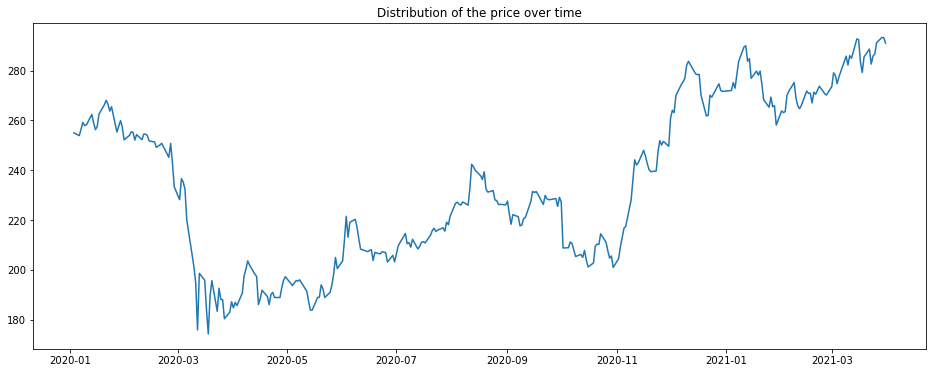

In [133]:
# Visualize stock prices
plt.figure(figsize=(16,6))
plt.plot(df1_russia["Price"],label='Close Price history')
plt.title('Distribution of the price over time')

We see that our data above is rough and contains lots of spikes for a time series. It isn’t very smooth and can be difficult for the model to extract trends from. To reduce the appearance of this we want to exponentially smooth our data before we compute the technical indicators.

<AxesSubplot:xlabel='Date'>

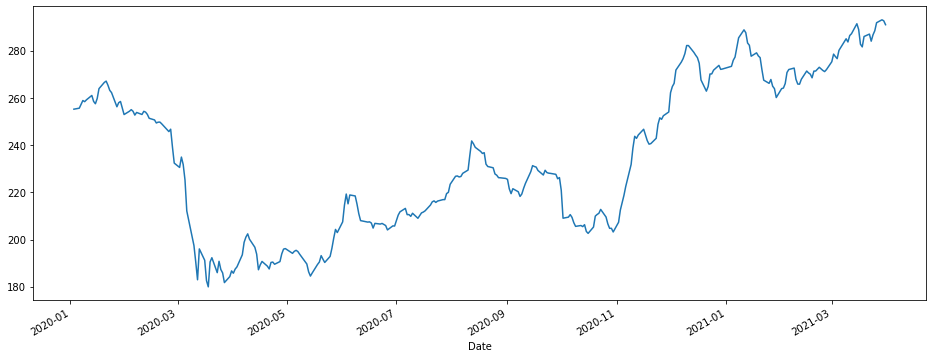

In [134]:
def _exponential_smooth(data, alpha):
    """
    Function that exponentially smooths dataset so values are less 'rigid'
    :param alpha: weight factor to weight recent values more
    """
    return data.ewm(alpha=alpha).mean()
plt.figure(figsize=(16,6))
data = _exponential_smooth(df1_russia, 0.65)
data['Price'].plot()

The stock’s daily closing price has increased in the first quarter of the year of 2021, comparing to the previous year

Since all values are positive, we can show this on both sides of the Y axis to emphasize the growth.

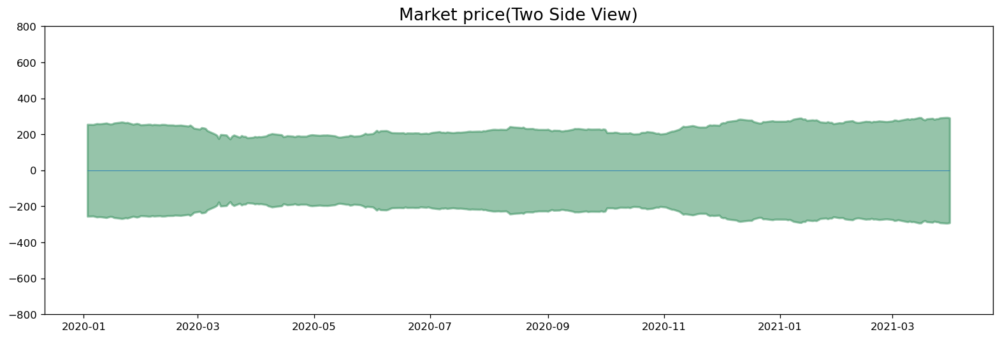

In [135]:
fig, ax = plt.subplots(1, 1, figsize=(16,5), dpi= 120)
plt.fill_between(df1_russia.index, y1=df1_russia.Price, y2=-df1_russia.Price, alpha=0.5, linewidth=2, color='seagreen')
plt.ylim(-800, 800)
plt.title('Market price(Two Side View)', fontsize=16)
plt.hlines(y=0, xmin=np.min(df1_russia.index), xmax=np.max(df1_russia.index), linewidth=.5)
plt.show()

* Since it's a monthly time series, we can plot each month as a separate line in the same plot.We can group the data at seasonal intervals and see how the values are distributed within a given year or month and how it compares over time.

In [136]:
# first make a new columns for the months and the year
#add year column
df1_russia['year'] = [d.year for d in df1_russia.index]
years = df1_russia['year'].unique()
#add month column
df1_russia['month'] = [d.month for d in df1_russia.index]
months = df1_russia['month'].unique()

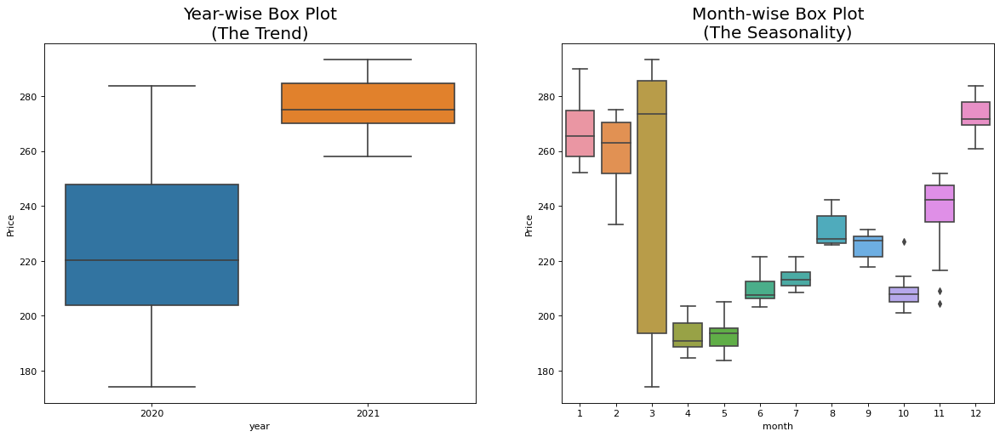

In [137]:
# Draw year_wise and month_wise box plots
fig, axes = plt.subplots(1, 2, figsize=(18,7), dpi= 80)
sns.boxplot(x='year', y='Price', data=df1_russia, ax=axes[0])
sns.boxplot(x='month', y='Price', data=df1_russia)

# Set Title
axes[0].set_title('Year-wise Box Plot\n(The Trend)', fontsize=18); 
axes[1].set_title('Month-wise Box Plot\n(The Seasonality)', fontsize=18)
plt.show()

 From the above plots, in the month-wise boxplot, the month of March has higher variation in stock price as well as the highest value comparing to other months. In the Year-wise boxplot, the year of 2020 has a higher variance, for the reason that we have just the first quarter in the next year of 2021.

<AxesSubplot:>

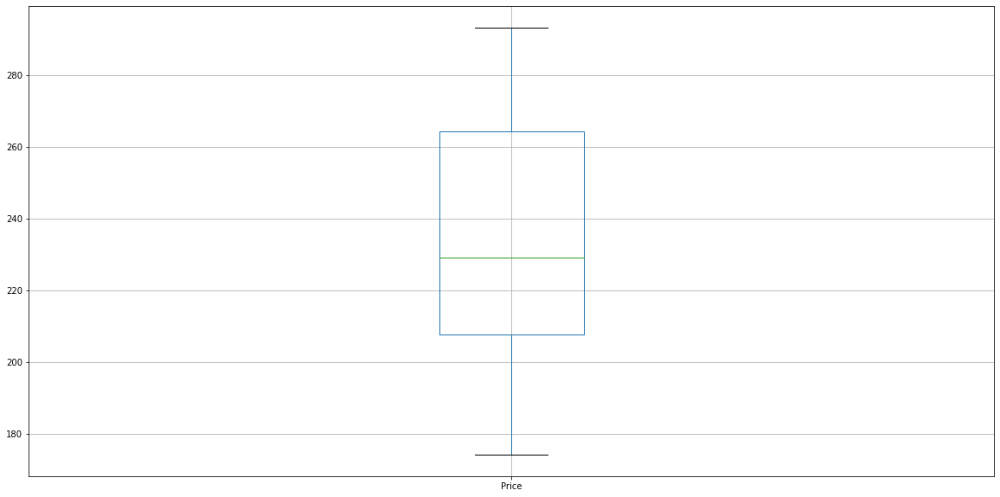

In [138]:
#plot the box plot of the price column
df1_russia.boxplot(column=['Price'])

From the above plot, we can see a big variation in the values of the price.

<Figure size 1152x576 with 0 Axes>

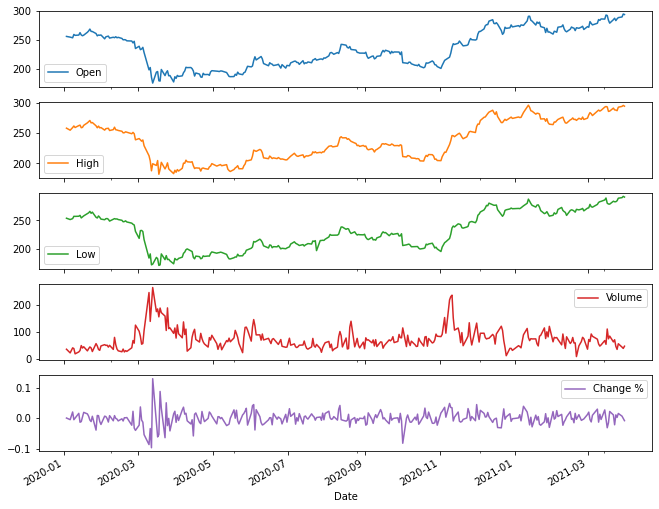

In [139]:
#Visualising plots of other columns in the dataset
plt.figure(figsize=(16, 8)) # resizing the plot
cols = ['Open', 'High', 'Low', 'Volume', 'Change %']
axes = df1_russia[cols].plot(figsize=(11, 9), subplots = True)
plt.show()

<Figure size 576x576 with 0 Axes>

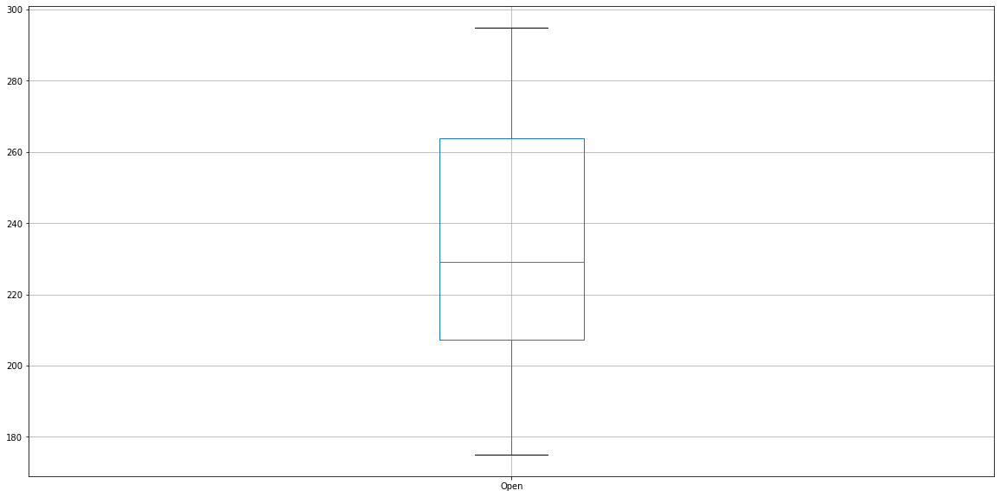

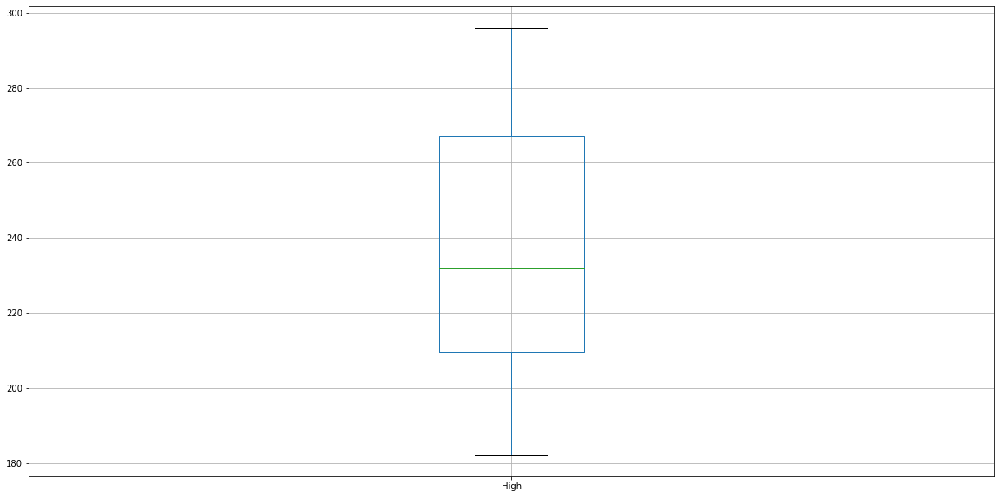

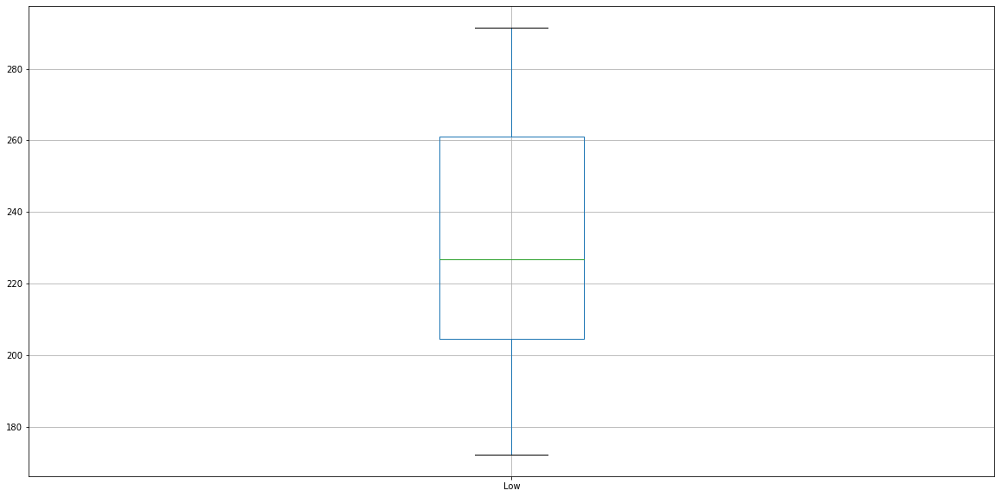

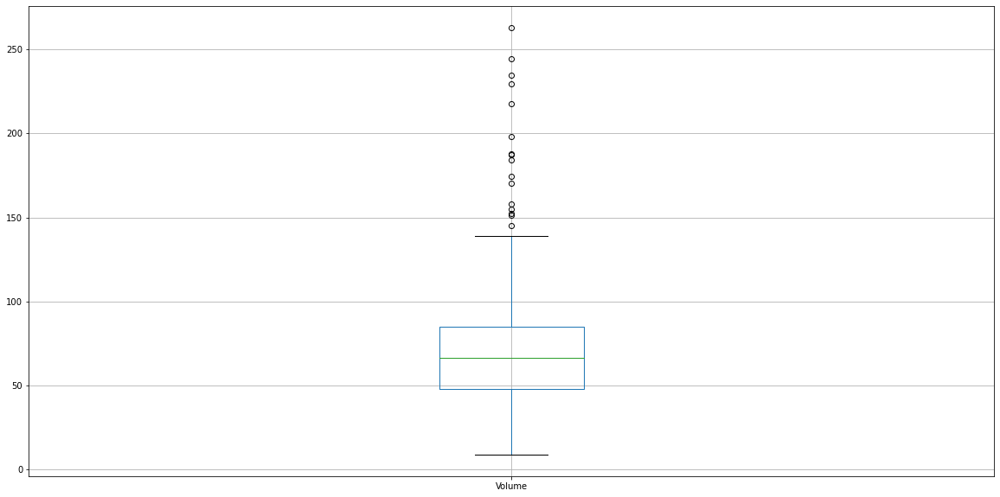

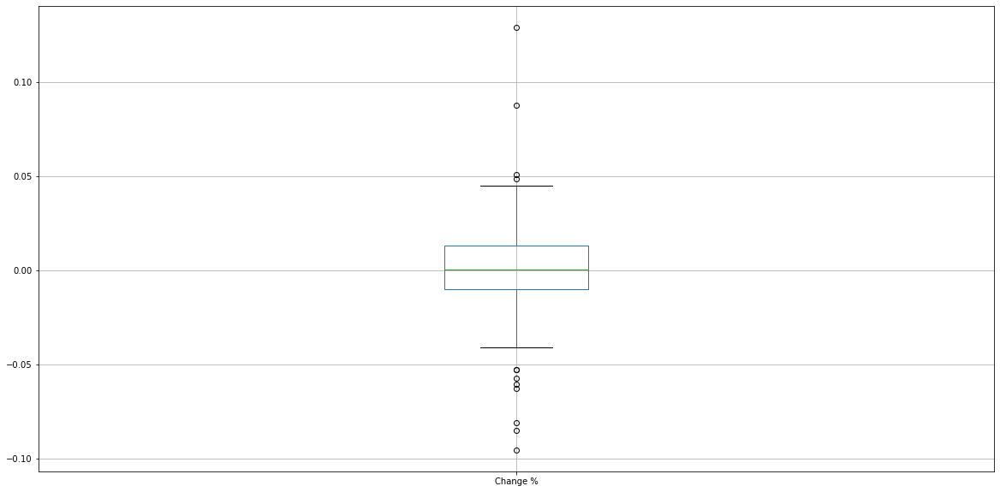

In [140]:
#Visualising box plots of other columns in the dataset
plt.figure(figsize=(8, 8)) # resizing the plot
cols = ['Open', 'High', 'Low', 'Volume', 'Change %']
for i in cols:
    plt.subplots()
    axes = df1_russia.boxplot(column= [i])
plt.show()

From the plots above, we can infer the existance of outliers in both volume and changes columns.
But, I prefer to not removing them now, as we trust on the dataset. Also, the variation is smaller in volume and change columns than in other features.      
Now let’s visualise the correlation between these features of the dataset. 

<AxesSubplot:>

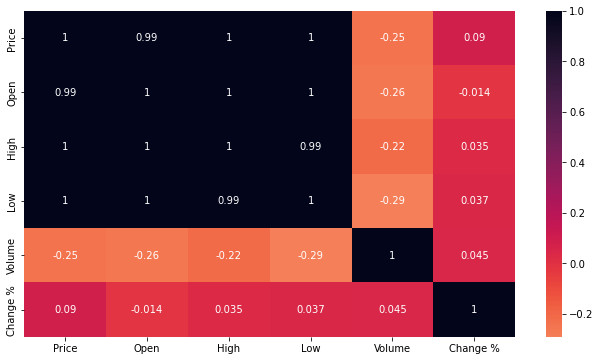

In [141]:
#plot the dataset feature map
plt.figure(figsize=(11,6)) # resizing the plot
sns.heatmap(df1_russia.drop(['year','month'],axis=1).corr(),annot=True, cmap=sns.cm.rocket_r, center=0.117)

In the above map, the dark color shows the high correlation between the values and the light colors shows less correlation between the variables. 
It shows that the Price has a very high positive correlation with the High and the Low features. Similarly for the Open feature. For the moment, I'll drop the Low, High and the Open features. 

In [142]:
#copy the data
df=df1_russia.copy()

In [143]:
#drop Open, Low, High, year and month columns
df1_russia=df1_russia.drop(['Open','Low','High','year','month'],axis=1)
df1_russia.head()

,Price,Volume,Change %
Date,,,
2021-03-31,291.02,47.00,-0.0076
2021-03-30,293.25,38.81,-0.0002
2021-03-29,293.30,43.68,0.0071
2021-03-26,291.22,56.07,0.0159
2021-03-25,286.66,35.22,0.0030


Because time series analysis only works with stationary data, we must first determine whether our series is stationary or not. I'll use two statistical tests to assess the model’s stability over time:The rooling statistics and the Dickey-Fuller DF test. 
So, the series becomes stationary if both the mean and standard deviation are flat lines (constant mean and constant variance).

## 4. Statistics tests
   * ### 4.1 Rooling statistics

<AxesSubplot:xlabel='Date'>

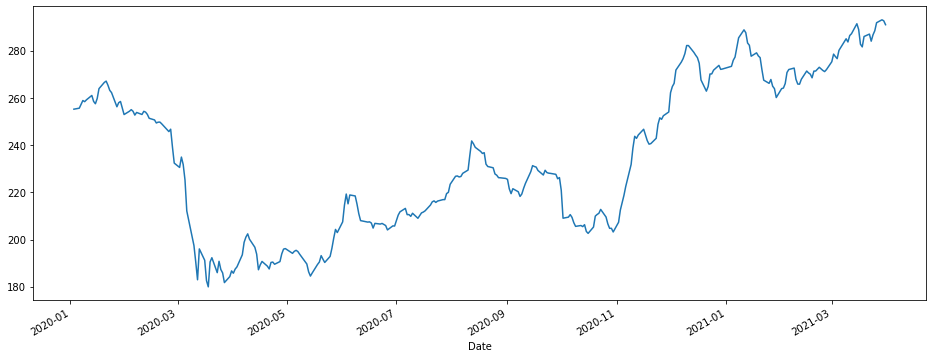

In [144]:
#let's plot again the original plot of price 
plt.figure(figsize=(16,6))
data = _exponential_smooth(df1_russia, 0.65)
data['Price'].plot()

From the plot above, we can notice that it is very difficult to gain knowledge from the above plot as the data fluctuates a lot. So, let us plot it again but using the Rolling Average concept this time.
For rolling average, I have to take a certain window size. Here, I have taken the window size = 7 i.e. rolling average of 7 days or 1 week.

In [145]:
# computing a 7 day rolling average
rolling_mean= df1_russia.Price.rolling(7).mean()
rolling_std= df1_russia.Price.rolling(7).std()
# viewing the dataset
print('rolling_mean:', rolling_mean.head(9),'\n')
print('rolling_std:', rolling_std.head(9))

rolling_mean: Date
2021-03-31           NaN
2021-03-30           NaN
2021-03-29           NaN
2021-03-26           NaN
2021-03-25           NaN
2021-03-24           NaN
2021-03-23    289.120000
2021-03-22    288.781429
2021-03-19    287.670000
Name: Price, dtype: float64 

rolling_std: Date
2021-03-31         NaN
2021-03-30         NaN
2021-03-29         NaN
2021-03-26         NaN
2021-03-25         NaN
2021-03-24         NaN
2021-03-23    4.127150
2021-03-22    4.041631
2021-03-19    3.659672
Name: Price, dtype: float64


We can observe that the first 6 values of both roling mean and roling std columns are NaN values. This is because these 6 values don’t have enough data to compute the rolling average of 7 days. 

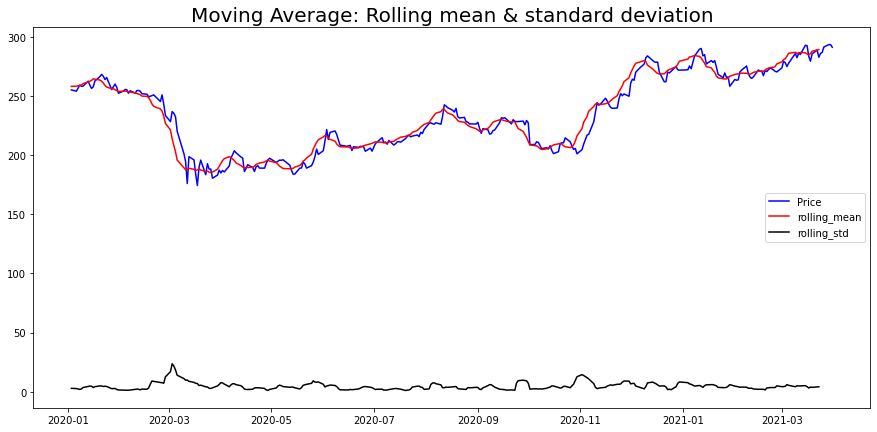

In [146]:
#plot rolling statistics
plt.figure(figsize=(15,7))
orig=plt.plot(df1_russia.Price, color='blue',label='Price')
R_mean=plt.plot(rolling_mean, color='red',label='rolling_mean')
R_std=plt.plot(rolling_std, color='black',label='rolling_std')
plt.legend(loc='best')
plt.title('Moving Average: Rolling mean & standard deviation',fontsize=20)
plt.show(block='False')

From the plot above, we can conclude that the mean and the std are not constant. So this time series isn't stationary.      Let's use the second test.

* ### 4.2 Augmented Dickey-Fuller test     

The **Augmented Dickey-Fuller** test is one of the more widely used tests and it's a type of statistical test called a unit root test.
The intuition behind a unit root test is that it determines how strongly a time series is defined by a trend.
It uses an autoregressive model and optimizes an information criterion across multiple different lag values.
* The null hypothesis of the test is that the time series can be represented by a unit root, that it is not stationary (has some time-dependent structure). 
* The alternate hypothesis (rejecting the null hypothesis) is that the time series is stationary.     
We interpret the result using the p-value from the test. 
* p-value > 0.05: Fail to reject the null hypothesis (H0), the data has a unit root and is non-stationary.
* p-value <= 0.05: Reject the null hypothesis (H0), the data does not have a unit root and is stationary.
* The more negative the Test Statistics value, the more likely we are to reject the null hypothesis. 

In [147]:
print("Results of dickey fuller test")
adft = adfuller(df1_russia.Price,autolag='AIC')
output = pd.Series(adft[0:4],index=['Test Statistics','p-value','Number of lags used','Number of observations used'])
for key,values in adft[4].items():
    output['critical value (%s)'%key] =  values
print(output)

Results of dickey fuller test
Test Statistics                 -1.847182
p-value                          0.357301
Number of lags used              8.000000
Number of observations used    302.000000
critical value (1%)             -3.452190
critical value (5%)             -2.871158
critical value (10%)            -2.571895
dtype: float64


From the results above,we can notice that p-value is bigger than critical values, so it looks like we would have to fail to reject the null hypothesis that the time series is non-stationary and does have time-dependent structure.     
* ### 4.3 Make the data stationary

#####  From non stationary to stationary series

One method for transforming the simplest non-stationary data is **differencing**. This process involves taking the differences of consecutive observations.     
For simple distributions, taking the first-order difference.

In [148]:
df1_russia["diff_1"] = df1_russia.Price.diff(periods=1)
df1_russia.head()

,Price,Volume,Change %,diff_1
Date,,,,
2021-03-31,291.02,47.00,-0.0076,NaN
2021-03-30,293.25,38.81,-0.0002,2.23
2021-03-29,293.30,43.68,0.0071,0.05
2021-03-26,291.22,56.07,0.0159,-2.08
2021-03-25,286.66,35.22,0.0030,-4.56


In [149]:
results = adfuller(df1_russia["diff_1"].dropna())
print('The new p-value is:',results[1])

The new p-value is: 4.3951775754215834e-07


The p-value is extremely small, proving that the transformation steps have shown their effect.We can confirm then the stationarity of the series. Let's plot the new series.

<AxesSubplot:title={'center':'The distribution of the new series'}, xlabel='Date'>

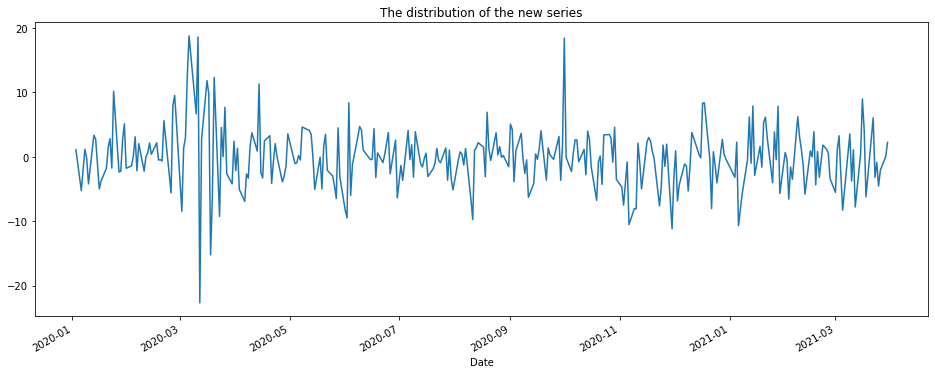

In [150]:
#plot the new serie
plt.figure(figsize=(16,6))
plt.title("The distribution of the new series")
df1_russia['diff_1'].plot()

Let's confirm the stationarity by ploting the rolling statistics 

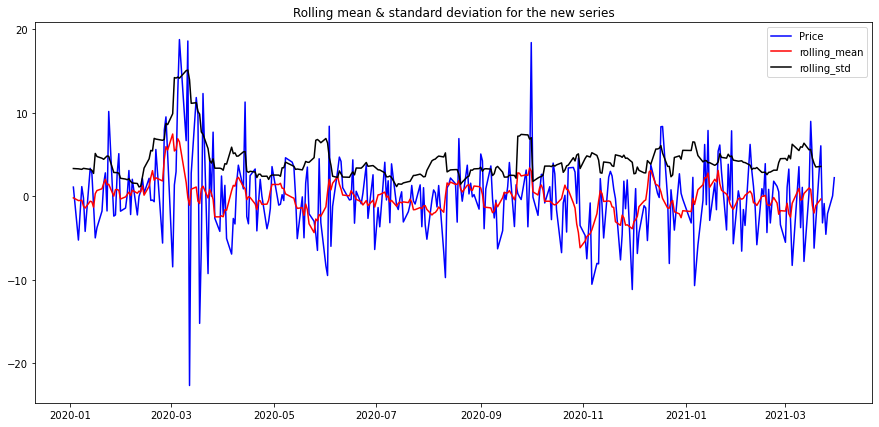

In [151]:
#plot rolling statistics
plt.figure(figsize=(15,7))
orig=plt.plot(df1_russia.diff_1, color='blue',label='Price')
R_mean=plt.plot(df1_russia.diff_1.rolling(7).mean(), color='red',label='rolling_mean')
R_std=plt.plot(df1_russia.diff_1.rolling(7).std(), color='black',label='rolling_std')
plt.legend(loc='best')
plt.title('Rolling mean & standard deviation for the new series')
plt.show(block='False')

## 5. Price Forecasting
Forecasting is the next step where I want to predict the future values the series is going to take.

Time series forecasting allows us to predict future values in a time series given current and past data. Let's split first the dataset.We will use only 2020 data and predict with 2021 Q1 data.

In [152]:
#split the data
np.random.seed(1)
train = df1_russia[df1_russia.index < pd.to_datetime('2021-01-01', format="%Y-%m-%d")]
#train=train.dropna()
test=df1_russia[df1_russia.index >= pd.to_datetime('2021-01-01', format="%Y-%m-%d")]
test=test.dropna()

In [153]:
train.head()

,Price,Volume,Change %,diff_1
Date,,,,
2020-12-30,271.65,31.53,-0.0013,-0.35
2020-12-29,272.00,39.02,-0.0098,0.35
2020-12-28,274.70,39.04,0.0150,2.70
2020-12-25,270.64,11.99,0.0049,-4.06
2020-12-24,269.32,42.61,-0.0029,-1.32


In [154]:
test=df1_russia[df1_russia.index >= pd.to_datetime('2021-01-01', format="%Y-%m-%d")]
test=test.dropna()

In [155]:
test.head()

,Price,Volume,Change %,diff_1
Date,,,,
2021-03-30,293.25,38.81,-0.0002,2.23
2021-03-29,293.30,43.68,0.0071,0.05
2021-03-26,291.22,56.07,0.0159,-2.08
2021-03-25,286.66,35.22,0.0030,-4.56
2021-03-24,285.79,46.41,0.0113,-0.87


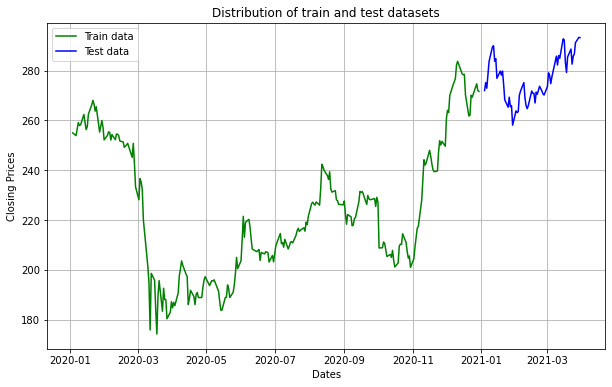

In [156]:
#plot the distribution of train and test
plt.figure(figsize=(10,6))
plt.grid(True)
plt.xlabel('Dates')
plt.ylabel('Closing Prices')
plt.plot(train.Price, 'green', label='Train data')
plt.plot(test.Price, 'blue', label='Test data')
plt.title('Distribution of train and test datasets')
plt.legend()

* ### 4.1 ARIMA algorithm    
Here, I will use first the ARIMA method to forecast the stock prices.
ARIMA, stands for **‘AutoRegressive Integrated Moving Average’**, is a forecasting algorithm based on the idea that the information in the past values of the time series can alone be used to predict the future values.
An ARIMA model is characterized by 3 terms: p, d, q where,

* **p** is the order of the AR term. It refers to the number of lags of Y to be used as predictors. 

* **q** is the order of the MA term. It refers to the number of lagged forecast errors that should go into the ARIMA Model.

* **d** is the number of differencing required to make the time series stationary   

First, the series should be stationary as I did in the previous section. In fact, term ‘Auto Regressive’ in ARIMA means it is a linear regression model that uses its own lags as predictors. As known, linear regression models works better when the predictors are not correlated and are independent of each other.

* In the previous section, i used the order of differencing as 1. Now, let's difference more the series and see how the autocorrelation plot looks like.

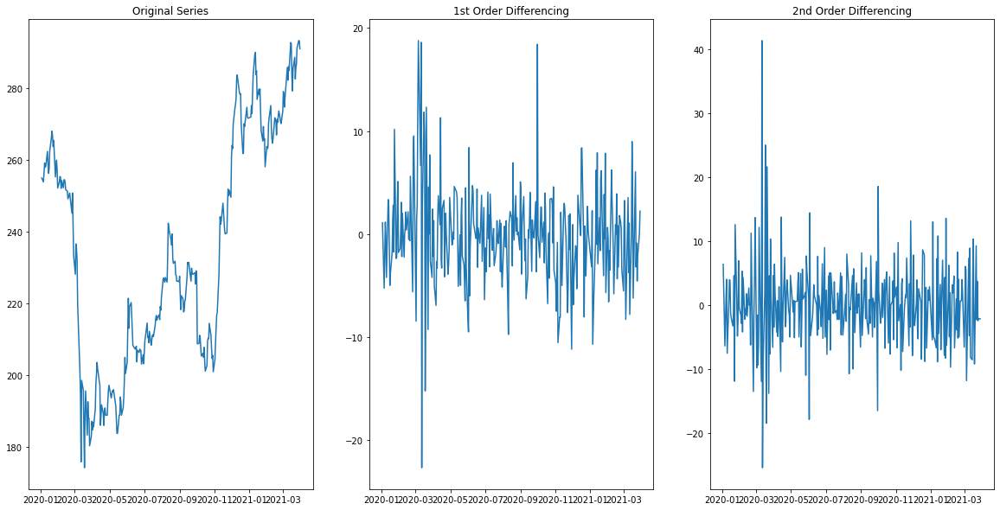

In [157]:
# Original Series
fig, axes = plt.subplots(1, 3, sharex=True)
axes[0].plot(df1_russia.Price)
axes[0].set_title('Original Series')
#plot_acf(df1_russia.Price, ax=axes[0, 1])

# 1st Differencing
axes[1].plot(df1_russia.Price.diff())
axes[1].set_title('1st Order Differencing')
#plot_acf(df1_russia.Price.diff().dropna(), ax=axes[1, 1])

# 2nd Differencing
axes[2].plot(df1_russia.Price.diff().diff())
axes[2].set_title('2nd Order Differencing')
#plot_acf(df1_russia.Price.diff().diff().dropna(), ax=axes[2, 1])

plt.show()

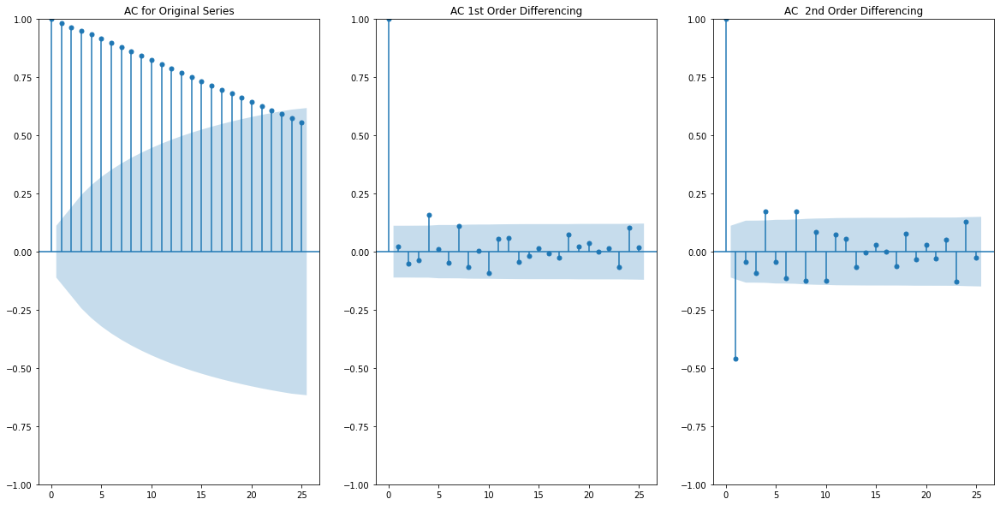

In [158]:
#Plot autocorrelation
# Original Series
fig, axes = plt.subplots(1, 3, sharex=True)
plot_acf(df1_russia.Price, ax=axes[0])
axes[0].set_title('AC for Original Series')

# 1st Differencing
plot_acf(df1_russia.Price.diff().dropna(), ax=axes[1])
axes[1].set_title('AC 1st Order Differencing')

# 2nd Differencing
plot_acf(df1_russia.Price.diff().diff().dropna(), ax=axes[2])
axes[2].set_title('AC  2nd Order Differencing')

plt.show()

For the above series, the time series reaches stationarity with two orders of differencing. But on looking at the autocorrelation plot for the 2nd differencing the lag start going into the far negative zone, which indicates that the series might start being over differenced.
Great, so I am going to tentatively fix the order of differencing as 1. 
##### So,  d=1
Let's plot the partial autocorrelation to determine p.

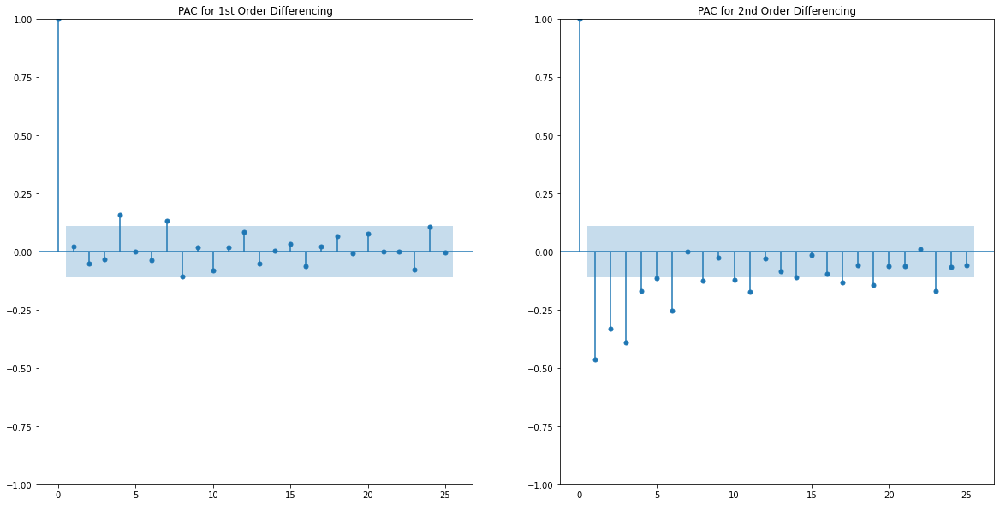

In [159]:
#Plot partial autocorrelation
fig, axes = plt.subplots(1, 2, sharex=True)
# 1st Differencing
plot_pacf(df1_russia.Price.diff().dropna(), ax=axes[0])
axes[0].set_title('PAC for 1st Order Differencing')

# 2nd Differencing
plot_pacf(df1_russia.Price.diff().diff().dropna(), ax=axes[1])
axes[1].set_title('PAC for 2nd Order Differencing')

plt.show()

We determine *p* based on the most significant lag in the partial autocorrelation plot. In both the plots, we see the 1st lag is the most significant. Thus, we consider “p” to be 1, **so p=1**.
Finally, *q* can be estimated similarly by looking at the ACF plot instead of the PACF plot. Looking at the number of lags crossing the threshold, we can determine how much of the past would be significant enough to consider for the future. The ones with high correlation contribute more and would be enough to predict future values. 
so, from the plots of AC above, the moving average MA parameter can be set to 2. So **q=2**
Thus, our final ARIMA model can be defined as **ARIMA(p=1, d=1,q= 2).** This is statistically.

Now, we’ll utilize Auto ARIMA to find the best parameters.  
##### Auto ARIMA: Automatically discover the optimal order for an ARIMA model.
The auto_arima function returns a fitted ARIMA model after determining the most optimal parameters for an ARIMA model.

Performing stepwise search to minimize aic
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=inf, Time=1.13 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=1851.634, Time=0.05 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=1853.469, Time=0.06 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=1853.451, Time=0.06 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=1849.819, Time=0.02 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=1855.348, Time=0.26 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 2.188 seconds
                               SARIMAX Results                                
Dep. Variable:                      y   No. Observations:                  311
Model:               SARIMAX(0, 1, 0)   Log Likelihood                -923.909
Date:                Thu, 26 May 2022   AIC                           1849.819
Time:                        18:06:28   BIC                           1853.555
Sample:                             0   HQIC                          1851.313
               

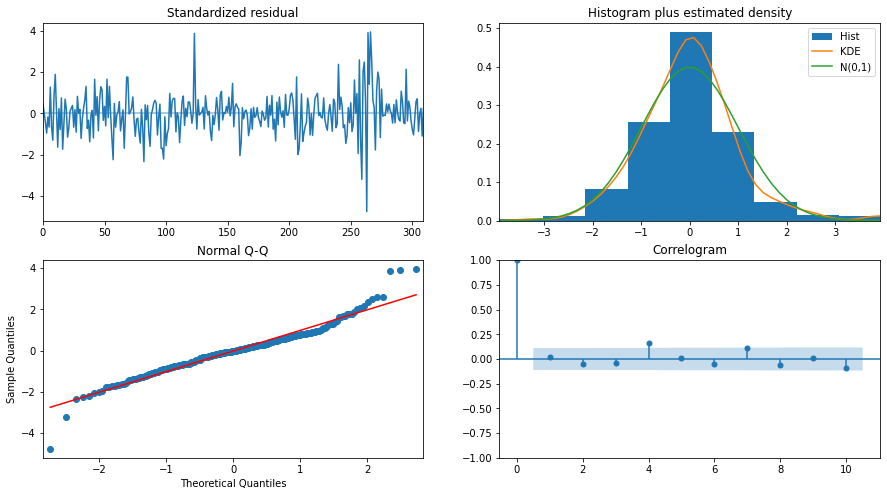

In [160]:
model_autoARIMA = auto_arima(df1_russia.Price, 
                      trace=True,
                      suppress_warnings=True)
print(model_autoARIMA.summary())
model_autoARIMA.plot_diagnostics(figsize=(15,8))
plt.show()

#### Interpretations:
1. Standardiez residual plot: The residual errors appear to have a uniform variance and fluctuate around a mean of zero.
2. Normal Q-Q plot: The red line should be perfectly aligned with all of the dots. Any significant deviations would indicate a skewed distribution.
3. The density plot:  The density plot on the top right suggests a normal distribution with a mean of zero.
4. The residual errors are not autocorrelated, as shown by the Correlogram, also known as the ACF plot. Spikes are close to zero which is evidence against autocorrelation. So stock prices aren't highly correlated.     

So, the best model is ARIMA (p=0,d=1,q=0). Let's fit the model

In [161]:
# Build Model
model =  statsmodels.tsa.arima.model.ARIMA(train.Price, order=(0,1,0))  
model = model.fit()  
print(model.summary())

                               SARIMAX Results                                
Dep. Variable:                  Price   No. Observations:                  250
Model:                 ARIMA(0, 1, 0)   Log Likelihood                -747.842
Date:                Thu, 26 May 2022   AIC                           1497.685
Time:                        18:06:42   BIC                           1501.202
Sample:                             0   HQIC                          1499.101
                                - 250                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2        23.7810      1.267     18.772      0.000      21.298      26.264
Ljung-Box (L1) (Q):                   0.42   Jarque-Bera (JB):               142.35
Prob(Q):                              0.52   Pr

In [169]:
train.shape

(250, 4)

we can plot the forecast that the model fits for the 50 samples.

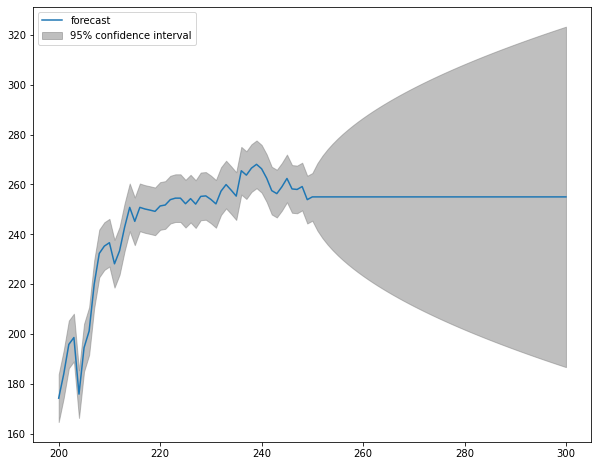

In [196]:
fig, ax = plt.subplots(figsize=(10, 8))
fig = plot_predict(model, start=200, end= 300, ax=ax)
legend = ax.legend(loc="upper left")

Let's test also the ARIMA model with the previous founded paramethers, and see if AIC will be minimized or not.

In [177]:
# Build Model
model1 = statsmodels.tsa.arima.model.ARIMA(train.Price, order=(1,1,2))
model1 = model1.fit()  
print(model1.summary())

                               SARIMAX Results                                
Dep. Variable:                  Price   No. Observations:                  250
Model:                 ARIMA(1, 1, 2)   Log Likelihood                -747.360
Date:                Thu, 26 May 2022   AIC                           1502.721
Time:                        18:17:29   BIC                           1516.791
Sample:                             0   HQIC                          1508.384
                                - 250                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.0038      0.982      0.004      0.997      -1.920       1.928
ma.L1          0.0392      0.990      0.040      0.968      -1.902       1.980
ma.L2         -0.0398      0.069     -0.581      0.5

We can see clearly that AIC  (The Akaike Information Critera) for paramethers founded by autoarima is lower than thoses viewd with statistical study. As the goal is that AIC must be as low as possible, so we'll conserve the autoarima paramethers.    
At the meantime, we can plot the forecast that the model fits for the 50 samples.

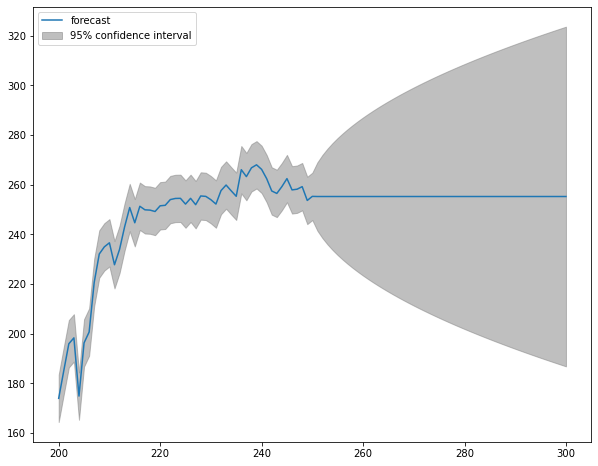

In [197]:
fig, ax = plt.subplots(figsize=(10, 8))
fig = plot_predict(model1, start=200, end= 300, ax=ax)
legend = ax.legend(loc="upper left")

From the plot above, the actual observed values with the arima model lie within the 95% confidence band. That seems fine.

#### Evaluate the ARIMA model

Typically, MAPE is used for evaluation and comparision because it's a percentage errors that vary between 0 and 1. That way, we can judge how good is the forecast irrespective of the scale of the series.
So, with a MAPE of around 8.4% from the results below, the model is 91.6% accurate in predicting the next 60 observations.

In [236]:
mse = mean_squared_error(test.Price, fc)
print('MSE: '+str(mse))
mae = mean_absolute_error(test.Price, fc)
print('MAE: '+str(mae))
rmse = math.sqrt(mean_squared_error(test.Price, fc))
print('RMSE: '+str(rmse))
mape = np.mean(np.abs(fc - test.Price)/np.abs(test.Price))
print('MAPE: '+str(mape))

MSE: 617.9838424873054 
 MAE: 23.34528809846608 
 RMSE: 24.85928081194839 
 MAPE: 0.08351861442771477


* ### 4.2 ARIMAX model    

ARIMAX is An Autoregressive Integrated Moving Average with Explanatory Variable (ARIMAX) model. ARIMAX is related to the ARIMA technique but, while ARIMA is suitable for datasets that are univariate. ARIMAX is suitable for analysis where there are additional explanatory variables (multivariate) in categorical and/or numeric format.
Considering we need to foretell the stock price for a day, we cannot use the feature values of the same day since they will be unavailable at actual inference time.      
So, I ought external characteristics or internal feature engineering to USE arimax and then to improve the model.     
For that, I add some essential features like lag values of available numeric features widely accepted for time series problems, using the mean and the standard deviation of their lagged values. The following three sets of lagged values are used: one previous day, one looking back seven days and another looking back 30 days as a proxy for last week and last month metrics.


In [181]:
df_copy=df1_russia.copy()

In [182]:
#USE THE DATAFRAME BEFORE REMOVING lOW HIGH AND OPEN FEATURES
df1_russia=df.copy()
df1_russia.drop(['month','year'],axis=1,inplace=True)

In [183]:
df1_russia.reset_index(inplace=True)
lag_features = ["Volume", "Change %",'Low','High','Open']
window1 = 3
window2 = 7
window3 = 30

df_rolled_3d = df1_russia[lag_features].rolling(window=window1, min_periods=0)
df_rolled_7d = df1_russia[lag_features].rolling(window=window2, min_periods=0)
df_rolled_30d = df1_russia[lag_features].rolling(window=window3, min_periods=0)

df_mean_3d = df_rolled_3d.mean().shift(1).reset_index()
df_mean_7d = df_rolled_7d.mean().shift(1).reset_index()
df_mean_30d = df_rolled_30d.mean().shift(1).reset_index()

df_std_3d = df_rolled_3d.std().shift(1).reset_index()
df_std_7d = df_rolled_7d.std().shift(1).reset_index()
df_std_30d = df_rolled_30d.std().shift(1).reset_index()

for feature in lag_features:
    df1_russia[f"{feature}_mean_lag{window1}"] = df_mean_3d[feature]
    df1_russia[f"{feature}_mean_lag{window2}"] = df_mean_7d[feature]
    df1_russia[f"{feature}_mean_lag{window3}"] = df_mean_30d[feature]
    
    df1_russia[f"{feature}_std_lag{window1}"] = df_std_3d[feature]
    df1_russia[f"{feature}_std_lag{window2}"] = df_std_7d[feature]
    df1_russia[f"{feature}_std_lag{window3}"] = df_std_30d[feature]
    
#drop null variables
df1_russia.fillna(df1_russia.mean(), inplace=True)

df1_russia.set_index("Date", drop=True, inplace=True)
df1_russia.head()

,Price,Open,High,Low,Volume,Change %,Volume_mean_lag3,Volume_mean_lag7,Volume_mean_lag30,Volume_std_lag3,...,High_mean_lag30,High_std_lag3,High_std_lag7,High_std_lag30,Open_mean_lag3,Open_mean_lag7,Open_mean_lag30,Open_std_lag3,Open_std_lag7,Open_std_lag30
Date,,,,,,,,,,,,,,,,,,,,,
2021-03-31,291.02,294.00,294.42,290.26,47.00,-0.0076,73.232253,73.319982,73.889934,17.822796,...,238.655843,2.792781,4.401125,9.682551,234.476602,234.701885,235.750501,3.152489,4.713972,9.897364
2021-03-30,293.25,294.86,295.72,291.50,38.81,-0.0002,47.000000,47.000000,47.000000,17.822796,...,294.420000,2.792781,4.401125,9.682551,294.000000,294.000000,294.000000,3.152489,4.713972,9.897364
2021-03-29,293.30,289.72,294.09,289.26,43.68,0.0071,42.905000,42.905000,42.905000,5.791205,...,295.070000,0.919239,0.919239,0.919239,294.430000,294.430000,294.430000,0.608112,0.608112,0.608112
2021-03-26,291.22,288.63,292.75,288.32,56.07,0.0159,43.163333,43.163333,43.163333,4.119373,...,294.743333,0.861762,0.861762,0.861762,292.860000,292.860000,292.860000,2.753107,2.753107,2.753107
2021-03-25,286.66,286.50,287.03,283.85,35.22,0.0030,46.186667,46.390000,46.390000,8.898844,...,294.245000,1.487358,1.220014,1.220014,291.070000,291.802500,291.802500,3.327176,3.086469,3.086469


In [184]:
#attach DateTime features like: week, day, month, day_of_week
df1_russia["month"] = [d.month for d in df1_russia.index]
df1_russia["week"] = [d.week for d in df1_russia.index]
df1_russia["day"] = [d.day for d in df1_russia.index]
df1_russia["day_of_week"] = [d.dayofweek for d in df1_russia.index]

In [185]:
# Visualize the new added features
df1_russia.loc[:,'month':'day_of_week'].head(7)

,month,week,day,day_of_week
Date,,,,
2021-03-31,3,13,31,2
2021-03-30,3,13,30,1
2021-03-29,3,13,29,0
2021-03-26,3,12,26,4
2021-03-25,3,12,25,3
2021-03-24,3,12,24,2
2021-03-23,3,12,23,1


In [186]:
#select exogenous features
exogenous_features=df1_russia.columns[6:].values.tolist()
exogenous_features

['Volume_mean_lag3',
 'Volume_mean_lag7',
 'Volume_mean_lag30',
 'Volume_std_lag3',
 'Volume_std_lag7',
 'Volume_std_lag30',
 'Change %_mean_lag3',
 'Change %_mean_lag7',
 'Change %_mean_lag30',
 'Change %_std_lag3',
 'Change %_std_lag7',
 'Change %_std_lag30',
 'Low_mean_lag3',
 'Low_mean_lag7',
 'Low_mean_lag30',
 'Low_std_lag3',
 'Low_std_lag7',
 'Low_std_lag30',
 'High_mean_lag3',
 'High_mean_lag7',
 'High_mean_lag30',
 'High_std_lag3',
 'High_std_lag7',
 'High_std_lag30',
 'Open_mean_lag3',
 'Open_mean_lag7',
 'Open_mean_lag30',
 'Open_std_lag3',
 'Open_std_lag7',
 'Open_std_lag30',
 'month',
 'week',
 'day',
 'day_of_week']

In [187]:
#split data into train and test
np.random.seed(1)
train_ARMX = df1_russia[df1_russia.index < pd.to_datetime('2021-01-01', format="%Y-%m-%d")]
train_ARMX=train_ARMX.dropna()
test_ARMX=df1_russia[df1_russia.index >= pd.to_datetime('2021-01-01', format="%Y-%m-%d")]
test_ARMX=test_ARMX.dropna()

In [188]:
print('shape of train set: ',train_ARMX.shape)
print('shape of test set: ',test_ARMX.shape)

shape of train set:  (250, 40)
shape of test set:  (61, 40)


In [189]:
# create the ARIMAX model
model_ARMX = auto_arima(train_ARMX.Price, exogenous=train_ARMX[exogenous_features], trace=True, error_action="ignore", suppress_warnings=True)

Performing stepwise search to minimize aic
 ARIMA(2,0,2)(0,0,0)[0] intercept   : AIC=1038.758, Time=3.61 sec
 ARIMA(0,0,0)(0,0,0)[0] intercept   : AIC=1095.558, Time=0.62 sec
 ARIMA(1,0,0)(0,0,0)[0] intercept   : AIC=1097.556, Time=1.30 sec
 ARIMA(0,0,1)(0,0,0)[0] intercept   : AIC=1097.825, Time=0.95 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=1093.696, Time=2.57 sec
 ARIMA(1,0,2)(0,0,0)[0] intercept   : AIC=1067.647, Time=2.79 sec
 ARIMA(2,0,1)(0,0,0)[0] intercept   : AIC=1052.859, Time=2.72 sec
 ARIMA(3,0,2)(0,0,0)[0] intercept   : AIC=1036.063, Time=3.02 sec
 ARIMA(3,0,1)(0,0,0)[0] intercept   : AIC=1048.566, Time=2.92 sec
 ARIMA(4,0,2)(0,0,0)[0] intercept   : AIC=1036.164, Time=3.31 sec
 ARIMA(3,0,3)(0,0,0)[0] intercept   : AIC=1034.799, Time=3.35 sec
 ARIMA(2,0,3)(0,0,0)[0] intercept   : AIC=1032.802, Time=2.98 sec
 ARIMA(1,0,3)(0,0,0)[0] intercept   : AIC=1067.218, Time=2.99 sec
 ARIMA(2,0,4)(0,0,0)[0] intercept   : AIC=1033.589, Time=3.69 sec
 ARIMA(1,0,4)(0,0,0)[0] intercept

In [190]:
model_ARMX.fit(train_ARMX.Price, exogenous=train_ARMX[exogenous_features])

ARIMA(order=(2, 0, 3), scoring_args={}, suppress_warnings=True,
      with_intercept=False)

In [191]:
#get predicted prices
forecast_ARMX = model_ARMX.predict(n_periods=len(test_ARMX), exogenous=test_ARMX[exogenous_features])
test_ARMX["Forecast_ARIMAX"] = forecast_ARMX

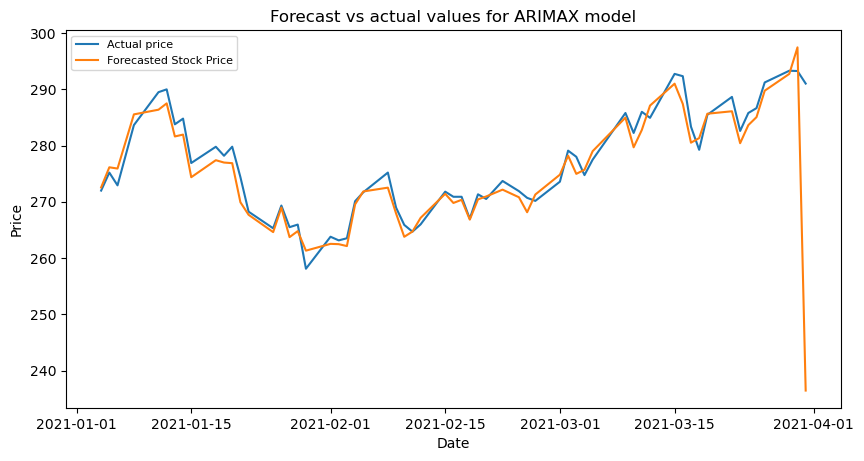

In [192]:
#Plot predicted vs actual prices
plt.figure(figsize=(10,5), dpi=100)
plt.plot(test_ARMX.Price, label='Actual price')
plt.plot(test_ARMX.Forecast_ARIMAX, label='Forecasted Stock Price')
plt.title('Forecast vs actual values for ARIMAX model')
plt.xlabel('Date')
plt.ylabel('Price')
plt.legend(loc='upper left', fontsize=8)
plt.show()

Wow, looks much beter than the Arima model. Let's see the evaluation metrics

In [194]:
test_ARMX.loc[:,['Price','Forecast_ARIMAX']].head()

,Price,Forecast_ARIMAX
Date,,
2021-03-31,291.02,236.460194
2021-03-30,293.25,297.450751
2021-03-29,293.30,292.737867
2021-03-26,291.22,289.751958
2021-03-25,286.66,285.058982


In [195]:
print("RMSE of Auto ARIMAX:", math.sqrt(mean_squared_error(test_ARMX.Price, test_ARMX.Forecast_ARIMAX)))
print("MAE of Auto ARIMAX:", mean_absolute_error(test_ARMX.Price, test_ARMX.Forecast_ARIMAX))
print("MAPE of Auto ARIMAX:", np.mean(np.abs(test_ARMX.Forecast_ARIMAX- test_ARMX.Price)/np.abs(test_ARMX.Price)))

RMSE of Auto ARIMAX: 7.270852460000771
MAE of Auto ARIMAX: 2.567253885514804
MAPE of Auto ARIMAX: 0.009074110787921856


So, with a MAPE **Mean Absolute Percentage Error** of around 0.009, the model is 99.1% accurate in predicting the next 61 observations.

* ### 4.3 LSTM model    

Long short-term memory (LSTM) is an artificial recurrent neural network (RNN) architecture used in the field of deep learning. Unlike standard feedforward neural networks, LSTM has feedback connections. It can be used with single data points such as image and entire sequences of data such as speech.    
I'm going to build a multi-layer LSTM recurrent neural network to predict the last value of a sequence of values

In [237]:
train_lstm=train_ARMX.copy()
test_lstm=test_ARMX.copy()

#### It’s good to normalize the data before model fitting. This will improve the performance.

In [238]:
def build_train_test_normalize(time_steps,for_periods):
    '''
    input: 
      time_steps and period to predict
    output:
      X_train, y_train: data from 2013/1/1-2018/12/31
      X_test:  data from 2019 -
      sc:      insantiated MinMaxScaler object fit to the training data
    '''
    np.random.seed(1)
    # create training and test set
    ts_train = train_lstm.iloc[:,0:1].values
    ts_test  = test_lstm.iloc[:,0:1].values
    ts_train_len = len(ts_train)
    ts_test_len = len(ts_test)

    # scale the data
    from sklearn.preprocessing import MinMaxScaler
    sc = MinMaxScaler(feature_range=(0,1))
    ts_train_scaled = sc.fit_transform(ts_train)

    # create training data of s samples and t time steps
    X_train = []
    y_train = []
    y_train_stacked = []
    for i in range(time_steps,ts_train_len-1): 
        X_train.append(ts_train_scaled[i-time_steps:i,0])
        y_train.append(ts_train_scaled[i:i+for_periods,0])
    X_train, y_train = np.array(X_train), np.array(y_train)

    # Reshaping X_train for efficient modelling
    X_train = np.reshape(X_train, (X_train.shape[0],X_train.shape[1],1))

    inputs = pd.concat((train_lstm.iloc[:,0:1], test_lstm.iloc[:,0:1]),axis=0).values
    inputs = inputs[len(inputs)-len(ts_test) - time_steps:]
    inputs = inputs.reshape(-1,1)
    inputs  = sc.transform(inputs)

    # Preparing X_test
    X_test = []
    for i in range(time_steps,ts_test_len+time_steps-for_periods):
        X_test.append(inputs[i-time_steps:i,0])
        
    X_test = np.array(X_test)
    X_test = np.reshape(X_test, (X_test.shape[0],X_test.shape[1],1))

    return X_train, y_train , X_test, sc

We have reshaped the data into the following format (values, time-steps, dimensional).    
Now, it’s time to build the model. We will build the LSTM with 100 neurons and 5 hidden layers. Finally, we will assign 1 neuron in the output layer for predicting the normalized stock price. We will use the MSE loss function and the Adam stochastic gradient descent optimizer.

In [239]:
#choose a time step of 30 days and a prediod of 1 predictions
X_train, y_train, X_test, sc = build_train_test_normalize(30,1)
X_train.shape[0],X_train.shape[1]

(219, 30)

In [240]:
print("There are " + str(X_train.shape[0]) + " samples in the training data")
print("There are " + str(X_test.shape[0]) + " samples in the test data")

There are 219 samples in the training data
There are 59 samples in the test data


In [241]:
#define plot function 
def actual_vs_pred_plot(preds, data=test_lstm, plot=True):
    '''
    input: predictions from the RNN model
    output: mean square error value and the plot of real vs predicted values
    '''
    #define a new dataframe with price and prediction columns
    
    actual_pred = pd.DataFrame(columns = ['Price', 'prediction'])
    actual_pred['Price'] = data.iloc[:,0:1].iloc[0:len(preds)]
    actual_pred['prediction'] = preds[:,0]
    MAPE=np.mean(np.abs(np.array(actual_pred['prediction'])- np.array(actual_pred['Price']))/np.abs(np.array(actual_pred['Price'])))
    RMSE=math.sqrt(mean_squared_error(np.array(actual_pred['Price']), np.array(actual_pred['prediction'])))
    if plot==True:
        actual_pred.plot()
        plt.title('Stock Price Prediction')
        plt.xlabel('Time')
        plt.ylabel('Stock Price')
        plt.legend(loc='upper left', fontsize=8)
        plt.show()
    return MAPE,RMSE

In [242]:
#create a LSTM model
def LSTM_model_fc(X_train, y_train, X_test, sc, epoch=100, batch_size=32,optimizer='Adam',units=100):
    np.random.seed(1)
    # The LSTM architecture
    regressor = Sequential()
    # Adding first LSTM layer and some dropout Dropout regularisation
    regressor.add(LSTM(units=units, return_sequences=True, input_shape = (X_train.shape[1], 1)))
    regressor.add(Dropout(0.2))

    # Adding second LSTM layer and some dropout Dropout regularisation
    regressor.add(LSTM(units=units, return_sequences=True))
    regressor.add(Dropout(0.2))

    # Adding third LSTM layer and some dropout Dropout regularisation
    regressor.add(LSTM(units=units, return_sequences=True))
    regressor.add(Dropout(0.2))

    # Adding fourth LSTM layer and some dropout Dropout regularisation
    regressor.add(LSTM(units=units, return_sequences=True))
    regressor.add(Dropout(0.2))

    # Adding fifth LSTM layer and some dropout Dropout regularisation
    regressor.add(LSTM(units=units))
    regressor.add(Dropout(0.2))

    # Adding the Output Layer
    regressor.add(Dense(units=1))

    # Compiling the RNN
    # Because we're doing regression hence mean_squared_error
    regressor.compile(optimizer=optimizer, loss = 'mean_squared_error', metrics=['accuracy'])

    # Fitting the RNN to the Training set
    regressor.fit(X_train, y_train, epochs = epoch, batch_size = batch_size)
    
    LSTM_prediction = regressor.predict(X_test)
    LSTM_prediction = sc.inverse_transform(LSTM_prediction)

    return regressor, LSTM_prediction

#### LSTM before optimizing hyperparams

In [245]:
np.random.seed(1)
#choose a time step of 30 days and a prediod of 1 predictions
X_train, y_train, X_test, sc = build_train_test_normalize(30,1)
X_train.shape[0],X_train.shape[1]
LSTM_model_before, LSTM_prediction_before = LSTM_model_fc(X_train, y_train, X_test, sc)

Epoch 1/100
7/7 [==============================] - 12s 109ms/step - loss: 0.0855 - accuracy: 0.0046
Epoch 2/100
7/7 [==============================] - 1s 109ms/step - loss: 0.0346 - accuracy: 0.0046
Epoch 3/100
7/7 [==============================] - 1s 109ms/step - loss: 0.0308 - accuracy: 0.0046
Epoch 4/100
7/7 [==============================] - 1s 108ms/step - loss: 0.0293 - accuracy: 0.0046
Epoch 5/100
7/7 [==============================] - 1s 108ms/step - loss: 0.0251 - accuracy: 0.0046
Epoch 6/100
7/7 [==============================] - 1s 107ms/step - loss: 0.0223 - accuracy: 0.0046
Epoch 7/100
7/7 [==============================] - 1s 109ms/step - loss: 0.0172 - accuracy: 0.0046
Epoch 8/100
7/7 [==============================] - 1s 108ms/step - loss: 0.0168 - accuracy: 0.0046
Epoch 9/100
7/7 [==============================] - 1s 106ms/step - loss: 0.0159 - accuracy: 0.0046
Epoch 10/100
7/7 [==============================] - 1s 109ms/step - loss: 0.0173 - accuracy: 0.0046
Epoch 11

7/7 [==============================] - 1s 106ms/step - loss: 0.0054 - accuracy: 0.0046
Epoch 84/100
7/7 [==============================] - 1s 105ms/step - loss: 0.0062 - accuracy: 0.0046
Epoch 85/100
7/7 [==============================] - 1s 107ms/step - loss: 0.0055 - accuracy: 0.0046
Epoch 86/100
7/7 [==============================] - 1s 105ms/step - loss: 0.0056 - accuracy: 0.0046
Epoch 87/100
7/7 [==============================] - 1s 105ms/step - loss: 0.0049 - accuracy: 0.0046
Epoch 88/100
7/7 [==============================] - 1s 105ms/step - loss: 0.0054 - accuracy: 0.0046
Epoch 89/100
7/7 [==============================] - 1s 106ms/step - loss: 0.0049 - accuracy: 0.0046
Epoch 90/100
7/7 [==============================] - 1s 106ms/step - loss: 0.0047 - accuracy: 0.0046
Epoch 91/100
7/7 [==============================] - 1s 106ms/step - loss: 0.0051 - accuracy: 0.0046
Epoch 92/100
7/7 [==============================] - 1s 107ms/step - loss: 0.0048 - accuracy: 0.0046
Epoch 93/100


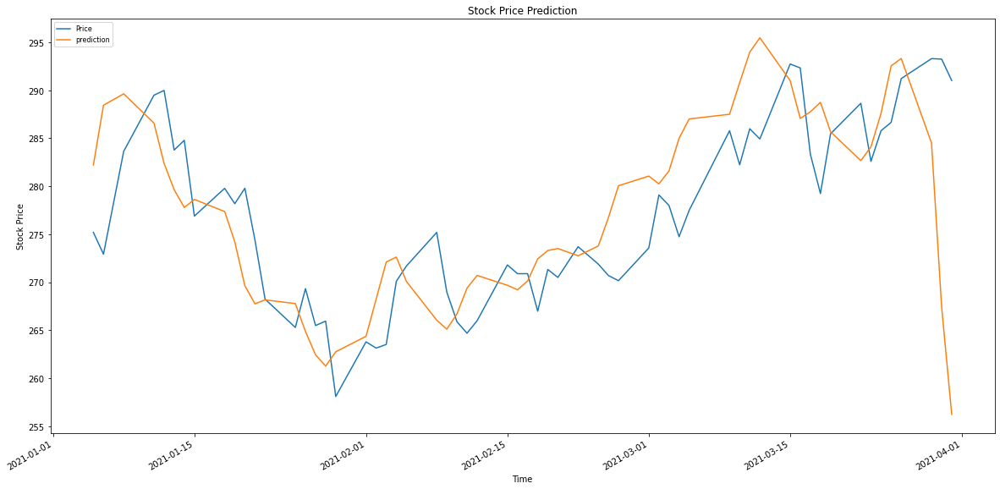

(0.020185855719037457, 8.000344627064589)

In [246]:
#Plot predictions
actual_vs_pred_plot(LSTM_prediction_before)   

In [247]:
print("The results of test data are: MAPE=0.020185855719037457 and RMSE=8.000344627064589")

The results of test data are: MAPE=0.020185855719037457 and RMSE=8.000344627064589


#### LSTM after optimizing hyperparams

In [141]:
'''steps_list=[20,40,60]
optimizers_list=['Adam','SGD','adagrad', 'adadelta']
batch_size_list=[16,32]
epoch_list=[10,100,200]
error_rate = {'time_step': [], 'optimizer': [], 'epoch': [],'batch_size': [],'RMSE': [], 'MAPE': []}
start = time.time()
for step in tqdm_notebook(steps_list):    
        print('Start of step :',step)
        print("*"*120)
        for optimizer in optimizers_list:
            
            for epoch in epoch_list:
                
                for batch in batch_size_list:
                    
                    print('\t Start of optimizer:',optimizer,'\t epoch:',epoch,'\t batch_size;',batch)
                    print(">"*100)
                    #get split data
                    X_train, y_train, X_test, sc = build_train_test_normalize(step,1)

                    #train model
                    np.random.seed(1)
                    LSTM_model, LSTM_prediction = LSTM_model_fc(X_train, y_train, X_test, sc, epoch, batch ,optimizer)
                    
                    #calculate errors
                    MAPE,RMSE=actual_vs_pred_plot(LSTM_prediction, plot=False)
                    
                    #collect results
                    error_rate['time_step'].append(step)
                    error_rate['optimizer'].append(optimizer)
                    error_rate['epoch'].append(epoch)
                    error_rate['batch_size'].append(batch)
                    error_rate['RMSE'].append(RMSE)
                    error_rate['MAPE'].append(MAPE)

#store results in result_df dataframe                
result_df = pd.DataFrame(error_rate)
end = time.time()
print("Minutes taken = " + str((end-start)/60.0))'''

  0%|          | 0/3 [00:00<?, ?it/s]

Start of step : 20
************************************************************************************************************************
	 Start of optimizer: Adam 	 epoch: 10 	 batch_size; 16
>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>
Epoch 1/10
15/15 [==============================] - 22s 93ms/step - loss: 0.0788 - accuracy: 0.0044
Epoch 2/10
15/15 [==============================] - 1s 73ms/step - loss: 0.0306 - accuracy: 0.0044
Epoch 3/10
15/15 [==============================] - 1s 74ms/step - loss: 0.0268 - accuracy: 0.0044
Epoch 4/10
15/15 [==============================] - 1s 74ms/step - loss: 0.0247 - accuracy: 0.0044
Epoch 5/10
15/15 [==============================] - 1s 74ms/step - loss: 0.0235 - accuracy: 0.0044
Epoch 6/10
15/15 [==============================] - 1s 74ms/step - loss: 0.0227 - accuracy: 0.0044
Epoch 7/10
15/15 [==============================] - 1s 74ms/step - loss: 0.0194 - accuracy: 0.0044
Epoch 8/1

8/8 [==============================] - 1s 81ms/step - loss: 0.0110 - accuracy: 0.0044
Epoch 37/100
8/8 [==============================] - 1s 81ms/step - loss: 0.0115 - accuracy: 0.0044
Epoch 38/100
8/8 [==============================] - 1s 81ms/step - loss: 0.0092 - accuracy: 0.0044
Epoch 39/100
8/8 [==============================] - 1s 81ms/step - loss: 0.0090 - accuracy: 0.0044
Epoch 40/100
8/8 [==============================] - 1s 80ms/step - loss: 0.0102 - accuracy: 0.0044
Epoch 41/100
8/8 [==============================] - 1s 80ms/step - loss: 0.0093 - accuracy: 0.0044
Epoch 42/100
8/8 [==============================] - 1s 80ms/step - loss: 0.0099 - accuracy: 0.0044
Epoch 43/100
8/8 [==============================] - 1s 81ms/step - loss: 0.0084 - accuracy: 0.0044
Epoch 44/100
8/8 [==============================] - 1s 82ms/step - loss: 0.0079 - accuracy: 0.0044
Epoch 45/100
8/8 [==============================] - 1s 81ms/step - loss: 0.0079 - accuracy: 0.0044
Epoch 46/100
8/8 [=====

15/15 [==============================] - 1s 73ms/step - loss: 0.0120 - accuracy: 0.0044
Epoch 18/200
15/15 [==============================] - 1s 72ms/step - loss: 0.0108 - accuracy: 0.0044
Epoch 19/200
15/15 [==============================] - 1s 73ms/step - loss: 0.0103 - accuracy: 0.0044
Epoch 20/200
15/15 [==============================] - 1s 74ms/step - loss: 0.0107 - accuracy: 0.0044
Epoch 21/200
15/15 [==============================] - 1s 74ms/step - loss: 0.0103 - accuracy: 0.0044
Epoch 22/200
15/15 [==============================] - 1s 75ms/step - loss: 0.0101 - accuracy: 0.0044
Epoch 23/200
15/15 [==============================] - 1s 78ms/step - loss: 0.0085 - accuracy: 0.0044
Epoch 24/200
15/15 [==============================] - 1s 74ms/step - loss: 0.0098 - accuracy: 0.0044
Epoch 25/200
15/15 [==============================] - 1s 72ms/step - loss: 0.0088 - accuracy: 0.0044
Epoch 26/200
15/15 [==============================] - 1s 73ms/step - loss: 0.0109 - accuracy: 0.0044
Epo

15/15 [==============================] - 1s 77ms/step - loss: 0.0030 - accuracy: 0.0044
Epoch 179/200
15/15 [==============================] - 3s 177ms/step - loss: 0.0038 - accuracy: 0.0044
Epoch 180/200
15/15 [==============================] - 3s 208ms/step - loss: 0.0031 - accuracy: 0.0044
Epoch 181/200
15/15 [==============================] - 2s 101ms/step - loss: 0.0033 - accuracy: 0.0044: 0s - loss: 0.0035 - accuracy
Epoch 182/200
15/15 [==============================] - 1s 74ms/step - loss: 0.0030 - accuracy: 0.0044
Epoch 183/200
15/15 [==============================] - 1s 74ms/step - loss: 0.0039 - accuracy: 0.0044
Epoch 184/200
15/15 [==============================] - 1s 72ms/step - loss: 0.0032 - accuracy: 0.0044
Epoch 185/200
15/15 [==============================] - 1s 74ms/step - loss: 0.0033 - accuracy: 0.0044
Epoch 186/200
15/15 [==============================] - 1s 74ms/step - loss: 0.0035 - accuracy: 0.0044
Epoch 187/200
15/15 [==============================] - 1s 100ms

8/8 [==============================] - 1s 79ms/step - loss: 0.0039 - accuracy: 0.0044
Epoch 141/200
8/8 [==============================] - 1s 87ms/step - loss: 0.0034 - accuracy: 0.0044
Epoch 142/200
8/8 [==============================] - 1s 78ms/step - loss: 0.0036 - accuracy: 0.0044
Epoch 143/200
8/8 [==============================] - 1s 78ms/step - loss: 0.0048 - accuracy: 0.0044
Epoch 144/200
8/8 [==============================] - 1s 78ms/step - loss: 0.0048 - accuracy: 0.0044
Epoch 145/200
8/8 [==============================] - 1s 79ms/step - loss: 0.0043 - accuracy: 0.0044
Epoch 146/200
8/8 [==============================] - 1s 83ms/step - loss: 0.0040 - accuracy: 0.0044
Epoch 147/200
8/8 [==============================] - 1s 78ms/step - loss: 0.0039 - accuracy: 0.0044
Epoch 148/200
8/8 [==============================] - 1s 83ms/step - loss: 0.0043 - accuracy: 0.0044ETA: 0s - loss: 0.0031 - accura
Epoch 149/200
8/8 [==============================] - 1s 79ms/step - loss: 0.0037 - 

15/15 [==============================] - 1s 77ms/step - loss: 0.0284 - accuracy: 0.0044
Epoch 78/100
15/15 [==============================] - 1s 70ms/step - loss: 0.0274 - accuracy: 0.0044
Epoch 79/100
15/15 [==============================] - 1s 69ms/step - loss: 0.0284 - accuracy: 0.0044
Epoch 80/100
15/15 [==============================] - 1s 70ms/step - loss: 0.0279 - accuracy: 0.0044
Epoch 81/100
15/15 [==============================] - 1s 70ms/step - loss: 0.0270 - accuracy: 0.0044
Epoch 82/100
15/15 [==============================] - 1s 71ms/step - loss: 0.0270 - accuracy: 0.0044
Epoch 83/100
15/15 [==============================] - 1s 71ms/step - loss: 0.0257 - accuracy: 0.0044
Epoch 84/100
15/15 [==============================] - 1s 70ms/step - loss: 0.0274 - accuracy: 0.0044
Epoch 85/100
15/15 [==============================] - 1s 70ms/step - loss: 0.0261 - accuracy: 0.0044
Epoch 86/100
15/15 [==============================] - 1s 70ms/step - loss: 0.0258 - accuracy: 0.0044
Epo

15/15 [==============================] - 1s 70ms/step - loss: 0.0387 - accuracy: 0.0044
Epoch 38/200
15/15 [==============================] - 1s 69ms/step - loss: 0.0387 - accuracy: 0.0044
Epoch 39/200
15/15 [==============================] - 1s 70ms/step - loss: 0.0403 - accuracy: 0.0044
Epoch 40/200
15/15 [==============================] - 1s 69ms/step - loss: 0.0378 - accuracy: 0.0044
Epoch 41/200
15/15 [==============================] - 1s 70ms/step - loss: 0.0385 - accuracy: 0.0044
Epoch 42/200
15/15 [==============================] - 1s 69ms/step - loss: 0.0391 - accuracy: 0.0044
Epoch 43/200
15/15 [==============================] - 1s 70ms/step - loss: 0.0373 - accuracy: 0.0044
Epoch 44/200
15/15 [==============================] - 2s 106ms/step - loss: 0.0377 - accuracy: 0.0044
Epoch 45/200
15/15 [==============================] - 3s 217ms/step - loss: 0.0377 - accuracy: 0.0044
Epoch 46/200
15/15 [==============================] - 1s 85ms/step - loss: 0.0371 - accuracy: 0.0044
E

15/15 [==============================] - 3s 193ms/step - loss: 0.0253 - accuracy: 0.0044
Epoch 197/200
15/15 [==============================] - 1s 69ms/step - loss: 0.0252 - accuracy: 0.0044
Epoch 198/200
15/15 [==============================] - 1s 71ms/step - loss: 0.0257 - accuracy: 0.0044
Epoch 199/200
15/15 [==============================] - 1s 69ms/step - loss: 0.0255 - accuracy: 0.0044
Epoch 200/200
15/15 [==============================] - 1s 70ms/step - loss: 0.0261 - accuracy: 0.0044
	 Start of optimizer: SGD 	 epoch: 200 	 batch_size; 32
>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>
Epoch 1/200
8/8 [==============================] - 19s 107ms/step - loss: 0.1574 - accuracy: 0.0044
Epoch 2/200
8/8 [==============================] - 1s 78ms/step - loss: 0.0693 - accuracy: 0.0044
Epoch 3/200
8/8 [==============================] - 1s 74ms/step - loss: 0.0510 - accuracy: 0.0044
Epoch 4/200
8/8 [==============================] -

8/8 [==============================] - 1s 81ms/step - loss: 0.0316 - accuracy: 0.0044
Epoch 158/200
8/8 [==============================] - 1s 80ms/step - loss: 0.0314 - accuracy: 0.0044
Epoch 159/200
8/8 [==============================] - 1s 76ms/step - loss: 0.0314 - accuracy: 0.0044
Epoch 160/200
8/8 [==============================] - 1s 82ms/step - loss: 0.0313 - accuracy: 0.0044 0s - loss: 0.0329 - accuracy: 
Epoch 161/200
8/8 [==============================] - 1s 76ms/step - loss: 0.0309 - accuracy: 0.0044
Epoch 162/200
8/8 [==============================] - 2s 237ms/step - loss: 0.0302 - accuracy: 0.0044
Epoch 163/200
8/8 [==============================] - 2s 237ms/step - loss: 0.0296 - accuracy: 0.0044
Epoch 164/200
8/8 [==============================] - 1s 133ms/step - loss: 0.0302 - accuracy: 0.0044
Epoch 165/200
8/8 [==============================] - 1s 81ms/step - loss: 0.0300 - accuracy: 0.0044
Epoch 166/200
8/8 [==============================] - 1s 80ms/step - loss: 0.0298

15/15 [==============================] - 3s 203ms/step - loss: 0.0412 - accuracy: 0.0044
Epoch 95/100
15/15 [==============================] - 1s 77ms/step - loss: 0.0393 - accuracy: 0.0044
Epoch 96/100
15/15 [==============================] - 1s 70ms/step - loss: 0.0401 - accuracy: 0.0044
Epoch 97/100
15/15 [==============================] - 1s 68ms/step - loss: 0.0408 - accuracy: 0.0044
Epoch 98/100
15/15 [==============================] - 1s 68ms/step - loss: 0.0403 - accuracy: 0.0044
Epoch 99/100
15/15 [==============================] - 1s 71ms/step - loss: 0.0392 - accuracy: 0.0044
Epoch 100/100
15/15 [==============================] - 1s 70ms/step - loss: 0.0410 - accuracy: 0.0044
	 Start of optimizer: adagrad 	 epoch: 100 	 batch_size; 32
>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>
Epoch 1/100
8/8 [==============================] - 17s 108ms/step - loss: 0.1862 - accuracy: 0.0044
Epoch 2/100
8/8 [==========================

15/15 [==============================] - 3s 203ms/step - loss: 0.0434 - accuracy: 0.0044
Epoch 54/200
15/15 [==============================] - 2s 135ms/step - loss: 0.0420 - accuracy: 0.0044
Epoch 55/200
15/15 [==============================] - 1s 69ms/step - loss: 0.0447 - accuracy: 0.0044
Epoch 56/200
15/15 [==============================] - 1s 69ms/step - loss: 0.0435 - accuracy: 0.0044
Epoch 57/200
15/15 [==============================] - 1s 69ms/step - loss: 0.0428 - accuracy: 0.0044
Epoch 58/200
15/15 [==============================] - 1s 69ms/step - loss: 0.0422 - accuracy: 0.0044
Epoch 59/200
15/15 [==============================] - 1s 69ms/step - loss: 0.0420 - accuracy: 0.0044
Epoch 60/200
15/15 [==============================] - 1s 68ms/step - loss: 0.0432 - accuracy: 0.0044
Epoch 61/200
15/15 [==============================] - 1s 69ms/step - loss: 0.0435 - accuracy: 0.0044
Epoch 62/200
15/15 [==============================] - 1s 68ms/step - loss: 0.0426 - accuracy: 0.0044
E

8/8 [==============================] - 1s 80ms/step - loss: 0.0651 - accuracy: 0.0044
Epoch 12/200
8/8 [==============================] - 1s 84ms/step - loss: 0.0626 - accuracy: 0.0044
Epoch 13/200
8/8 [==============================] - 1s 81ms/step - loss: 0.0580 - accuracy: 0.0044
Epoch 14/200
8/8 [==============================] - 1s 80ms/step - loss: 0.0563 - accuracy: 0.0044
Epoch 15/200
8/8 [==============================] - 1s 83ms/step - loss: 0.0542 - accuracy: 0.0044
Epoch 16/200
8/8 [==============================] - 1s 79ms/step - loss: 0.0511 - accuracy: 0.0044
Epoch 17/200
8/8 [==============================] - 1s 83ms/step - loss: 0.0503 - accuracy: 0.0044
Epoch 18/200
8/8 [==============================] - 1s 79ms/step - loss: 0.0490 - accuracy: 0.0044
Epoch 19/200
8/8 [==============================] - 1s 78ms/step - loss: 0.0497 - accuracy: 0.0044
Epoch 20/200
8/8 [==============================] - 1s 87ms/step - loss: 0.0479 - accuracy: 0.0044
Epoch 21/200
8/8 [=====

8/8 [==============================] - 1s 79ms/step - loss: 0.0398 - accuracy: 0.0044
Epoch 174/200
8/8 [==============================] - 1s 85ms/step - loss: 0.0390 - accuracy: 0.0044
Epoch 175/200
8/8 [==============================] - 1s 85ms/step - loss: 0.0376 - accuracy: 0.0044
Epoch 176/200
8/8 [==============================] - 1s 80ms/step - loss: 0.0378 - accuracy: 0.0044
Epoch 177/200
8/8 [==============================] - 1s 83ms/step - loss: 0.0380 - accuracy: 0.0044
Epoch 178/200
8/8 [==============================] - 1s 79ms/step - loss: 0.0388 - accuracy: 0.0044
Epoch 179/200
8/8 [==============================] - 1s 79ms/step - loss: 0.0368 - accuracy: 0.0044
Epoch 180/200
8/8 [==============================] - 1s 79ms/step - loss: 0.0385 - accuracy: 0.0044
Epoch 181/200
8/8 [==============================] - 2s 234ms/step - loss: 0.0369 - accuracy: 0.0044
Epoch 182/200
8/8 [==============================] - 2s 236ms/step - loss: 0.0377 - accuracy: 0.0044
Epoch 183/20

8/8 [==============================] - 1s 79ms/step - loss: 0.2107 - accuracy: 0.0044
Epoch 10/100
8/8 [==============================] - 1s 78ms/step - loss: 0.2099 - accuracy: 0.0044
Epoch 11/100
8/8 [==============================] - 1s 85ms/step - loss: 0.2091 - accuracy: 0.0044
Epoch 12/100
8/8 [==============================] - 1s 78ms/step - loss: 0.2085 - accuracy: 0.0044
Epoch 13/100
8/8 [==============================] - 1s 79ms/step - loss: 0.2081 - accuracy: 0.0044
Epoch 14/100
8/8 [==============================] - 1s 88ms/step - loss: 0.2074 - accuracy: 0.0044
Epoch 15/100
8/8 [==============================] - 1s 84ms/step - loss: 0.2072 - accuracy: 0.0044
Epoch 16/100
8/8 [==============================] - 1s 92ms/step - loss: 0.2061 - accuracy: 0.0044
Epoch 17/100
8/8 [==============================] - 1s 81ms/step - loss: 0.2051 - accuracy: 0.0044
Epoch 18/100
8/8 [==============================] - 1s 80ms/step - loss: 0.2047 - accuracy: 0.0044
Epoch 19/100
8/8 [=====

15/15 [==============================] - 1s 70ms/step - loss: 0.1208 - accuracy: 0.0044
Epoch 71/200
15/15 [==============================] - 1s 74ms/step - loss: 0.1199 - accuracy: 0.0044
Epoch 72/200
15/15 [==============================] - 1s 70ms/step - loss: 0.1179 - accuracy: 0.0044
Epoch 73/200
15/15 [==============================] - 1s 71ms/step - loss: 0.1153 - accuracy: 0.0044
Epoch 74/200
15/15 [==============================] - 1s 70ms/step - loss: 0.1149 - accuracy: 0.0044
Epoch 75/200
15/15 [==============================] - 1s 69ms/step - loss: 0.1126 - accuracy: 0.0044
Epoch 76/200
15/15 [==============================] - 1s 70ms/step - loss: 0.1118 - accuracy: 0.0044
Epoch 77/200
15/15 [==============================] - 1s 70ms/step - loss: 0.1091 - accuracy: 0.0044
Epoch 78/200
15/15 [==============================] - 1s 70ms/step - loss: 0.1061 - accuracy: 0.0044
Epoch 79/200
15/15 [==============================] - 1s 70ms/step - loss: 0.1049 - accuracy: 0.0044
Epo

8/8 [==============================] - 1s 86ms/step - loss: 0.2115 - accuracy: 0.0044
Epoch 30/200
8/8 [==============================] - 1s 85ms/step - loss: 0.2103 - accuracy: 0.0044
Epoch 31/200
8/8 [==============================] - 1s 84ms/step - loss: 0.2094 - accuracy: 0.0044
Epoch 32/200
8/8 [==============================] - 1s 84ms/step - loss: 0.2089 - accuracy: 0.0044
Epoch 33/200
8/8 [==============================] - 1s 96ms/step - loss: 0.2085 - accuracy: 0.0044 0s - loss: 0.2085 - accuracy: 0.00
Epoch 34/200
8/8 [==============================] - 1s 90ms/step - loss: 0.2074 - accuracy: 0.0044
Epoch 35/200
8/8 [==============================] - 1s 93ms/step - loss: 0.2079 - accuracy: 0.0044
Epoch 36/200
8/8 [==============================] - 1s 85ms/step - loss: 0.2068 - accuracy: 0.0044
Epoch 37/200
8/8 [==============================] - 1s 82ms/step - loss: 0.2062 - accuracy: 0.0044
Epoch 38/200
8/8 [==============================] - 1s 84ms/step - loss: 0.2047 - accur

8/8 [==============================] - 1s 81ms/step - loss: 0.0651 - accuracy: 0.0044
Epoch 193/200
8/8 [==============================] - 1s 81ms/step - loss: 0.0645 - accuracy: 0.0044
Epoch 194/200
8/8 [==============================] - 1s 81ms/step - loss: 0.0645 - accuracy: 0.0044
Epoch 195/200
8/8 [==============================] - 1s 81ms/step - loss: 0.0636 - accuracy: 0.0044
Epoch 196/200
8/8 [==============================] - 1s 81ms/step - loss: 0.0617 - accuracy: 0.0044
Epoch 197/200
8/8 [==============================] - 1s 81ms/step - loss: 0.0612 - accuracy: 0.0044
Epoch 198/200
8/8 [==============================] - 1s 81ms/step - loss: 0.0601 - accuracy: 0.0044
Epoch 199/200
8/8 [==============================] - 1s 81ms/step - loss: 0.0607 - accuracy: 0.0044
Epoch 200/200
8/8 [==============================] - 1s 82ms/step - loss: 0.0598 - accuracy: 0.0044
Start of step : 40
***********************************************************************************************

7/7 [==============================] - 1s 149ms/step - loss: 0.0100 - accuracy: 0.0048
Epoch 27/100
7/7 [==============================] - 1s 147ms/step - loss: 0.0103 - accuracy: 0.0048
Epoch 28/100
7/7 [==============================] - 1s 143ms/step - loss: 0.0104 - accuracy: 0.0048
Epoch 29/100
7/7 [==============================] - 1s 144ms/step - loss: 0.0104 - accuracy: 0.0048
Epoch 30/100
7/7 [==============================] - 1s 143ms/step - loss: 0.0102 - accuracy: 0.0048
Epoch 31/100
7/7 [==============================] - 1s 147ms/step - loss: 0.0115 - accuracy: 0.0048
Epoch 32/100
7/7 [==============================] - 1s 164ms/step - loss: 0.0098 - accuracy: 0.0048
Epoch 33/100
7/7 [==============================] - 1s 149ms/step - loss: 0.0097 - accuracy: 0.0048
Epoch 34/100
7/7 [==============================] - 1s 151ms/step - loss: 0.0090 - accuracy: 0.0048
Epoch 35/100
7/7 [==============================] - 1s 144ms/step - loss: 0.0093 - accuracy: 0.0048
Epoch 36/100


14/14 [==============================] - 2s 128ms/step - loss: 0.0049 - accuracy: 0.0048
Epoch 87/200
14/14 [==============================] - 2s 125ms/step - loss: 0.0051 - accuracy: 0.0048
Epoch 88/200
14/14 [==============================] - 2s 123ms/step - loss: 0.0056 - accuracy: 0.0048
Epoch 89/200
14/14 [==============================] - 2s 123ms/step - loss: 0.0054 - accuracy: 0.0048
Epoch 90/200
14/14 [==============================] - 2s 123ms/step - loss: 0.0043 - accuracy: 0.0048
Epoch 91/200
14/14 [==============================] - 2s 123ms/step - loss: 0.0046 - accuracy: 0.0048
Epoch 92/200
14/14 [==============================] - 2s 122ms/step - loss: 0.0044 - accuracy: 0.0048
Epoch 93/200
14/14 [==============================] - 2s 125ms/step - loss: 0.0044 - accuracy: 0.0048
Epoch 94/200
14/14 [==============================] - 2s 125ms/step - loss: 0.0046 - accuracy: 0.0048
Epoch 95/200
14/14 [==============================] - 2s 127ms/step - loss: 0.0039 - accuracy: 

7/7 [==============================] - 1s 141ms/step - loss: 0.0080 - accuracy: 0.0048
Epoch 45/200
7/7 [==============================] - 1s 141ms/step - loss: 0.0084 - accuracy: 0.0048
Epoch 46/200
7/7 [==============================] - 1s 141ms/step - loss: 0.0091 - accuracy: 0.0048
Epoch 47/200
7/7 [==============================] - 1s 145ms/step - loss: 0.0075 - accuracy: 0.0048
Epoch 48/200
7/7 [==============================] - 1s 143ms/step - loss: 0.0086 - accuracy: 0.0048
Epoch 49/200
7/7 [==============================] - 1s 143ms/step - loss: 0.0082 - accuracy: 0.0048
Epoch 50/200
7/7 [==============================] - 1s 141ms/step - loss: 0.0077 - accuracy: 0.0048
Epoch 51/200
7/7 [==============================] - 1s 141ms/step - loss: 0.0076 - accuracy: 0.0048
Epoch 52/200
7/7 [==============================] - 1s 148ms/step - loss: 0.0080 - accuracy: 0.0048
Epoch 53/200
7/7 [==============================] - 1s 143ms/step - loss: 0.0072 - accuracy: 0.0048
Epoch 54/200


14/14 [==============================] - 2s 119ms/step - loss: 0.0423 - accuracy: 0.0048
Epoch 5/10
14/14 [==============================] - 2s 118ms/step - loss: 0.0437 - accuracy: 0.0048
Epoch 6/10
14/14 [==============================] - 2s 119ms/step - loss: 0.0427 - accuracy: 0.0048
Epoch 7/10
14/14 [==============================] - 2s 119ms/step - loss: 0.0422 - accuracy: 0.0048
Epoch 8/10
14/14 [==============================] - 2s 118ms/step - loss: 0.0426 - accuracy: 0.0048
Epoch 9/10
14/14 [==============================] - 2s 118ms/step - loss: 0.0430 - accuracy: 0.0048
Epoch 10/10
14/14 [==============================] - 2s 118ms/step - loss: 0.0432 - accuracy: 0.0048
	 Start of optimizer: SGD 	 epoch: 10 	 batch_size; 32
>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>
Epoch 1/10
7/7 [==============================] - 16s 141ms/step - loss: 0.1384 - accuracy: 0.0048
Epoch 2/10
7/7 [==============================] - 1s 14

7/7 [==============================] - 1s 143ms/step - loss: 0.0426 - accuracy: 0.0048
Epoch 41/100
7/7 [==============================] - 1s 143ms/step - loss: 0.0436 - accuracy: 0.0048
Epoch 42/100
7/7 [==============================] - 1s 141ms/step - loss: 0.0440 - accuracy: 0.0048
Epoch 43/100
7/7 [==============================] - 1s 141ms/step - loss: 0.0427 - accuracy: 0.0048
Epoch 44/100
7/7 [==============================] - 1s 142ms/step - loss: 0.0449 - accuracy: 0.0048
Epoch 45/100
7/7 [==============================] - 1s 141ms/step - loss: 0.0423 - accuracy: 0.0048
Epoch 46/100
7/7 [==============================] - 1s 143ms/step - loss: 0.0439 - accuracy: 0.0048
Epoch 47/100
7/7 [==============================] - 1s 141ms/step - loss: 0.0442 - accuracy: 0.0048
Epoch 48/100
7/7 [==============================] - 1s 141ms/step - loss: 0.0428 - accuracy: 0.0048
Epoch 49/100
7/7 [==============================] - 1s 143ms/step - loss: 0.0427 - accuracy: 0.0048
Epoch 50/100


14/14 [==============================] - 2s 118ms/step - loss: 0.0350 - accuracy: 0.0048
Epoch 101/200
14/14 [==============================] - 2s 119ms/step - loss: 0.0338 - accuracy: 0.0048
Epoch 102/200
14/14 [==============================] - 2s 118ms/step - loss: 0.0342 - accuracy: 0.0048
Epoch 103/200
14/14 [==============================] - 2s 118ms/step - loss: 0.0343 - accuracy: 0.0048
Epoch 104/200
14/14 [==============================] - 2s 119ms/step - loss: 0.0345 - accuracy: 0.0048
Epoch 105/200
14/14 [==============================] - 2s 119ms/step - loss: 0.0348 - accuracy: 0.0048
Epoch 106/200
14/14 [==============================] - 2s 119ms/step - loss: 0.0336 - accuracy: 0.0048
Epoch 107/200
14/14 [==============================] - 2s 118ms/step - loss: 0.0344 - accuracy: 0.0048
Epoch 108/200
14/14 [==============================] - 2s 118ms/step - loss: 0.0352 - accuracy: 0.0048
Epoch 109/200
14/14 [==============================] - 2s 118ms/step - loss: 0.0345 - a

7/7 [==============================] - 1s 146ms/step - loss: 0.0398 - accuracy: 0.0048
Epoch 59/200
7/7 [==============================] - 1s 145ms/step - loss: 0.0394 - accuracy: 0.0048
Epoch 60/200
7/7 [==============================] - 1s 168ms/step - loss: 0.0404 - accuracy: 0.0048
Epoch 61/200
7/7 [==============================] - 1s 149ms/step - loss: 0.0398 - accuracy: 0.0048
Epoch 62/200
7/7 [==============================] - 1s 150ms/step - loss: 0.0402 - accuracy: 0.0048
Epoch 63/200
7/7 [==============================] - 1s 151ms/step - loss: 0.0386 - accuracy: 0.0048
Epoch 64/200
7/7 [==============================] - 1s 148ms/step - loss: 0.0408 - accuracy: 0.0048
Epoch 65/200
7/7 [==============================] - 1s 143ms/step - loss: 0.0409 - accuracy: 0.0048
Epoch 66/200
7/7 [==============================] - 1s 147ms/step - loss: 0.0390 - accuracy: 0.0048
Epoch 67/200
7/7 [==============================] - 1s 142ms/step - loss: 0.0385 - accuracy: 0.0048
Epoch 68/200


7/7 [==============================] - 1s 143ms/step - loss: 0.0826 - accuracy: 0.0048
Epoch 8/10
7/7 [==============================] - 1s 141ms/step - loss: 0.0773 - accuracy: 0.0048
Epoch 9/10
7/7 [==============================] - 1s 141ms/step - loss: 0.0699 - accuracy: 0.0048
Epoch 10/10
7/7 [==============================] - 1s 141ms/step - loss: 0.0642 - accuracy: 0.0048
	 Start of optimizer: adagrad 	 epoch: 100 	 batch_size; 16
>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>
Epoch 1/100
14/14 [==============================] - 15s 117ms/step - loss: 0.1672 - accuracy: 0.0048
Epoch 2/100
14/14 [==============================] - 2s 119ms/step - loss: 0.1200 - accuracy: 0.0048
Epoch 3/100
14/14 [==============================] - 2s 118ms/step - loss: 0.0949 - accuracy: 0.0048
Epoch 4/100
14/14 [==============================] - 2s 119ms/step - loss: 0.0792 - accuracy: 0.0048
Epoch 5/100
14/14 [==============================] -

14/14 [==============================] - 2s 120ms/step - loss: 0.0418 - accuracy: 0.0048
Epoch 77/100
14/14 [==============================] - 2s 122ms/step - loss: 0.0413 - accuracy: 0.0048
Epoch 78/100
14/14 [==============================] - 2s 118ms/step - loss: 0.0416 - accuracy: 0.0048
Epoch 79/100
14/14 [==============================] - 2s 120ms/step - loss: 0.0407 - accuracy: 0.0048
Epoch 80/100
14/14 [==============================] - 2s 120ms/step - loss: 0.0402 - accuracy: 0.0048
Epoch 81/100
14/14 [==============================] - 2s 118ms/step - loss: 0.0408 - accuracy: 0.0048
Epoch 82/100
14/14 [==============================] - 2s 120ms/step - loss: 0.0397 - accuracy: 0.0048
Epoch 83/100
14/14 [==============================] - 2s 119ms/step - loss: 0.0419 - accuracy: 0.0048
Epoch 84/100
14/14 [==============================] - 2s 119ms/step - loss: 0.0408 - accuracy: 0.0048
Epoch 85/100
14/14 [==============================] - 2s 121ms/step - loss: 0.0418 - accuracy: 

7/7 [==============================] - 1s 150ms/step - loss: 0.0415 - accuracy: 0.0048
Epoch 57/100
7/7 [==============================] - 1s 146ms/step - loss: 0.0440 - accuracy: 0.0048
Epoch 58/100
7/7 [==============================] - 1s 143ms/step - loss: 0.0437 - accuracy: 0.0048
Epoch 59/100
7/7 [==============================] - 1s 143ms/step - loss: 0.0439 - accuracy: 0.0048
Epoch 60/100
7/7 [==============================] - 1s 143ms/step - loss: 0.0427 - accuracy: 0.0048
Epoch 61/100
7/7 [==============================] - 1s 148ms/step - loss: 0.0437 - accuracy: 0.0048
Epoch 62/100
7/7 [==============================] - 1s 143ms/step - loss: 0.0431 - accuracy: 0.0048
Epoch 63/100
7/7 [==============================] - 1s 143ms/step - loss: 0.0420 - accuracy: 0.0048
Epoch 64/100
7/7 [==============================] - 1s 143ms/step - loss: 0.0428 - accuracy: 0.0048
Epoch 65/100
7/7 [==============================] - 1s 143ms/step - loss: 0.0431 - accuracy: 0.0048
Epoch 66/100


14/14 [==============================] - 2s 119ms/step - loss: 0.0440 - accuracy: 0.0048
Epoch 116/200
14/14 [==============================] - 2s 120ms/step - loss: 0.0421 - accuracy: 0.0048
Epoch 117/200
14/14 [==============================] - 2s 118ms/step - loss: 0.0436 - accuracy: 0.0048
Epoch 118/200
14/14 [==============================] - 2s 121ms/step - loss: 0.0420 - accuracy: 0.0048
Epoch 119/200
14/14 [==============================] - 2s 122ms/step - loss: 0.0422 - accuracy: 0.0048
Epoch 120/200
14/14 [==============================] - 2s 120ms/step - loss: 0.0427 - accuracy: 0.0048
Epoch 121/200
14/14 [==============================] - 2s 121ms/step - loss: 0.0416 - accuracy: 0.0048
Epoch 122/200
14/14 [==============================] - 2s 119ms/step - loss: 0.0425 - accuracy: 0.0048
Epoch 123/200
14/14 [==============================] - 2s 119ms/step - loss: 0.0423 - accuracy: 0.0048
Epoch 124/200
14/14 [==============================] - 2s 118ms/step - loss: 0.0413 - a

7/7 [==============================] - 1s 149ms/step - loss: 0.0437 - accuracy: 0.0048
Epoch 75/200
7/7 [==============================] - 1s 148ms/step - loss: 0.0426 - accuracy: 0.0048
Epoch 76/200
7/7 [==============================] - 1s 147ms/step - loss: 0.0425 - accuracy: 0.0048
Epoch 77/200
7/7 [==============================] - 1s 148ms/step - loss: 0.0421 - accuracy: 0.0048
Epoch 78/200
7/7 [==============================] - 1s 153ms/step - loss: 0.0417 - accuracy: 0.0048
Epoch 79/200
7/7 [==============================] - 1s 148ms/step - loss: 0.0426 - accuracy: 0.0048
Epoch 80/200
7/7 [==============================] - 1s 148ms/step - loss: 0.0429 - accuracy: 0.0048
Epoch 81/200
7/7 [==============================] - 1s 150ms/step - loss: 0.0432 - accuracy: 0.0048
Epoch 82/200
7/7 [==============================] - 1s 151ms/step - loss: 0.0424 - accuracy: 0.0048
Epoch 83/200
7/7 [==============================] - 1s 149ms/step - loss: 0.0426 - accuracy: 0.0048
Epoch 84/200


14/14 [==============================] - 2s 123ms/step - loss: 0.1912 - accuracy: 0.0048
Epoch 12/100
14/14 [==============================] - 2s 123ms/step - loss: 0.1899 - accuracy: 0.0048
Epoch 13/100
14/14 [==============================] - 2s 123ms/step - loss: 0.1895 - accuracy: 0.0048
Epoch 14/100
14/14 [==============================] - 2s 125ms/step - loss: 0.1876 - accuracy: 0.0048
Epoch 15/100
14/14 [==============================] - 2s 123ms/step - loss: 0.1866 - accuracy: 0.0048
Epoch 16/100
14/14 [==============================] - 2s 124ms/step - loss: 0.1853 - accuracy: 0.0048
Epoch 17/100
14/14 [==============================] - 2s 122ms/step - loss: 0.1850 - accuracy: 0.0048
Epoch 18/100
14/14 [==============================] - 2s 124ms/step - loss: 0.1831 - accuracy: 0.0048
Epoch 19/100
14/14 [==============================] - 2s 124ms/step - loss: 0.1824 - accuracy: 0.0048
Epoch 20/100
14/14 [==============================] - 2s 123ms/step - loss: 0.1809 - accuracy: 

7/7 [==============================] - 1s 150ms/step - loss: 0.1639 - accuracy: 0.0048
Epoch 72/100
7/7 [==============================] - 1s 154ms/step - loss: 0.1627 - accuracy: 0.0048
Epoch 73/100
7/7 [==============================] - 1s 155ms/step - loss: 0.1624 - accuracy: 0.0048
Epoch 74/100
7/7 [==============================] - 1s 154ms/step - loss: 0.1612 - accuracy: 0.0048
Epoch 75/100
7/7 [==============================] - 1s 155ms/step - loss: 0.1609 - accuracy: 0.0048
Epoch 76/100
7/7 [==============================] - 1s 153ms/step - loss: 0.1601 - accuracy: 0.0048
Epoch 77/100
7/7 [==============================] - 1s 151ms/step - loss: 0.1582 - accuracy: 0.0048
Epoch 78/100
7/7 [==============================] - 1s 147ms/step - loss: 0.1578 - accuracy: 0.0048
Epoch 79/100
7/7 [==============================] - 1s 148ms/step - loss: 0.1570 - accuracy: 0.0048
Epoch 80/100
7/7 [==============================] - 1s 148ms/step - loss: 0.1558 - accuracy: 0.0048
Epoch 81/100


14/14 [==============================] - 2s 122ms/step - loss: 0.0432 - accuracy: 0.0048
Epoch 131/200
14/14 [==============================] - 2s 125ms/step - loss: 0.0440 - accuracy: 0.0048
Epoch 132/200
14/14 [==============================] - 2s 122ms/step - loss: 0.0410 - accuracy: 0.0048
Epoch 133/200
14/14 [==============================] - 2s 125ms/step - loss: 0.0432 - accuracy: 0.0048
Epoch 134/200
14/14 [==============================] - 2s 125ms/step - loss: 0.0416 - accuracy: 0.0048
Epoch 135/200
14/14 [==============================] - 2s 124ms/step - loss: 0.0418 - accuracy: 0.0048
Epoch 136/200
14/14 [==============================] - 2s 125ms/step - loss: 0.0431 - accuracy: 0.0048
Epoch 137/200
14/14 [==============================] - 2s 125ms/step - loss: 0.0423 - accuracy: 0.0048
Epoch 138/200
14/14 [==============================] - 2s 124ms/step - loss: 0.0416 - accuracy: 0.0048
Epoch 139/200
14/14 [==============================] - 2s 123ms/step - loss: 0.0421 - a

7/7 [==============================] - 1s 150ms/step - loss: 0.1527 - accuracy: 0.0048
Epoch 91/200
7/7 [==============================] - 1s 148ms/step - loss: 0.1522 - accuracy: 0.0048
Epoch 92/200
7/7 [==============================] - 1s 148ms/step - loss: 0.1512 - accuracy: 0.0048
Epoch 93/200
7/7 [==============================] - 1s 148ms/step - loss: 0.1496 - accuracy: 0.0048
Epoch 94/200
7/7 [==============================] - 1s 152ms/step - loss: 0.1498 - accuracy: 0.0048
Epoch 95/200
7/7 [==============================] - 1s 150ms/step - loss: 0.1494 - accuracy: 0.0048
Epoch 96/200
7/7 [==============================] - 1s 149ms/step - loss: 0.1481 - accuracy: 0.0048
Epoch 97/200
7/7 [==============================] - 1s 148ms/step - loss: 0.1471 - accuracy: 0.0048
Epoch 98/200
7/7 [==============================] - 1s 151ms/step - loss: 0.1480 - accuracy: 0.0048
Epoch 99/200
7/7 [==============================] - 1s 151ms/step - loss: 0.1458 - accuracy: 0.0048
Epoch 100/200

Epoch 171/200
7/7 [==============================] - 1s 150ms/step - loss: 0.0664 - accuracy: 0.0048
Epoch 172/200
7/7 [==============================] - 1s 149ms/step - loss: 0.0659 - accuracy: 0.0048
Epoch 173/200
7/7 [==============================] - 1s 149ms/step - loss: 0.0644 - accuracy: 0.0048
Epoch 174/200
7/7 [==============================] - 1s 151ms/step - loss: 0.0648 - accuracy: 0.0048
Epoch 175/200
7/7 [==============================] - 1s 151ms/step - loss: 0.0617 - accuracy: 0.0048
Epoch 176/200
7/7 [==============================] - 1s 148ms/step - loss: 0.0615 - accuracy: 0.0048
Epoch 177/200
7/7 [==============================] - 1s 149ms/step - loss: 0.0631 - accuracy: 0.0048
Epoch 178/200
7/7 [==============================] - 1s 148ms/step - loss: 0.0610 - accuracy: 0.0048
Epoch 179/200
7/7 [==============================] - 1s 151ms/step - loss: 0.0593 - accuracy: 0.0048
Epoch 180/200
7/7 [==============================] - 1s 148ms/step - loss: 0.0598 - accurac

6/6 [==============================] - 1s 224ms/step - loss: 0.0337 - accuracy: 0.0053
Epoch 4/100
6/6 [==============================] - 1s 222ms/step - loss: 0.0283 - accuracy: 0.0053
Epoch 5/100
6/6 [==============================] - 1s 222ms/step - loss: 0.0237 - accuracy: 0.0053
Epoch 6/100
6/6 [==============================] - 1s 225ms/step - loss: 0.0232 - accuracy: 0.0053
Epoch 7/100
6/6 [==============================] - 1s 221ms/step - loss: 0.0202 - accuracy: 0.0053
Epoch 8/100
6/6 [==============================] - 1s 221ms/step - loss: 0.0186 - accuracy: 0.0053
Epoch 9/100
6/6 [==============================] - 1s 221ms/step - loss: 0.0185 - accuracy: 0.0053
Epoch 10/100
6/6 [==============================] - 1s 223ms/step - loss: 0.0188 - accuracy: 0.0053
Epoch 11/100
6/6 [==============================] - 1s 222ms/step - loss: 0.0177 - accuracy: 0.0053
Epoch 12/100
6/6 [==============================] - 1s 222ms/step - loss: 0.0173 - accuracy: 0.0053
Epoch 13/100
6/6 [=

6/6 [==============================] - 1s 226ms/step - loss: 0.0063 - accuracy: 0.0053
Epoch 86/100
6/6 [==============================] - 1s 224ms/step - loss: 0.0055 - accuracy: 0.0053
Epoch 87/100
6/6 [==============================] - 1s 225ms/step - loss: 0.0062 - accuracy: 0.0053
Epoch 88/100
6/6 [==============================] - 1s 224ms/step - loss: 0.0057 - accuracy: 0.0053
Epoch 89/100
6/6 [==============================] - 1s 224ms/step - loss: 0.0056 - accuracy: 0.0053
Epoch 90/100
6/6 [==============================] - 1s 224ms/step - loss: 0.0049 - accuracy: 0.0053
Epoch 91/100
6/6 [==============================] - 1s 223ms/step - loss: 0.0055 - accuracy: 0.0053
Epoch 92/100
6/6 [==============================] - 1s 224ms/step - loss: 0.0048 - accuracy: 0.0053
Epoch 93/100
6/6 [==============================] - 1s 226ms/step - loss: 0.0053 - accuracy: 0.0053
Epoch 94/100
6/6 [==============================] - 1s 228ms/step - loss: 0.0048 - accuracy: 0.0053
Epoch 95/100


12/12 [==============================] - 2s 190ms/step - loss: 0.0044 - accuracy: 0.0053
Epoch 64/200
12/12 [==============================] - 2s 189ms/step - loss: 0.0045 - accuracy: 0.0053
Epoch 65/200
12/12 [==============================] - 2s 190ms/step - loss: 0.0049 - accuracy: 0.0053
Epoch 66/200
12/12 [==============================] - 2s 190ms/step - loss: 0.0060 - accuracy: 0.0053
Epoch 67/200
12/12 [==============================] - 2s 188ms/step - loss: 0.0062 - accuracy: 0.0053
Epoch 68/200
12/12 [==============================] - 2s 194ms/step - loss: 0.0053 - accuracy: 0.0053
Epoch 69/200
12/12 [==============================] - 2s 189ms/step - loss: 0.0051 - accuracy: 0.0053
Epoch 70/200
12/12 [==============================] - 2s 192ms/step - loss: 0.0062 - accuracy: 0.0053
Epoch 71/200
12/12 [==============================] - 2s 189ms/step - loss: 0.0054 - accuracy: 0.0053
Epoch 72/200
12/12 [==============================] - 2s 191ms/step - loss: 0.0048 - accuracy: 

6/6 [==============================] - 1s 228ms/step - loss: 0.0117 - accuracy: 0.0053
Epoch 20/200
6/6 [==============================] - 1s 225ms/step - loss: 0.0110 - accuracy: 0.0053
Epoch 21/200
6/6 [==============================] - 1s 224ms/step - loss: 0.0121 - accuracy: 0.0053
Epoch 22/200
6/6 [==============================] - 1s 222ms/step - loss: 0.0120 - accuracy: 0.0053
Epoch 23/200
6/6 [==============================] - 1s 224ms/step - loss: 0.0119 - accuracy: 0.0053
Epoch 24/200
6/6 [==============================] - 1s 222ms/step - loss: 0.0172 - accuracy: 0.0053
Epoch 25/200
6/6 [==============================] - 1s 224ms/step - loss: 0.0136 - accuracy: 0.0053
Epoch 26/200
6/6 [==============================] - 1s 227ms/step - loss: 0.0173 - accuracy: 0.0053
Epoch 27/200
6/6 [==============================] - 1s 223ms/step - loss: 0.0132 - accuracy: 0.0053
Epoch 28/200
6/6 [==============================] - 1s 224ms/step - loss: 0.0139 - accuracy: 0.0053
Epoch 29/200


6/6 [==============================] - 1s 226ms/step - loss: 0.0049 - accuracy: 0.0053
Epoch 102/200
6/6 [==============================] - 1s 228ms/step - loss: 0.0045 - accuracy: 0.0053
Epoch 103/200
6/6 [==============================] - 1s 226ms/step - loss: 0.0048 - accuracy: 0.0053
Epoch 104/200
6/6 [==============================] - 1s 224ms/step - loss: 0.0048 - accuracy: 0.0053
Epoch 105/200
6/6 [==============================] - 1s 226ms/step - loss: 0.0048 - accuracy: 0.0053
Epoch 106/200
6/6 [==============================] - 1s 228ms/step - loss: 0.0050 - accuracy: 0.0053
Epoch 107/200
6/6 [==============================] - 1s 224ms/step - loss: 0.0042 - accuracy: 0.0053
Epoch 108/200
6/6 [==============================] - 1s 225ms/step - loss: 0.0048 - accuracy: 0.0053
Epoch 109/200
6/6 [==============================] - 1s 224ms/step - loss: 0.0050 - accuracy: 0.0053
Epoch 110/200
6/6 [==============================] - 1s 226ms/step - loss: 0.0056 - accuracy: 0.0053
Epoc

12/12 [==============================] - 2s 189ms/step - loss: 0.0413 - accuracy: 0.0053
Epoch 39/100
12/12 [==============================] - 2s 190ms/step - loss: 0.0391 - accuracy: 0.0053
Epoch 40/100
12/12 [==============================] - 2s 189ms/step - loss: 0.0410 - accuracy: 0.0053
Epoch 41/100
12/12 [==============================] - 2s 189ms/step - loss: 0.0394 - accuracy: 0.0053
Epoch 42/100
12/12 [==============================] - 2s 189ms/step - loss: 0.0398 - accuracy: 0.0053
Epoch 43/100
12/12 [==============================] - 2s 191ms/step - loss: 0.0404 - accuracy: 0.0053
Epoch 44/100
12/12 [==============================] - 2s 190ms/step - loss: 0.0386 - accuracy: 0.0053
Epoch 45/100
12/12 [==============================] - 2s 188ms/step - loss: 0.0388 - accuracy: 0.0053
Epoch 46/100
12/12 [==============================] - 2s 191ms/step - loss: 0.0384 - accuracy: 0.0053
Epoch 47/100
12/12 [==============================] - 2s 193ms/step - loss: 0.0388 - accuracy: 

6/6 [==============================] - 1s 222ms/step - loss: 0.0376 - accuracy: 0.0053
Epoch 99/100
6/6 [==============================] - 1s 227ms/step - loss: 0.0365 - accuracy: 0.0053
Epoch 100/100
6/6 [==============================] - 1s 225ms/step - loss: 0.0360 - accuracy: 0.0053
	 Start of optimizer: SGD 	 epoch: 200 	 batch_size; 16
>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>
Epoch 1/200
12/12 [==============================] - 16s 194ms/step - loss: 0.1184 - accuracy: 0.0053
Epoch 2/200
12/12 [==============================] - 2s 188ms/step - loss: 0.0533 - accuracy: 0.0053
Epoch 3/200
12/12 [==============================] - 2s 187ms/step - loss: 0.0491 - accuracy: 0.0053
Epoch 4/200
12/12 [==============================] - 2s 187ms/step - loss: 0.0489 - accuracy: 0.0053
Epoch 5/200
12/12 [==============================] - 2s 186ms/step - loss: 0.0483 - accuracy: 0.0053
Epoch 6/200
12/12 [==============================

12/12 [==============================] - 2s 187ms/step - loss: 0.0285 - accuracy: 0.0053
Epoch 155/200
12/12 [==============================] - 2s 187ms/step - loss: 0.0292 - accuracy: 0.0053
Epoch 156/200
12/12 [==============================] - 2s 191ms/step - loss: 0.0292 - accuracy: 0.0053
Epoch 157/200
12/12 [==============================] - 2s 189ms/step - loss: 0.0299 - accuracy: 0.0053
Epoch 158/200
12/12 [==============================] - 2s 188ms/step - loss: 0.0282 - accuracy: 0.0053
Epoch 159/200
12/12 [==============================] - 2s 186ms/step - loss: 0.0281 - accuracy: 0.0053
Epoch 160/200
12/12 [==============================] - 2s 186ms/step - loss: 0.0286 - accuracy: 0.0053
Epoch 161/200
12/12 [==============================] - 2s 187ms/step - loss: 0.0273 - accuracy: 0.0053
Epoch 162/200
12/12 [==============================] - 2s 188ms/step - loss: 0.0273 - accuracy: 0.0053
Epoch 163/200
12/12 [==============================] - 2s 189ms/step - loss: 0.0276 - a

6/6 [==============================] - 1s 226ms/step - loss: 0.0385 - accuracy: 0.0053
Epoch 114/200
6/6 [==============================] - 1s 223ms/step - loss: 0.0391 - accuracy: 0.0053
Epoch 115/200
6/6 [==============================] - 1s 227ms/step - loss: 0.0397 - accuracy: 0.0053
Epoch 116/200
6/6 [==============================] - 1s 226ms/step - loss: 0.0383 - accuracy: 0.0053
Epoch 117/200
6/6 [==============================] - 1s 224ms/step - loss: 0.0384 - accuracy: 0.0053
Epoch 118/200
6/6 [==============================] - 1s 222ms/step - loss: 0.0389 - accuracy: 0.0053
Epoch 119/200
6/6 [==============================] - 1s 224ms/step - loss: 0.0400 - accuracy: 0.0053
Epoch 120/200
6/6 [==============================] - 1s 223ms/step - loss: 0.0394 - accuracy: 0.0053
Epoch 121/200
6/6 [==============================] - 1s 224ms/step - loss: 0.0397 - accuracy: 0.0053
Epoch 122/200
6/6 [==============================] - 1s 222ms/step - loss: 0.0390 - accuracy: 0.0053
Epoc

12/12 [==============================] - 2s 189ms/step - loss: 0.0457 - accuracy: 0.0053
Epoch 50/100
12/12 [==============================] - 2s 186ms/step - loss: 0.0465 - accuracy: 0.0053
Epoch 51/100
12/12 [==============================] - 2s 187ms/step - loss: 0.0448 - accuracy: 0.0053
Epoch 52/100
12/12 [==============================] - 2s 188ms/step - loss: 0.0445 - accuracy: 0.0053
Epoch 53/100
12/12 [==============================] - 2s 185ms/step - loss: 0.0460 - accuracy: 0.0053
Epoch 54/100
12/12 [==============================] - 2s 186ms/step - loss: 0.0456 - accuracy: 0.0053
Epoch 55/100
12/12 [==============================] - 2s 196ms/step - loss: 0.0457 - accuracy: 0.0053
Epoch 56/100
12/12 [==============================] - 2s 186ms/step - loss: 0.0434 - accuracy: 0.0053
Epoch 57/100
12/12 [==============================] - 2s 187ms/step - loss: 0.0454 - accuracy: 0.0053
Epoch 58/100
12/12 [==============================] - 2s 187ms/step - loss: 0.0435 - accuracy: 

12/12 [==============================] - 2s 191ms/step - loss: 0.0665 - accuracy: 0.0053
Epoch 8/200
12/12 [==============================] - 2s 190ms/step - loss: 0.0611 - accuracy: 0.0053
Epoch 9/200
12/12 [==============================] - 2s 189ms/step - loss: 0.0570 - accuracy: 0.0053
Epoch 10/200
12/12 [==============================] - 2s 190ms/step - loss: 0.0535 - accuracy: 0.0053
Epoch 11/200
12/12 [==============================] - 2s 192ms/step - loss: 0.0497 - accuracy: 0.0053
Epoch 12/200
12/12 [==============================] - 2s 192ms/step - loss: 0.0494 - accuracy: 0.0053
Epoch 13/200
12/12 [==============================] - 2s 190ms/step - loss: 0.0479 - accuracy: 0.0053
Epoch 14/200
12/12 [==============================] - 2s 195ms/step - loss: 0.0471 - accuracy: 0.0053
Epoch 15/200
12/12 [==============================] - 2s 195ms/step - loss: 0.0473 - accuracy: 0.0053
Epoch 16/200
12/12 [==============================] - 2s 195ms/step - loss: 0.0465 - accuracy: 0.

12/12 [==============================] - 2s 190ms/step - loss: 0.0395 - accuracy: 0.0053
Epoch 166/200
12/12 [==============================] - 2s 190ms/step - loss: 0.0382 - accuracy: 0.0053
Epoch 167/200
12/12 [==============================] - 2s 189ms/step - loss: 0.0377 - accuracy: 0.0053
Epoch 168/200
12/12 [==============================] - 2s 189ms/step - loss: 0.0388 - accuracy: 0.0053
Epoch 169/200
12/12 [==============================] - 2s 190ms/step - loss: 0.0391 - accuracy: 0.0053TA: 1s - loss: 0.0355 - ac
Epoch 170/200
12/12 [==============================] - 2s 189ms/step - loss: 0.0387 - accuracy: 0.0053
Epoch 171/200
12/12 [==============================] - 2s 192ms/step - loss: 0.0397 - accuracy: 0.0053
Epoch 172/200
12/12 [==============================] - 3s 212ms/step - loss: 0.0387 - accuracy: 0.0053
Epoch 173/200
12/12 [==============================] - 2s 192ms/step - loss: 0.0380 - accuracy: 0.0053
Epoch 174/200
12/12 [==============================] - 2s 191

Epoch 44/200
6/6 [==============================] - 1s 221ms/step - loss: 0.0455 - accuracy: 0.0053
Epoch 45/200
6/6 [==============================] - 1s 223ms/step - loss: 0.0465 - accuracy: 0.0053
Epoch 46/200
6/6 [==============================] - 1s 220ms/step - loss: 0.0459 - accuracy: 0.0053
Epoch 47/200
6/6 [==============================] - 1s 221ms/step - loss: 0.0448 - accuracy: 0.0053
Epoch 48/200
6/6 [==============================] - 1s 223ms/step - loss: 0.0467 - accuracy: 0.0053
Epoch 49/200
6/6 [==============================] - 1s 225ms/step - loss: 0.0444 - accuracy: 0.0053
Epoch 50/200
6/6 [==============================] - 1s 225ms/step - loss: 0.0456 - accuracy: 0.0053
Epoch 51/200
6/6 [==============================] - 1s 224ms/step - loss: 0.0445 - accuracy: 0.0053
Epoch 52/200
6/6 [==============================] - 1s 223ms/step - loss: 0.0451 - accuracy: 0.0053
Epoch 53/200
6/6 [==============================] - 1s 224ms/step - loss: 0.0449 - accuracy: 0.0053


12/12 [==============================] - 2s 189ms/step - loss: 0.2145 - accuracy: 0.0053
Epoch 5/10
12/12 [==============================] - 2s 189ms/step - loss: 0.2136 - accuracy: 0.0053
Epoch 6/10
12/12 [==============================] - 2s 189ms/step - loss: 0.2124 - accuracy: 0.0053
Epoch 7/10
12/12 [==============================] - 2s 187ms/step - loss: 0.2121 - accuracy: 0.0053
Epoch 8/10
12/12 [==============================] - 2s 188ms/step - loss: 0.2108 - accuracy: 0.0053
Epoch 9/10
12/12 [==============================] - 2s 188ms/step - loss: 0.2096 - accuracy: 0.0053
Epoch 10/10
12/12 [==============================] - 2s 189ms/step - loss: 0.2093 - accuracy: 0.0053
	 Start of optimizer: adadelta 	 epoch: 10 	 batch_size; 32
>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>
Epoch 1/10
6/6 [==============================] - 15s 227ms/step - loss: 0.2202 - accuracy: 0.0053
Epoch 2/10
6/6 [==============================] - 

6/6 [==============================] - 1s 227ms/step - loss: 0.1914 - accuracy: 0.0053
Epoch 41/100
6/6 [==============================] - 1s 225ms/step - loss: 0.1912 - accuracy: 0.0053
Epoch 42/100
6/6 [==============================] - 1s 225ms/step - loss: 0.1900 - accuracy: 0.0053
Epoch 43/100
6/6 [==============================] - 1s 224ms/step - loss: 0.1899 - accuracy: 0.0053
Epoch 44/100
6/6 [==============================] - 1s 225ms/step - loss: 0.1882 - accuracy: 0.0053
Epoch 45/100
6/6 [==============================] - 1s 224ms/step - loss: 0.1883 - accuracy: 0.0053
Epoch 46/100
6/6 [==============================] - 1s 224ms/step - loss: 0.1874 - accuracy: 0.0053
Epoch 47/100
6/6 [==============================] - 1s 235ms/step - loss: 0.1869 - accuracy: 0.0053
Epoch 48/100
6/6 [==============================] - 1s 231ms/step - loss: 0.1870 - accuracy: 0.0053
Epoch 49/100
6/6 [==============================] - 1s 227ms/step - loss: 0.1857 - accuracy: 0.0053
Epoch 50/100


12/12 [==============================] - 3s 225ms/step - loss: 0.0509 - accuracy: 0.0053
Epoch 99/200
12/12 [==============================] - 2s 194ms/step - loss: 0.0513 - accuracy: 0.0053
Epoch 100/200
12/12 [==============================] - 6s 494ms/step - loss: 0.0497 - accuracy: 0.0053
Epoch 101/200
12/12 [==============================] - 2s 208ms/step - loss: 0.0489 - accuracy: 0.0053
Epoch 102/200
12/12 [==============================] - 3s 209ms/step - loss: 0.0490 - accuracy: 0.0053
Epoch 103/200
12/12 [==============================] - 2s 193ms/step - loss: 0.0505 - accuracy: 0.0053
Epoch 104/200
12/12 [==============================] - 3s 211ms/step - loss: 0.0461 - accuracy: 0.0053
Epoch 105/200
12/12 [==============================] - 3s 210ms/step - loss: 0.0447 - accuracy: 0.0053
Epoch 106/200
12/12 [==============================] - 5s 401ms/step - loss: 0.0459 - accuracy: 0.0053
Epoch 107/200
12/12 [==============================] - 3s 215ms/step - loss: 0.0464 - ac

6/6 [==============================] - 1s 230ms/step - loss: 0.1911 - accuracy: 0.0053
Epoch 57/200
6/6 [==============================] - 1s 227ms/step - loss: 0.1917 - accuracy: 0.0053
Epoch 58/200
6/6 [==============================] - 1s 229ms/step - loss: 0.1905 - accuracy: 0.0053
Epoch 59/200
6/6 [==============================] - 1s 224ms/step - loss: 0.1909 - accuracy: 0.0053
Epoch 60/200
6/6 [==============================] - 1s 227ms/step - loss: 0.1899 - accuracy: 0.0053
Epoch 61/200
6/6 [==============================] - 1s 226ms/step - loss: 0.1892 - accuracy: 0.0053
Epoch 62/200
6/6 [==============================] - 1s 227ms/step - loss: 0.1886 - accuracy: 0.0053
Epoch 63/200
6/6 [==============================] - 1s 226ms/step - loss: 0.1880 - accuracy: 0.0053
Epoch 64/200
6/6 [==============================] - 1s 229ms/step - loss: 0.1879 - accuracy: 0.0053
Epoch 65/200
6/6 [==============================] - 1s 224ms/step - loss: 0.1875 - accuracy: 0.0053
Epoch 66/200


In [142]:
#result_df = pd.DataFrame(error_rate)
#result_df.to_csv("dataframe_lstm_tuning.csv")

In [149]:
#result_df.head()

,time_step,optimizer,epoch,batch_size,RMSE,MAPE
0,20,Adam,10,16,26.778441,0.089366
1,20,Adam,10,32,35.771096,0.121786
2,20,Adam,100,16,6.969977,0.016503
3,20,Adam,100,32,10.288035,0.026703
4,20,Adam,200,16,13.526715,0.043804


In [155]:
#print(result_df[result_df.MAPE == result_df.MAPE.min()])

   time_step optimizer  epoch  batch_size      RMSE      MAPE
2         20      Adam    100          16  6.969977  0.016503


#### Best results of LSTM are for the following params: 
time_step=20 , optimizer= Adam,   epoch=100 , batch_size =16

In [248]:
np.random.seed(1)
#choose a time step of 20 days and a prediod of 1 predictions
X_train, y_train, X_test, sc = build_train_test_normalize(20,1)
X_train.shape[0],X_train.shape[1]
LSTM_model_best, LSTM_prediction_best = LSTM_model_fc(X_train, y_train, X_test, sc, epoch=100, batch_size=16,optimizer='Adam')

Epoch 1/100
15/15 [==============================] - 14s 65ms/step - loss: 0.0628 - accuracy: 0.0044
Epoch 2/100
15/15 [==============================] - 1s 64ms/step - loss: 0.0304 - accuracy: 0.0044
Epoch 3/100
15/15 [==============================] - 1s 65ms/step - loss: 0.0297 - accuracy: 0.0044
Epoch 4/100
15/15 [==============================] - 1s 64ms/step - loss: 0.0254 - accuracy: 0.0044
Epoch 5/100
15/15 [==============================] - 1s 63ms/step - loss: 0.0287 - accuracy: 0.0044
Epoch 6/100
15/15 [==============================] - 1s 63ms/step - loss: 0.0261 - accuracy: 0.0044
Epoch 7/100
15/15 [==============================] - 1s 64ms/step - loss: 0.0217 - accuracy: 0.0044
Epoch 8/100
15/15 [==============================] - 1s 63ms/step - loss: 0.0226 - accuracy: 0.0044
Epoch 9/100
15/15 [==============================] - 1s 62ms/step - loss: 0.0176 - accuracy: 0.0044
Epoch 10/100
15/15 [==============================] - 1s 60ms/step - loss: 0.0165 - accuracy: 0.004

15/15 [==============================] - 1s 66ms/step - loss: 0.0036 - accuracy: 0.0044
Epoch 83/100
15/15 [==============================] - 1s 64ms/step - loss: 0.0040 - accuracy: 0.0044
Epoch 84/100
15/15 [==============================] - 1s 62ms/step - loss: 0.0039 - accuracy: 0.0044
Epoch 85/100
15/15 [==============================] - 1s 63ms/step - loss: 0.0043 - accuracy: 0.0044
Epoch 86/100
15/15 [==============================] - 1s 60ms/step - loss: 0.0041 - accuracy: 0.0044
Epoch 87/100
15/15 [==============================] - 1s 65ms/step - loss: 0.0040 - accuracy: 0.0044
Epoch 88/100
15/15 [==============================] - 1s 60ms/step - loss: 0.0039 - accuracy: 0.0044
Epoch 89/100
15/15 [==============================] - 1s 61ms/step - loss: 0.0041 - accuracy: 0.0044
Epoch 90/100
15/15 [==============================] - 1s 61ms/step - loss: 0.0038 - accuracy: 0.0044
Epoch 91/100
15/15 [==============================] - 1s 59ms/step - loss: 0.0040 - accuracy: 0.0044
Epo

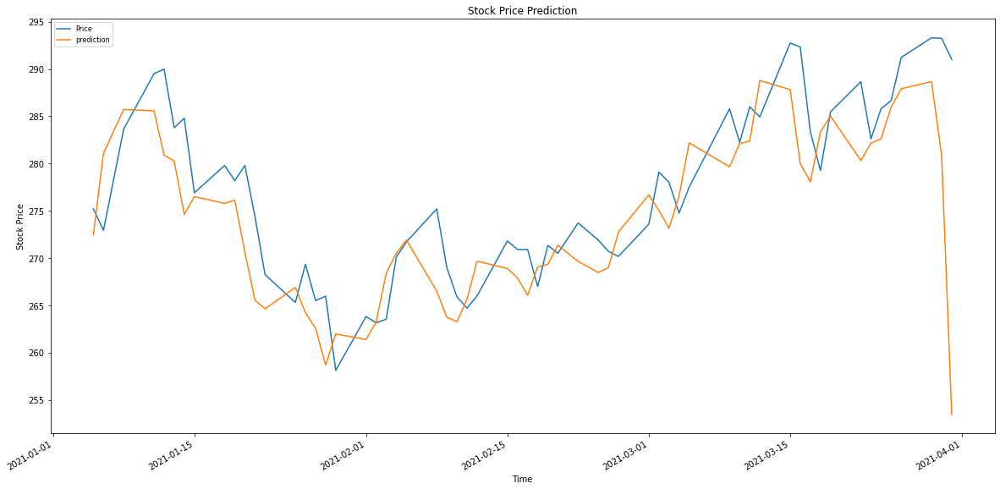

(0.01636297220766736, 6.923643448250442)

In [249]:
#Plot predictions
actual_vs_pred_plot(LSTM_prediction_best)   

In [250]:
print("The results of test data are: MAPE=0.01636297220766736 and RMSE=6.923643448250442")

The results of test data are: MAPE=0.01636297220766736 and RMSE=6.923643448250442


* ### 4.4 GRU model    

 I choose to use a time step of 20 days and a prediod of 1 predictions

In [251]:
#create a GRU model
def GRU_model(X_train, y_train, X_test, sc):
    # The GRU architecture
    regressor = Sequential()
    # Adding first GRU layer and some dropout Dropout regularisation
    regressor.add(GRU(units=100, return_sequences=True, input_shape = (X_train.shape[1], 1)))
    regressor.add(Dropout(0.2))

    # Adding second GRU layer and some dropout Dropout regularisation
    regressor.add(GRU(units=100, return_sequences=True))
    regressor.add(Dropout(0.2))

    # Adding third GRU layer and some dropout Dropout regularisation
    regressor.add(GRU(units=100, return_sequences=True))
    regressor.add(Dropout(0.2))

    # Adding fourth GRU layer and some dropout Dropout regularisation
    regressor.add(GRU(units=100, return_sequences=True))
    regressor.add(Dropout(0.2))

    # Adding fifth GRU layer and some dropout Dropout regularisation
    regressor.add(GRU(units=100))
    regressor.add(Dropout(0.2))

    # Adding the Output Layer
    regressor.add(Dense(units=1))

    # Compiling the GRU
    # Because we're doing regression hence mean_squared_error
    regressor.compile(optimizer = 'adam', loss = 'mean_squared_error', metrics=['accuracy'])

    # Fitting the RNN to the Training set
    regressor.fit(X_train, y_train, epochs = 100, batch_size = 32)
    
    GRU_prediction = regressor.predict(X_test)
    GRU_prediction = sc.inverse_transform(GRU_prediction)

    return regressor, GRU_prediction

In [252]:
np.random.seed(1)
GRU_model, GRU_predictions = GRU_model(X_train, y_train, X_test, sc)

Epoch 1/100
8/8 [==============================] - 16s 76ms/step - loss: 0.0886 - accuracy: 0.0044
Epoch 2/100
8/8 [==============================] - 1s 71ms/step - loss: 0.0313 - accuracy: 0.0044
Epoch 3/100
8/8 [==============================] - 1s 74ms/step - loss: 0.0181 - accuracy: 0.0044
Epoch 4/100
8/8 [==============================] - 1s 75ms/step - loss: 0.0145 - accuracy: 0.0044
Epoch 5/100
8/8 [==============================] - 1s 73ms/step - loss: 0.0117 - accuracy: 0.0044
Epoch 6/100
8/8 [==============================] - 1s 74ms/step - loss: 0.0117 - accuracy: 0.0044
Epoch 7/100
8/8 [==============================] - 1s 73ms/step - loss: 0.0101 - accuracy: 0.0044
Epoch 8/100
8/8 [==============================] - 1s 72ms/step - loss: 0.0103 - accuracy: 0.0044
Epoch 9/100
8/8 [==============================] - 1s 74ms/step - loss: 0.0083 - accuracy: 0.0044
Epoch 10/100
8/8 [==============================] - 1s 72ms/step - loss: 0.0103 - accuracy: 0.0044
Epoch 11/100
8/8 [

8/8 [==============================] - 1s 72ms/step - loss: 0.0036 - accuracy: 0.0044
Epoch 84/100
8/8 [==============================] - 1s 71ms/step - loss: 0.0038 - accuracy: 0.0044
Epoch 85/100
8/8 [==============================] - 1s 74ms/step - loss: 0.0047 - accuracy: 0.0044
Epoch 86/100
8/8 [==============================] - 1s 75ms/step - loss: 0.0046 - accuracy: 0.0044
Epoch 87/100
8/8 [==============================] - 1s 79ms/step - loss: 0.0040 - accuracy: 0.0044
Epoch 88/100
8/8 [==============================] - 1s 79ms/step - loss: 0.0033 - accuracy: 0.0044
Epoch 89/100
8/8 [==============================] - 1s 89ms/step - loss: 0.0035 - accuracy: 0.0044
Epoch 90/100
8/8 [==============================] - 1s 71ms/step - loss: 0.0037 - accuracy: 0.0044
Epoch 91/100
8/8 [==============================] - 1s 71ms/step - loss: 0.0044 - accuracy: 0.0044
Epoch 92/100
8/8 [==============================] - 1s 74ms/step - loss: 0.0045 - accuracy: 0.0044
Epoch 93/100
8/8 [=====

In [261]:
GRU_model.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru (GRU)                   (None, 20, 100)           30900     
                                                                 
 dropout_15 (Dropout)        (None, 20, 100)           0         
                                                                 
 gru_1 (GRU)                 (None, 20, 100)           60600     
                                                                 
 dropout_16 (Dropout)        (None, 20, 100)           0         
                                                                 
 gru_2 (GRU)                 (None, 20, 100)           60600     
                                                                 
 dropout_17 (Dropout)        (None, 20, 100)           0         
                                                                 
 gru_3 (GRU)                 (None, 20, 100)          

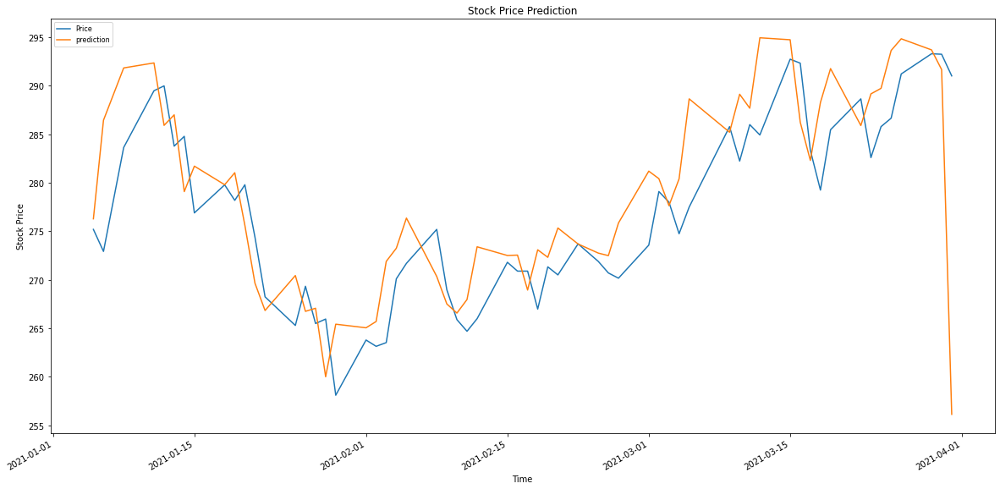

(0.01630756098037297, 6.71004777634727)

In [253]:
#plot predictions
actual_vs_pred_plot(GRU_predictions)  

In [254]:
print("The results of test data are: MAPE=0.01630756098037297and RMSE=6.71004777634727")

The results of test data are: MAPE=0.01630756098037297and RMSE=6.71004777634727


* ### GRU with hyperopt
 Before start tuning hyperparams of GRU, what is first Hyperparameter tuning (or hyperparameter optimization)?   
It is the process of determining the right combination of hyperparameters that maximizes the model performance. It works by running multiple trials in a single training process. Each trial is a complete execution of your training application with values for your chosen hyperparameters, set within the limits you specify. This process once finished will give you the set of hyperparameter values that are best suited for the model to give optimal results.  
let's tune GRU params with hyperopt.       
* There are many ways to tune hyperparameters. Among them, we find :1- RandomSearch , 2- GridSarchCV. Each one have it's weakness.The first one my skip important combinations, and the second even if it's efficient but it's very slow, wich affect the time of the task.    
* Also, there is a method called 3- Bayesian approaches. In contrast to random or grid search, it keeps track of past evaluation results which they use to form a probabilistic model mapping hyperparameters to a probability of a score on the objective function: **P(score/next hyperparam)**
* 4- Tree-structured Parzen estimators (TPE): The idea is similar to Bayesian optimization. Instead of finding the values of p(y|x) where y is the function to be minimized (e.g., validation loss) and x is the value of hyperparameter the TPE models P(x|y) and P(y).However, one of the great drawbacks of tree-structured Parzen estimators is that they do not model interactions between the hyper-parameters. That said TPE works extremely well in practice and was battle-tested across most domains.       
Now that we know few algorithms for hyperparam optimization, let's explore some packages that help us to do the task.   
First, let's start with **hyperopt**.    
* Hyperopt is one of the most popular hyperparameter tuning packages available. Hyperopt allows the user to describe a search space in which the user expects the best results allowing the algorithms in hyperopt to search more efficiently.   
To use hyperopt, these are the main concepts to describe:

1. the objective function to minimize
2. space over which to search
3. the trials in which to store all the point evaluations of the search
4. the search algorithm to use (random search /TPE)       

So let's start!


In [69]:
space = {
            'units': scope.int(hp.quniform('units',80,200,60)),

            'dropout': hp.quniform('dropout',0.2,0.4,0.2),
    
            'batch_size': scope.int(hp.quniform('batch_size',16,32,16)),

            'nb_epochs': scope.int(hp.quniform('nb_epochs',50,250,100)),
            'optimizer': hp.choice('optimizer',['adam','sgd','RMSprop']),
            'activation': hp.choice('activation',['relu','LeakyReLU','tanh']),
            'learning_rate':hp.choice('learning_rate',[0.01,0.001,0.0001]),
        }


In [70]:
np.random.seed(1)
#choose a time step of 20 days and a prediod of 1 predictions
X_train, y_train, X_test, sc = build_train_test_normalize(20,1)
X_train.shape[0],X_train.shape[1]

(229, 20)

In [71]:
def Obj_fc_gru(params):
    np.random.seed(1)
    # The GRU architecture
    regressor = Sequential()
    # Adding first GRU layer and some dropout Dropout regularisation
    regressor.add(GRU(units=params['units'], activation=params['activation'], return_sequences=True, input_shape = (X_train.shape[1], 1)))
    regressor.add(Dropout(rate=params['dropout']))

    # Adding second GRU layer and some dropout Dropout regularisation
    regressor.add(GRU(units=params['units'],activation=params['activation'], return_sequences=True))
    regressor.add(Dropout(rate=params['dropout']))

    # Adding third GRU layer and some dropout Dropout regularisation
    regressor.add(GRU(units=params['units'],activation=params['activation'], return_sequences=True))
    regressor.add(Dropout(rate=params['dropout']))

    # Adding fourth GRU layer and some dropout Dropout regularisation
    regressor.add(GRU(units=params['units'],activation=params['activation'], return_sequences=True))
    regressor.add(Dropout(rate=params['dropout']))

    # Adding fifth GRU layer and some dropout Dropout regularisation
    regressor.add(GRU(units=params['units']))
    regressor.add(Dropout(rate=params['dropout']))

    # Adding the Output Layer
    regressor.add(Dense(units=1,activation=params['activation']))
    
    #define optimizer
    if params['optimizer'] =='sgd':
         optim = SGD(lr=params['learning_rate'])
    elif params['optimizer']=='adam':
         optim = Adam(lr=params['learning_rate'])
    elif params['optimizer']=='RMSprop':
         optim = RMSprop(lr=params['learning_rate'])
            
    # Because we're doing regression hence mean_squared_error
    regressor.compile(optimizer=optim, loss = 'mean_squared_error', metrics=['accuracy'])
    es = EarlyStopping(monitor='val_loss',mode='min', verbose=1,patience=15)

    #fit result
    result=regressor.fit(X_train, y_train, epochs=params['nb_epochs'], batch_size=params['batch_size'], verbose = 1,validation_split=0.2)
    
    # Get the lowest validation loss of the training epochs
    validation_loss = np.amin(result.history['val_loss']) 
    print('Best validation loss of epoch:', validation_loss)
    
    return {'loss': validation_loss.item(), 'status': STATUS_OK, 'model': regressor, 'params': params}

In [72]:
np.random.seed(1)
trials = Trials()
best = fmin(Obj_fc_gru, space, algo=tpe.suggest, max_evals=30, trials=trials)
print('best: ', best)

Epoch 1/200                                                                                                            
 1/12 [=>............................]                                                                                 
 - ETA: 2:22 - loss: 0.1713 - accuracy: 0.0000e+00                                                                     
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 0s - loss: 0.1473 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 0s - loss: 0.1275 - accuracy: 0.02

 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0313 - accuracy: 0.0089                                                                           
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0287 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0288 - accuracy: 0.0069                                                                           
                                          

 - 1s 80ms/step - loss: 0.0294 - accuracy: 0.0055 - val_loss: 0.1323 - val_accuracy: 0.0000e+00                        

Epoch 8/200                                                                                                            
 1/12 [=>............................]                                                                                 
 - ETA: 0s - loss: 0.0310 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 0s - loss: 0.0271 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]   

                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0301 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0315 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0309 - accuracy: 0.006

12/12 [==============================]                                                                                 
 - 1s 84ms/step - loss: 0.0270 - accuracy: 0.0055 - val_loss: 0.1311 - val_accuracy: 0.0000e+00                        

Epoch 15/200                                                                                                           
 1/12 [=>............................]                                                                                 
 - ETA: 0s - loss: 0.0218 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 0s - loss: 0.0171 - accuracy: 0.0000e+00                                                                       
                                        

 - ETA: 0s - loss: 0.0268 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0266 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0254 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 9/12 [=====================>........]     

                                                                                                                      
12/12 [==============================]                                                                                 
 - 1s 79ms/step - loss: 0.0275 - accuracy: 0.0055 - val_loss: 0.1320 - val_accuracy: 0.0000e+00                        

Epoch 22/200                                                                                                           
 1/12 [=>............................]                                                                                 
 - ETA: 0s - loss: 0.0190 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 0s - loss: 0.0252 - accuracy: 0.0

 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0253 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0266 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0275 - accuracy: 0.0078                                                                           
                                          

 - ETA: 0s - loss: 0.0274 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 1s 68ms/step - loss: 0.0274 - accuracy: 0.0055 - val_loss: 0.1308 - val_accuracy: 0.0000e+00                        

Epoch 29/200                                                                                                           
 1/12 [=>............................]                                                                                 
 - ETA: 0s - loss: 0.0210 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]   

                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0279 - accuracy: 0.0104                                                                           
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0262 - accuracy: 0.0089                                                                           
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0268 - accuracy: 0.007

12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0271 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 1s 94ms/step - loss: 0.0271 - accuracy: 0.0055 - val_loss: 0.1326 - val_accuracy: 0.0000e+00                        

Epoch 36/200                                                                                                           
 1/12 [=>............................]                                                                                 
 - ETA: 0s - loss: 0.0197 - accuracy: 0.0000e+00                                                                       
                                        

 - ETA: 0s - loss: 0.0283 - accuracy: 0.0125                                                                           
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0280 - accuracy: 0.0104                                                                           
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0284 - accuracy: 0.0089                                                                           
                                                                                                                      
 8/12 [===================>..........]     

                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 0s - loss: 0.0262 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 0s - loss: 0.0261 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0260 - accuracy: 0.000

 4/12 [=========>....................]                                                                                 
 - ETA: 0s - loss: 0.0225 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0241 - accuracy: 0.0125                                                                           
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0238 - accuracy: 0.0104                                                                           
                                          

 - ETA: 0s - loss: 0.0260 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0250 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0257 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]     

                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 0s - loss: 0.0216 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0208 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0216 - accuracy: 0.000

10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0232 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0239 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0245 - accuracy: 0.0055                                                                           
                                          

 - ETA: 0s - loss: 0.0247 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 0s - loss: 0.0245 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0232 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 6/12 [==============>...............]     

                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0264 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0259 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0261 - accuracy: 0.005

 3/12 [======>.......................]                                                                                 
 - ETA: 0s - loss: 0.0201 - accuracy: 0.0208                                                                           
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 0s - loss: 0.0202 - accuracy: 0.0156                                                                           
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0210 - accuracy: 0.0125                                                                           
                                          

 - ETA: 0s - loss: 0.0240 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0245 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0245 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]     

                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 0s - loss: 0.0224 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 0s - loss: 0.0244 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0234 - accuracy: 0.000

 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0223 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0229 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0239 - accuracy: 0.0057                                                                           
                                          

 - ETA: 0s - loss: 0.0183 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 0s - loss: 0.0177 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 0s - loss: 0.0180 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 5/12 [===========>..................]     

                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0230 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0229 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0235 - accuracy: 0.005

 2/12 [====>.........................]                                                                                 
 - ETA: 0s - loss: 0.0189 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 0s - loss: 0.0178 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 0s - loss: 0.0186 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 0s - loss: 0.0217 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0219 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0232 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]     

                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 0s - loss: 0.0139 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 0s - loss: 0.0201 - accuracy: 0.0208                                                                           
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 0s - loss: 0.0210 - accuracy: 0.015

 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0233 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0226 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0224 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 0s - loss: 0.0243 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 0s - loss: 0.0243 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 0s - loss: 0.0241 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]     

                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0203 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0197 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0200 - accuracy: 0.006

 1/12 [=>............................]                                                                                 
 - ETA: 0s - loss: 0.0257 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 0s - loss: 0.0273 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 0s - loss: 0.0227 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 0s - loss: 0.0198 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0203 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0196 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
10/12 [========================>.....]     

Epoch 117/200                                                                                                          
 1/12 [=>............................]                                                                                 
 - ETA: 0s - loss: 0.0244 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 1s - loss: 0.0192 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 0s - loss: 0.0202 - accuracy: 0.00

 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0184 - accuracy: 0.0089                                                                           
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0195 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0199 - accuracy: 0.0069                                                                           
                                          

 - 1s 88ms/step - loss: 0.0184 - accuracy: 0.0055 - val_loss: 0.0993 - val_accuracy: 0.0000e+00                        

Epoch 124/200                                                                                                          
 1/12 [=>............................]                                                                                 
 - ETA: 0s - loss: 0.0150 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 0s - loss: 0.0135 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]   

                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0197 - accuracy: 0.0089                                                                           
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0199 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0196 - accuracy: 0.006

12/12 [==============================]                                                                                 
 - 1s 82ms/step - loss: 0.0175 - accuracy: 0.0055 - val_loss: 0.1005 - val_accuracy: 0.0000e+00                        

Epoch 131/200                                                                                                          
 1/12 [=>............................]                                                                                 
 - ETA: 0s - loss: 0.0229 - accuracy: 0.0625                                                                           
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 0s - loss: 0.0199 - accuracy: 0.0312                                                                           
                                        

 - ETA: 0s - loss: 0.0190 - accuracy: 0.0104                                                                           
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0175 - accuracy: 0.0089                                                                           
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0173 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]     

                                                                                                                      
12/12 [==============================]                                                                                 
 - 1s 79ms/step - loss: 0.0180 - accuracy: 0.0055 - val_loss: 0.0948 - val_accuracy: 0.0000e+00                        

Epoch 138/200                                                                                                          
 1/12 [=>............................]                                                                                 
 - ETA: 0s - loss: 0.0104 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 0s - loss: 0.0140 - accuracy: 0.0

 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0169 - accuracy: 0.0104                                                                           
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0168 - accuracy: 0.0089                                                                           
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0172 - accuracy: 0.0078                                                                           
                                          

 - ETA: 0s - loss: 0.0158 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 1s 80ms/step - loss: 0.0158 - accuracy: 0.0055 - val_loss: 0.0912 - val_accuracy: 0.0000e+00                        

Epoch 145/200                                                                                                          
 1/12 [=>............................]                                                                                 
 - ETA: 0s - loss: 0.0161 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]   

                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0146 - accuracy: 0.0104                                                                           
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0153 - accuracy: 0.0089                                                                           
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0152 - accuracy: 0.007

12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0146 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 1s 80ms/step - loss: 0.0146 - accuracy: 0.0055 - val_loss: 0.0791 - val_accuracy: 0.0000e+00                        

Epoch 152/200                                                                                                          
 1/12 [=>............................]                                                                                 
 - ETA: 0s - loss: 0.0143 - accuracy: 0.0000e+00                                                                       
                                        

 - ETA: 0s - loss: 0.0169 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0169 - accuracy: 0.0104                                                                           
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0153 - accuracy: 0.0089                                                                           
                                                                                                                      
 8/12 [===================>..........]     

                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0147 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 1s 80ms/step - loss: 0.0147 - accuracy: 0.0055 - val_loss: 0.0885 - val_accuracy: 0.0000e+00                        

Epoch 159/200                                                                                                          
 1/12 [=>............................]                                                                                 
 - ETA: 0s - loss: 0.0084 - accuracy: 0.0

 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0121 - accuracy: 0.0125                                                                           
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0136 - accuracy: 0.0104                                                                           
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0132 - accuracy: 0.0089                                                                           
                                          

 - 1s 80ms/step - loss: 0.0122 - accuracy: 0.0055 - val_loss: 0.0768 - val_accuracy: 0.0000e+00                        

Epoch 166/200                                                                                                          
 1/12 [=>............................]                                                                                 
 - ETA: 0s - loss: 0.0099 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 0s - loss: 0.0097 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]   

                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0136 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0127 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0126 - accuracy: 0.000

12/12 [==============================]                                                                                 
 - 1s 79ms/step - loss: 0.0125 - accuracy: 0.0055 - val_loss: 0.0771 - val_accuracy: 0.0000e+00                        

Epoch 173/200                                                                                                          
 1/12 [=>............................]                                                                                 
 - ETA: 0s - loss: 0.0064 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 0s - loss: 0.0117 - accuracy: 0.0312                                                                           
                                        

 - ETA: 0s - loss: 0.0109 - accuracy: 0.0104                                                                           
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0114 - accuracy: 0.0089                                                                           
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0111 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]     

                                                                                                                      
12/12 [==============================]                                                                                 
 - 1s 84ms/step - loss: 0.0105 - accuracy: 0.0055 - val_loss: 0.0681 - val_accuracy: 0.0000e+00                        

Epoch 180/200                                                                                                          
 1/12 [=>............................]                                                                                 
 - ETA: 0s - loss: 0.0126 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 0s - loss: 0.0121 - accuracy: 0.0

 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0111 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0116 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0111 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 0s - loss: 0.0111 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 1s 83ms/step - loss: 0.0111 - accuracy: 0.0055 - val_loss: 0.0657 - val_accuracy: 0.0000e+00                        

Epoch 187/200                                                                                                          
 1/12 [=>............................]                                                                                 
 - ETA: 0s - loss: 0.0169 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]   

                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0118 - accuracy: 0.0104                                                                           
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0126 - accuracy: 0.0089                                                                           
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0117 - accuracy: 0.007

12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0104 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 1s 83ms/step - loss: 0.0104 - accuracy: 0.0055 - val_loss: 0.0566 - val_accuracy: 0.0000e+00                        

Epoch 194/200                                                                                                          
 1/12 [=>............................]                                                                                 
 - ETA: 0s - loss: 0.0067 - accuracy: 0.0000e+00                                                                       
                                        

 - ETA: 0s - loss: 0.0099 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0095 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0100 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 8/12 [===================>..........]     

                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0100 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 1s 80ms/step - loss: 0.0100 - accuracy: 0.0055 - val_loss: 0.0605 - val_accuracy: 0.0000e+00                        

Best validation loss of epoch:                                                                                         
0.056600119918584824                                                                                                   
Epoch 1/200                              

 - ETA: 0s - loss: 0.0161 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0183 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0152 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]       

                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0117 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0115 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 117ms/step - loss: 0.0115 - accuracy:

1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0127 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0117 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0102 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 0s - loss: 0.0090 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0097 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0101 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]       

Epoch 33/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0117 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0121 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0126 - accuracy: 0.00

4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0112 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0111 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0109 - accuracy: 0.0055                                                                           
                                          

 - 1s 130ms/step - loss: 0.0089 - accuracy: 0.0055 - val_loss: 0.0785 - val_accuracy: 0.0000e+00                       

Epoch 46/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0138 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0110 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]     

                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0095 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0094 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0097 - accuracy: 0.005

6/6 [==============================]                                                                                   
 - 1s 120ms/step - loss: 0.0104 - accuracy: 0.0055 - val_loss: 0.0697 - val_accuracy: 0.0000e+00                       

Epoch 59/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0090 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0095 - accuracy: 0.0156                                                                           
                                        

 - ETA: 0s - loss: 0.0081 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0084 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0084 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]       

                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 121ms/step - loss: 0.0083 - accuracy: 0.0055 - val_loss: 0.0729 - val_accuracy: 0.0000e+00                       

Epoch 72/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0124 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0100 - accuracy: 0.0

3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0062 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0080 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0091 - accuracy: 0.0063                                                                           
                                          

 - ETA: 0s - loss: 0.0089 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 135ms/step - loss: 0.0089 - accuracy: 0.0055 - val_loss: 0.0630 - val_accuracy: 0.0000e+00                       

Epoch 85/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0073 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]     

                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0088 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0089 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0087 - accuracy: 0.006

6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0074 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 133ms/step - loss: 0.0074 - accuracy: 0.0055 - val_loss: 0.0812 - val_accuracy: 0.0000e+00                       

Epoch 98/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0095 - accuracy: 0.0000e+00                                                                       
                                        

 - ETA: 0s - loss: 0.0073 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0084 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0089 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]       

                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0080 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 123ms/step - loss: 0.0080 - accuracy: 0.0055 - val_loss: 0.0554 - val_accuracy: 0.0000e+00                       

Epoch 111/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0069 - accuracy: 0.0

2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0062 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0061 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0067 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 0s - loss: 0.0064 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0066 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 132ms/step - loss: 0.0066 - accuracy: 0.0055 - val_loss: 0.0655 - val_accuracy: 0.0000e+00                       

Epoch 124/200                                                                                                          
1/6 [====>.........................]     

                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0071 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0072 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0074 - accuracy: 0.007

5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0063 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0067 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 99ms/step - loss: 0.0067 - accuracy: 0.0055 - val_loss: 0.0449 - val_accuracy: 0.0000e+00                        

Epoch 137/200                            

 - ETA: 0s - loss: 0.0092 - accuracy: 0.0312                                                                           
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0091 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0090 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]       

                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0069 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0072 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 126ms/step - loss: 0.0072 - accuracy:

1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0085 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0079 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0076 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 0s - loss: 0.0075 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0072 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0069 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]       

Epoch 169/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0077 - accuracy: 0.0312                                                                           
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0084 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0071 - accuracy: 0.01

4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0061 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0065 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0063 - accuracy: 0.0055                                                                           
                                          

 - 1s 105ms/step - loss: 0.0065 - accuracy: 0.0055 - val_loss: 0.0497 - val_accuracy: 0.0000e+00                       

Epoch 182/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0045 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0055 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]     

                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0053 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0052 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0052 - accuracy: 0.005

6/6 [==============================]                                                                                   
 - 1s 101ms/step - loss: 0.0072 - accuracy: 0.0055 - val_loss: 0.0497 - val_accuracy: 0.0000e+00                       

Epoch 195/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0056 - accuracy: 0.0312                                                                           
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0065 - accuracy: 0.0156                                                                           
                                        

                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0799 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0666 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0594 - accuracy: 0.006

6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0067 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 112ms/step - loss: 0.0067 - accuracy: 0.0055 - val_loss: 0.0380 - val_accuracy: 0.0000e+00                       

Epoch 8/100                                                                                                            
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0055 - accuracy: 0.0000e+00                                                                       
                                        

 - ETA: 0s - loss: 0.0071 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0069 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0058 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]       

                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0046 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 122ms/step - loss: 0.0046 - accuracy: 0.0055 - val_loss: 0.0186 - val_accuracy: 0.0000e+00                       

Epoch 21/100                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0027 - accuracy: 0.0

2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0040 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0049 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0051 - accuracy: 0.0078                                                                           
                                          

 - ETA: 0s - loss: 0.0033 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0034 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 99ms/step - loss: 0.0034 - accuracy: 0.0055 - val_loss: 0.0113 - val_accuracy: 0.0000e+00                        

Epoch 34/100                                                                                                           
1/6 [====>.........................]     

                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0030 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0028 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0027 - accuracy: 0.000

5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0031 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0032 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 106ms/step - loss: 0.0032 - accuracy: 0.0055 - val_loss: 0.0061 - val_accuracy: 0.0000e+00                       

Epoch 47/100                             

 - ETA: 0s - loss: 0.0016 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0034 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0032 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]       

                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0031 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0029 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 114ms/step - loss: 0.0029 - accuracy:

1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0029 - accuracy: 0.0312                                                                           
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0027 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0031 - accuracy: 0.0104                                                                           
                                          

 - ETA: 0s - loss: 0.0021 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0023 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0027 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]       

Epoch 79/100                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0026 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0020 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0023 - accuracy: 0.01

4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0026 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0028 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0028 - accuracy: 0.0055                                                                           
                                          

 - 1s 106ms/step - loss: 0.0021 - accuracy: 0.0055 - val_loss: 0.0057 - val_accuracy: 0.0000e+00                       

Epoch 92/100                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0025 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0029 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]     

                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0022 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0021 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0022 - accuracy: 0.005

 - ETA: 0s - loss: 0.0308 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 103ms/step - loss: 0.0308 - accuracy: 0.0055 - val_loss: 0.1518 - val_accuracy: 0.0000e+00                       

Epoch 5/200                                                                                                            
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0271 - accuracy: 0.0312                                                                           
                                                                                                                      
2/6 [=========>....................]     

                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0268 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0278 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0306 - accuracy: 0.006

6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0289 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 146ms/step - loss: 0.0289 - accuracy: 0.0055 - val_loss: 0.1328 - val_accuracy: 0.0000e+00                       

Epoch 18/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0309 - accuracy: 0.0000e+00                                                                       
                                        

 - ETA: 0s - loss: 0.0243 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0228 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0251 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]       

                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0277 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 110ms/step - loss: 0.0277 - accuracy: 0.0055 - val_loss: 0.1316 - val_accuracy: 0.0000e+00                       

Epoch 31/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0293 - accuracy: 0.0

2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0292 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0271 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0278 - accuracy: 0.0078                                                                           
                                          

 - ETA: 0s - loss: 0.0263 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0270 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 108ms/step - loss: 0.0270 - accuracy: 0.0055 - val_loss: 0.1311 - val_accuracy: 0.0000e+00                       

Epoch 44/200                                                                                                           
1/6 [====>.........................]     

                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0252 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0262 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0281 - accuracy: 0.007

5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0287 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0274 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 106ms/step - loss: 0.0274 - accuracy: 0.0055 - val_loss: 0.1326 - val_accuracy: 0.0000e+00                       

Epoch 57/200                             

 - ETA: 0s - loss: 0.0204 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0235 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0256 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]       

                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0255 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0262 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 117ms/step - loss: 0.0262 - accuracy:

1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0195 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0219 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0256 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 0s - loss: 0.0236 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0241 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0261 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]       

Epoch 89/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0247 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0257 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0257 - accuracy: 0.01

4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0284 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0265 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0255 - accuracy: 0.0055                                                                           
                                          

 - 1s 128ms/step - loss: 0.0249 - accuracy: 0.0055 - val_loss: 0.1251 - val_accuracy: 0.0000e+00                       

Epoch 102/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0209 - accuracy: 0.0312                                                                           
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0242 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]     

                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0260 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0255 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0254 - accuracy: 0.005

6/6 [==============================]                                                                                   
 - 1s 119ms/step - loss: 0.0240 - accuracy: 0.0055 - val_loss: 0.1233 - val_accuracy: 0.0000e+00                       

Epoch 115/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0188 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0206 - accuracy: 0.0000e+00                                                                       
                                        

 - ETA: 0s - loss: 0.0253 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0264 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0254 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]       

                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 122ms/step - loss: 0.0235 - accuracy: 0.0055 - val_loss: 0.1218 - val_accuracy: 0.0000e+00                       

Epoch 128/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0342 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0305 - accuracy: 0.0

3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0222 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0241 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0247 - accuracy: 0.0063                                                                           
                                          

 - ETA: 0s - loss: 0.0236 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 123ms/step - loss: 0.0236 - accuracy: 0.0055 - val_loss: 0.1188 - val_accuracy: 0.0000e+00                       

Epoch 141/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0225 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]     

                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0214 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0234 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0234 - accuracy: 0.006

6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0223 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 124ms/step - loss: 0.0223 - accuracy: 0.0055 - val_loss: 0.1182 - val_accuracy: 0.0000e+00                       

Epoch 154/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0335 - accuracy: 0.0000e+00                                                                       
                                        

 - ETA: 0s - loss: 0.0211 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0195 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0202 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]       

                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0214 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 135ms/step - loss: 0.0214 - accuracy: 0.0055 - val_loss: 0.1157 - val_accuracy: 0.0000e+00                       

Epoch 167/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0195 - accuracy: 0.0

2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0266 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0256 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0240 - accuracy: 0.0078                                                                           
                                          

 - ETA: 0s - loss: 0.0200 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0205 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 111ms/step - loss: 0.0205 - accuracy: 0.0055 - val_loss: 0.1116 - val_accuracy: 0.0000e+00                       

Epoch 180/200                                                                                                          
1/6 [====>.........................]     

                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0205 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0208 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0217 - accuracy: 0.007

5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0186 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0181 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 146ms/step - loss: 0.0181 - accuracy: 0.0055 - val_loss: 0.1080 - val_accuracy: 0.0000e+00                       

Epoch 193/200                            

 - ETA: 0s - loss: 0.0171 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0194 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0185 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]       

 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.1539 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.1499 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.1444 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 0s - loss: 0.1283 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 2s 145ms/step - loss: 0.1283 - accuracy: 0.0055 - val_loss: 0.4370 - val_accuracy: 0.0000e+00                       

Epoch 7/100                                                                                                            
 1/12 [=>............................]                                                                                 
 - ETA: 1s - loss: 0.0992 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]   

                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.1070 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.1060 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.1089 - accuracy: 0.000

12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.1112 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 2s 137ms/step - loss: 0.1112 - accuracy: 0.0055 - val_loss: 0.3970 - val_accuracy: 0.0000e+00                       

Epoch 14/100                                                                                                           
 1/12 [=>............................]                                                                                 
 - ETA: 1s - loss: 0.0957 - accuracy: 0.0000e+00                                                                       
                                        

 - ETA: 0s - loss: 0.1158 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.1149 - accuracy: 0.0104                                                                           
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.1095 - accuracy: 0.0089                                                                           
                                                                                                                      
 8/12 [===================>..........]     

                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0943 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 1s 114ms/step - loss: 0.0943 - accuracy: 0.0055 - val_loss: 0.3632 - val_accuracy: 0.0000e+00                       

Epoch 21/100                                                                                                           
 1/12 [=>............................]                                                                                 
 - ETA: 1s - loss: 0.1303 - accuracy: 0.0

 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0882 - accuracy: 0.0125                                                                           
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0890 - accuracy: 0.0104                                                                           
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0848 - accuracy: 0.0089                                                                           
                                          

 - ETA: 0s - loss: 0.0823 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0811 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 1s 114ms/step - loss: 0.0811 - accuracy: 0.0055 - val_loss: 0.3340 - val_accuracy: 0.0000e+00                       

Epoch 28/100                                                                                                           
 1/12 [=>............................]   

                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0837 - accuracy: 0.0125                                                                           
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0860 - accuracy: 0.0104                                                                           
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0845 - accuracy: 0.008

11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0759 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0738 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 2s 134ms/step - loss: 0.0738 - accuracy: 0.0055 - val_loss: 0.3091 - val_accuracy: 0.0000e+00                       

Epoch 35/100                             

 - ETA: 0s - loss: 0.0610 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0593 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0590 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 7/12 [================>.............]     

                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0627 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0645 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 2s 135ms/step - loss: 0.0645 - accuracy:

 4/12 [=========>....................]                                                                                 
 - ETA: 1s - loss: 0.0669 - accuracy: 0.0156                                                                           
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 1s - loss: 0.0587 - accuracy: 0.0125                                                                           
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0603 - accuracy: 0.0104                                                                           
                                          

 - ETA: 0s - loss: 0.0545 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0556 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0557 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]     

                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 0s - loss: 0.0519 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0525 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0545 - accuracy: 0.000

10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0490 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0484 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0487 - accuracy: 0.0055                                                                           
                                          

 - ETA: 1s - loss: 0.0400 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 1s - loss: 0.0543 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0532 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 6/12 [==============>...............]     

                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0467 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0469 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0470 - accuracy: 0.005

 3/12 [======>.......................]                                                                                 
 - ETA: 1s - loss: 0.0442 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 1s - loss: 0.0444 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0451 - accuracy: 0.0125                                                                           
                                          

 - ETA: 0s - loss: 0.0460 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0438 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0433 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]     

                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 1s - loss: 0.0524 - accuracy: 0.0208                                                                           
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 0s - loss: 0.0458 - accuracy: 0.0156                                                                           
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0424 - accuracy: 0.012

 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0410 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0405 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0403 - accuracy: 0.0057                                                                           
                                          

 - ETA: 1s - loss: 0.0446 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 1s - loss: 0.0371 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 1s - loss: 0.0348 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 5/12 [===========>..................]     

                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0372 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0363 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0369 - accuracy: 0.005

 2/12 [====>.........................]                                                                                 
 - ETA: 1s - loss: 0.0365 - accuracy: 0.0312                                                                           
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 1s - loss: 0.0380 - accuracy: 0.0208                                                                           
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 0s - loss: 0.0364 - accuracy: 0.0156                                                                           
                                          

 - ETA: 0s - loss: 0.0371 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0387 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0371 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]     

                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 1s - loss: 0.0305 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 1s - loss: 0.0267 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 1s - loss: 0.0392 - accuracy: 0.000

 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0372 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0368 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0360 - accuracy: 0.0063                                                                           
                                          

Epoch 1/200                                                                                                            
1/6 [====>.........................]                                                                                   
 - ETA: 53s - loss: 0.1542 - accuracy: 0.0000e+00                                                                      
                                                                                                                       
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.1591 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.1465 - accuracy: 0.0

4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.1507 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.1512 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.1509 - accuracy: 0.0055                                                                           
                                          

 - 0s 86ms/step - loss: 0.1508 - accuracy: 0.0055 - val_loss: 0.4867 - val_accuracy: 0.0000e+00                        

Epoch 14/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.1569 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.1481 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]     

                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.1506 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.1535 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.1508 - accuracy: 0.005

6/6 [==============================]                                                                                   
 - 1s 95ms/step - loss: 0.1503 - accuracy: 0.0055 - val_loss: 0.4864 - val_accuracy: 0.0000e+00                        

Epoch 27/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.1271 - accuracy: 0.0312                                                                           
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.1314 - accuracy: 0.0156                                                                           
                                        

 - ETA: 0s - loss: 0.1542 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.1562 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.1551 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]       

                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 100ms/step - loss: 0.1442 - accuracy: 0.0055 - val_loss: 0.4742 - val_accuracy: 0.0000e+00                       

Epoch 40/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.1800 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.1506 - accuracy: 0.0

3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.1394 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.1346 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.1321 - accuracy: 0.0063                                                                           
                                          

 - ETA: 0s - loss: 0.1311 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 100ms/step - loss: 0.1311 - accuracy: 0.0055 - val_loss: 0.4459 - val_accuracy: 0.0000e+00                       

Epoch 53/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.1117 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]     

                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.1286 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.1264 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.1269 - accuracy: 0.006

6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.1190 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 98ms/step - loss: 0.1190 - accuracy: 0.0055 - val_loss: 0.4200 - val_accuracy: 0.0000e+00                        

Epoch 66/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0960 - accuracy: 0.0000e+00                                                                       
                                        

 - ETA: 0s - loss: 0.0961 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0971 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.1096 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]       

                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.1084 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 99ms/step - loss: 0.1084 - accuracy: 0.0055 - val_loss: 0.3964 - val_accuracy: 0.0000e+00                        

Epoch 79/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.1016 - accuracy: 0.0

2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0982 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0981 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.1057 - accuracy: 0.0078                                                                           
                                          

 - ETA: 0s - loss: 0.0938 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0993 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 96ms/step - loss: 0.0993 - accuracy: 0.0055 - val_loss: 0.3751 - val_accuracy: 0.0000e+00                        

Epoch 92/200                                                                                                           
1/6 [====>.........................]     

                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0845 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0992 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0870 - accuracy: 0.007

5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0960 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0895 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 103ms/step - loss: 0.0895 - accuracy: 0.0055 - val_loss: 0.3558 - val_accuracy: 0.0000e+00                       

Epoch 105/200                            

 - ETA: 0s - loss: 0.0852 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0949 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0928 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]       

                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0816 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0828 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 101ms/step - loss: 0.0828 - accuracy:

1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0825 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0767 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0767 - accuracy: 0.0104                                                                           
                                          

 - ETA: 0s - loss: 0.0720 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0786 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0769 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]       

Epoch 137/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0406 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0589 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0693 - accuracy: 0.01

4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0704 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0718 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0715 - accuracy: 0.0055                                                                           
                                          

 - 1s 95ms/step - loss: 0.0674 - accuracy: 0.0055 - val_loss: 0.3017 - val_accuracy: 0.0000e+00                        

Epoch 150/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0530 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0564 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]     

                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0593 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0656 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0657 - accuracy: 0.005

6/6 [==============================]                                                                                   
 - 1s 95ms/step - loss: 0.0638 - accuracy: 0.0055 - val_loss: 0.2891 - val_accuracy: 0.0000e+00                        

Epoch 163/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0668 - accuracy: 0.0312                                                                           
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0562 - accuracy: 0.0156                                                                           
                                        

 - ETA: 0s - loss: 0.0512 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0574 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0633 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]       

                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 102ms/step - loss: 0.0601 - accuracy: 0.0055 - val_loss: 0.2775 - val_accuracy: 0.0000e+00                       

Epoch 176/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0549 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0441 - accuracy: 0.0

3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0737 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0689 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0639 - accuracy: 0.0063                                                                           
                                          

 - ETA: 0s - loss: 0.0567 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 97ms/step - loss: 0.0567 - accuracy: 0.0055 - val_loss: 0.2670 - val_accuracy: 0.0000e+00                        

Epoch 189/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0531 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]     

                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0488 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0554 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0572 - accuracy: 0.006

 - ETA: 0s - loss: 0.6939 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.6635 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 20s 649ms/step - loss: 0.6635 - accuracy: 0.0055 - val_loss: 0.1328 - val_accuracy: 0.0000e+00                      

Epoch 2/100                                                                                                            
1/6 [====>.........................]     

                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.4447 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.4213 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.4284 - accuracy: 0.000

5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.4530 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.4502 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 142ms/step - loss: 0.4502 - accuracy: 0.0000e+00 - val_loss: 0.1328 - val_accuracy: 0.0000e+00                   

Epoch 15/100                             

 - ETA: 0s - loss: 0.2218 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.2002 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.1754 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]       

                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0952 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.1029 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 129ms/step - loss: 0.1029 - accuracy:

1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.1537 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.1106 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.1151 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 0s - loss: 0.0736 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0679 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0660 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]       

Epoch 47/100                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0251 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0283 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0347 - accuracy: 0.00

4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0498 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0488 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0467 - accuracy: 0.0055                                                                           
                                          

 - 1s 129ms/step - loss: 0.0529 - accuracy: 0.0000e+00 - val_loss: 0.0564 - val_accuracy: 0.0000e+00                   

Epoch 60/100                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0591 - accuracy: 0.0312                                                                           
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0500 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]     

                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0357 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0355 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0357 - accuracy: 0.005

6/6 [==============================]                                                                                   
 - 1s 125ms/step - loss: 0.0392 - accuracy: 0.0055 - val_loss: 0.0590 - val_accuracy: 0.0000e+00                       

Epoch 73/100                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0538 - accuracy: 0.0312                                                                           
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0480 - accuracy: 0.0156                                                                           
                                        

 - ETA: 0s - loss: 0.0481 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0540 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0532 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]       

                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 132ms/step - loss: 0.0415 - accuracy: 0.0055 - val_loss: 0.2354 - val_accuracy: 0.0000e+00                       

Epoch 86/100                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0387 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0502 - accuracy: 0.0

3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0317 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0316 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0324 - accuracy: 0.0063                                                                           
                                          

 - ETA: 0s - loss: 0.0335 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 126ms/step - loss: 0.0335 - accuracy: 0.0055 - val_loss: 0.0513 - val_accuracy: 0.0000e+00                       

Epoch 99/100                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0465 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]     

 4/12 [=========>....................]                                                                                 
 - ETA: 1s - loss: 0.1391 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.1488 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.1431 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 0s - loss: 0.1419 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.1379 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.1375 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]     

                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 1s - loss: 0.1272 - accuracy: 0.0156                                                                           
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.1334 - accuracy: 0.0125                                                                           
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.1351 - accuracy: 0.010

10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.1220 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.1222 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.1225 - accuracy: 0.0055                                                                           
                                          

 - ETA: 1s - loss: 0.1446 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 1s - loss: 0.1347 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.1338 - accuracy: 0.0125                                                                           
                                                                                                                      
 6/12 [==============>...............]     

                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.1044 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.1076 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.1096 - accuracy: 0.005

 3/12 [======>.......................]                                                                                 
 - ETA: 1s - loss: 0.1016 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 0s - loss: 0.1097 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.1111 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 0s - loss: 0.0989 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0962 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0966 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]     

                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 1s - loss: 0.0818 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 0s - loss: 0.0868 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0885 - accuracy: 0.000

 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0853 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0903 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0873 - accuracy: 0.0057                                                                           
                                          

 - ETA: 1s - loss: 0.0924 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 1s - loss: 0.0916 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 0s - loss: 0.0891 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 5/12 [===========>..................]     

                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0796 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0779 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0772 - accuracy: 0.005

 2/12 [====>.........................]                                                                                 
 - ETA: 1s - loss: 0.0537 - accuracy: 0.0312                                                                           
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 1s - loss: 0.0700 - accuracy: 0.0208                                                                           
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 0s - loss: 0.0803 - accuracy: 0.0156                                                                           
                                          

 - ETA: 0s - loss: 0.0712 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0702 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0711 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]     

                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 1s - loss: 0.0956 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 1s - loss: 0.0768 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 0s - loss: 0.0767 - accuracy: 0.000

 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0633 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0673 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0708 - accuracy: 0.0063                                                                           
                                          

 - ETA: 1s - loss: 0.0740 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 1s - loss: 0.0741 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 1s - loss: 0.0722 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]     

                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0670 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0664 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0651 - accuracy: 0.000

 1/12 [=>............................]                                                                                 
 - ETA: 1s - loss: 0.0628 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 1s - loss: 0.0740 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 1s - loss: 0.0576 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 0s - loss: 0.0631 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0603 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0581 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
10/12 [========================>.....]     

Epoch 73/200                                                                                                           
 1/12 [=>............................]                                                                                 
 - ETA: 1s - loss: 0.0741 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 1s - loss: 0.0636 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 1s - loss: 0.0580 - accuracy: 0.00

 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0612 - accuracy: 0.0089                                                                           
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0577 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0551 - accuracy: 0.0069                                                                           
                                          

 - 2s 142ms/step - loss: 0.0505 - accuracy: 0.0055 - val_loss: 0.2534 - val_accuracy: 0.0000e+00                       

Epoch 80/200                                                                                                           
 1/12 [=>............................]                                                                                 
 - ETA: 1s - loss: 0.0721 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 1s - loss: 0.0582 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]   

                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0550 - accuracy: 0.0089                                                                           
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0544 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0539 - accuracy: 0.006

12/12 [==============================]                                                                                 
 - 2s 136ms/step - loss: 0.0473 - accuracy: 0.0055 - val_loss: 0.2429 - val_accuracy: 0.0000e+00                       

Epoch 87/200                                                                                                           
 1/12 [=>............................]                                                                                 
 - ETA: 1s - loss: 0.0472 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 1s - loss: 0.0397 - accuracy: 0.0000e+00                                                                       
                                        

 - ETA: 0s - loss: 0.0493 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0462 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0453 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 9/12 [=====================>........]     

                                                                                                                      
12/12 [==============================]                                                                                 
 - 2s 129ms/step - loss: 0.0454 - accuracy: 0.0055 - val_loss: 0.2336 - val_accuracy: 0.0000e+00                       

Epoch 94/200                                                                                                           
 1/12 [=>............................]                                                                                 
 - ETA: 1s - loss: 0.0207 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 1s - loss: 0.0313 - accuracy: 0.0

 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0497 - accuracy: 0.0104                                                                           
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0455 - accuracy: 0.0089                                                                           
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0429 - accuracy: 0.0078                                                                           
                                          

 - ETA: 0s - loss: 0.0423 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 2s 128ms/step - loss: 0.0423 - accuracy: 0.0055 - val_loss: 0.2250 - val_accuracy: 0.0000e+00                       

Epoch 101/200                                                                                                          
 1/12 [=>............................]                                                                                 
 - ETA: 1s - loss: 0.0320 - accuracy: 0.0625                                                                           
                                                                                                                      
 2/12 [====>.........................]   

                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0350 - accuracy: 0.0104                                                                           
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0335 - accuracy: 0.0089                                                                           
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0376 - accuracy: 0.007

12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0400 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 2s 129ms/step - loss: 0.0400 - accuracy: 0.0055 - val_loss: 0.2172 - val_accuracy: 0.0000e+00                       

Epoch 108/200                                                                                                          
 1/12 [=>............................]                                                                                 
 - ETA: 1s - loss: 0.0223 - accuracy: 0.0000e+00                                                                       
                                        

 - ETA: 0s - loss: 0.0404 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0414 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0417 - accuracy: 0.0089                                                                           
                                                                                                                      
 8/12 [===================>..........]     

                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0385 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 2s 131ms/step - loss: 0.0385 - accuracy: 0.0055 - val_loss: 0.2102 - val_accuracy: 0.0000e+00                       

Epoch 115/200                                                                                                          
 1/12 [=>............................]                                                                                 
 - ETA: 1s - loss: 0.0462 - accuracy: 0.0

 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0376 - accuracy: 0.0125                                                                           
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0368 - accuracy: 0.0104                                                                           
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0380 - accuracy: 0.0089                                                                           
                                          

 - ETA: 0s - loss: 0.0374 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0367 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 2s 134ms/step - loss: 0.0367 - accuracy: 0.0055 - val_loss: 0.2037 - val_accuracy: 0.0000e+00                       

Epoch 122/200                                                                                                          
 1/12 [=>............................]   

                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0311 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0336 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0342 - accuracy: 0.000

11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0358 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0359 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 2s 131ms/step - loss: 0.0359 - accuracy: 0.0055 - val_loss: 0.1979 - val_accuracy: 0.0000e+00                       

Epoch 129/200                            

 - ETA: 0s - loss: 0.0349 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0353 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0326 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 7/12 [================>.............]     

                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0349 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0345 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 2s 130ms/step - loss: 0.0345 - accuracy:

 4/12 [=========>....................]                                                                                 
 - ETA: 0s - loss: 0.0243 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0306 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0333 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 0s - loss: 0.0351 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0340 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0336 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]     

                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 0s - loss: 0.0404 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0354 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0339 - accuracy: 0.000

10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0320 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0316 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0327 - accuracy: 0.0055                                                                           
                                          

 - ETA: 1s - loss: 0.0320 - accuracy: 0.0208                                                                           
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 0s - loss: 0.0311 - accuracy: 0.0156                                                                           
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0306 - accuracy: 0.0125                                                                           
                                                                                                                      
 6/12 [==============>...............]     

                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0327 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0331 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0323 - accuracy: 0.005

 3/12 [======>.......................]                                                                                 
 - ETA: 1s - loss: 0.0331 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 1s - loss: 0.0312 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0320 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 0s - loss: 0.0337 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0330 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0326 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]     

                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 1s - loss: 0.0342 - accuracy: 0.0208                                                                           
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 1s - loss: 0.0312 - accuracy: 0.0156                                                                           
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0329 - accuracy: 0.012

 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0308 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0302 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0303 - accuracy: 0.0057                                                                           
                                          

 - ETA: 1s - loss: 0.0388 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 1s - loss: 0.0331 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 1s - loss: 0.0330 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 5/12 [===========>..................]     

                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0297 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0289 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0304 - accuracy: 0.005

 2/12 [====>.........................]                                                                                 
 - ETA: 1s - loss: 0.0280 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 1s - loss: 0.0322 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 0s - loss: 0.0320 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 0s - loss: 0.0317 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0308 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0310 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]     

                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 1s - loss: 0.0421 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 1s - loss: 0.0353 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 1s - loss: 0.0350 - accuracy: 0.000

 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0295 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0292 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0292 - accuracy: 0.0063                                                                           
                                          

 - ETA: 1s - loss: 0.0231 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 1s - loss: 0.0251 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 1s - loss: 0.0272 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]     

                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0279 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0302 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0307 - accuracy: 0.000

 - ETA: 0s - loss: 0.1176 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 127ms/step - loss: 0.1176 - accuracy: 0.0055 - val_loss: 0.3771 - val_accuracy: 0.0000e+00                       

Epoch 3/100                                                                                                            
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.1126 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]     

                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0145 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0143 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0138 - accuracy: 0.006

6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0113 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 121ms/step - loss: 0.0113 - accuracy: 0.0055 - val_loss: 0.0589 - val_accuracy: 0.0000e+00                       

Epoch 16/100                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0112 - accuracy: 0.0000e+00                                                                       
                                        

 - ETA: 0s - loss: 0.0085 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0077 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0076 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]       

                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0078 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 121ms/step - loss: 0.0078 - accuracy: 0.0055 - val_loss: 0.0425 - val_accuracy: 0.0000e+00                       

Epoch 29/100                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0071 - accuracy: 0.0

2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0057 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0063 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0069 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 0s - loss: 0.0074 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0074 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 129ms/step - loss: 0.0074 - accuracy: 0.0055 - val_loss: 0.0399 - val_accuracy: 0.0000e+00                       

Epoch 42/100                                                                                                           
1/6 [====>.........................]     

                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0098 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0083 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0076 - accuracy: 0.007

5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0069 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0074 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 144ms/step - loss: 0.0074 - accuracy: 0.0055 - val_loss: 0.0366 - val_accuracy: 0.0000e+00                       

Epoch 55/100                             

 - ETA: 0s - loss: 0.0075 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0079 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0072 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]       

                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0070 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0070 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 123ms/step - loss: 0.0070 - accuracy:

1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0043 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0052 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0060 - accuracy: 0.0104                                                                           
                                          

 - ETA: 0s - loss: 0.0068 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0069 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0066 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]       

Epoch 87/100                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 1s - loss: 0.0050 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0067 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0058 - accuracy: 0.01

4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0053 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0056 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0056 - accuracy: 0.0055                                                                           
                                          

 - 1s 148ms/step - loss: 0.0060 - accuracy: 0.0055 - val_loss: 0.0188 - val_accuracy: 0.0000e+00                       

Epoch 100/100                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0063 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0066 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]     

3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0101 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0094 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0084 - accuracy: 0.0063                                                                           
                                          

 - ETA: 0s - loss: 0.0067 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 135ms/step - loss: 0.0067 - accuracy: 0.0055 - val_loss: 0.0238 - val_accuracy: 0.0000e+00                       

Epoch 13/100                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0058 - accuracy: 0.0312                                                                           
                                                                                                                      
2/6 [=========>....................]     

                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0054 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0063 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0061 - accuracy: 0.006

6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0047 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 136ms/step - loss: 0.0047 - accuracy: 0.0055 - val_loss: 0.0133 - val_accuracy: 0.0000e+00                       

Epoch 26/100                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0050 - accuracy: 0.0312                                                                           
                                        

 - ETA: 0s - loss: 0.0036 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0029 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0029 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]       

                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0038 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 143ms/step - loss: 0.0038 - accuracy: 0.0055 - val_loss: 0.0147 - val_accuracy: 0.0000e+00                       

Epoch 39/100                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0033 - accuracy: 0.0

2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0028 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0028 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0024 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 0s - loss: 0.0029 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0030 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 133ms/step - loss: 0.0030 - accuracy: 0.0055 - val_loss: 0.0107 - val_accuracy: 0.0000e+00                       

Epoch 52/100                                                                                                           
1/6 [====>.........................]     

                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0032 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0031 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0032 - accuracy: 0.007

5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0024 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0024 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 130ms/step - loss: 0.0024 - accuracy: 0.0055 - val_loss: 0.0043 - val_accuracy: 0.0000e+00                       

Epoch 65/100                             

 - ETA: 0s - loss: 0.0036 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0032 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0029 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]       

                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0032 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0032 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 131ms/step - loss: 0.0032 - accuracy:

1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0020 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0019 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0026 - accuracy: 0.0104                                                                           
                                          

 - ETA: 0s - loss: 0.0033 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0033 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0032 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]       

Epoch 97/100                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0013 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0021 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0021 - accuracy: 0.01

 - ETA: 0s - loss: 0.0124 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0132 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0134 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]       

                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 139ms/step - loss: 0.0172 - accuracy: 0.0055 - val_loss: 0.0436 - val_accuracy: 0.0000e+00                       

Epoch 10/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0135 - accuracy: 0.0312                                                                           
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0104 - accuracy: 0.0

3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0084 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0078 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0078 - accuracy: 0.0063                                                                           
                                          

 - ETA: 0s - loss: 0.0072 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 125ms/step - loss: 0.0072 - accuracy: 0.0055 - val_loss: 0.0166 - val_accuracy: 0.0000e+00                       

Epoch 23/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0097 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]     

                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0107 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0114 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0129 - accuracy: 0.000

6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0052 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 134ms/step - loss: 0.0052 - accuracy: 0.0055 - val_loss: 0.0112 - val_accuracy: 0.0000e+00                       

Epoch 36/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0106 - accuracy: 0.0000e+00                                                                       
                                        

 - ETA: 0s - loss: 0.0056 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0063 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0070 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]       

                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0080 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 124ms/step - loss: 0.0080 - accuracy: 0.0055 - val_loss: 0.0051 - val_accuracy: 0.0000e+00                       

Epoch 49/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0059 - accuracy: 0.0

2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0057 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0063 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0062 - accuracy: 0.0078                                                                           
                                          

 - ETA: 0s - loss: 0.0063 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0061 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 122ms/step - loss: 0.0061 - accuracy: 0.0055 - val_loss: 0.0052 - val_accuracy: 0.0000e+00                       

Epoch 62/200                                                                                                           
1/6 [====>.........................]     

                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0044 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0046 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0055 - accuracy: 0.007

5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0065 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0060 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 125ms/step - loss: 0.0060 - accuracy: 0.0055 - val_loss: 0.0142 - val_accuracy: 0.0000e+00                       

Epoch 75/200                             

 - ETA: 0s - loss: 0.0062 - accuracy: 0.0312                                                                           
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0055 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0053 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]       

                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0040 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0039 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 146ms/step - loss: 0.0039 - accuracy:

1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0066 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0058 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0058 - accuracy: 0.0104                                                                           
                                          

 - ETA: 0s - loss: 0.0033 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0032 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0031 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]       

Epoch 107/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0046 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0034 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0033 - accuracy: 0.01

4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0042 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0040 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0039 - accuracy: 0.0055                                                                           
                                          

 - 1s 161ms/step - loss: 0.0036 - accuracy: 0.0055 - val_loss: 0.0118 - val_accuracy: 0.0000e+00                       

Epoch 120/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0056 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0043 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]     

                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0046 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0055 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0052 - accuracy: 0.005

6/6 [==============================]                                                                                   
 - 1s 145ms/step - loss: 0.0034 - accuracy: 0.0055 - val_loss: 0.0070 - val_accuracy: 0.0000e+00                       

Epoch 133/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0018 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0027 - accuracy: 0.0000e+00                                                                       
                                        

 - ETA: 0s - loss: 0.0053 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0054 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0059 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]       

                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 127ms/step - loss: 0.0040 - accuracy: 0.0055 - val_loss: 0.0038 - val_accuracy: 0.0000e+00                       

Epoch 146/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0040 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0036 - accuracy: 0.0

3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0065 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0058 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0053 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 0s - loss: 0.0045 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 126ms/step - loss: 0.0045 - accuracy: 0.0055 - val_loss: 0.0037 - val_accuracy: 0.0000e+00                       

Epoch 159/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0040 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]     

                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0037 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0040 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0045 - accuracy: 0.006

6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0039 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 135ms/step - loss: 0.0039 - accuracy: 0.0055 - val_loss: 0.0072 - val_accuracy: 0.0000e+00                       

Epoch 172/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0027 - accuracy: 0.0312                                                                           
                                        

 - ETA: 0s - loss: 0.0027 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0025 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0027 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]       

                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0031 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 131ms/step - loss: 0.0031 - accuracy: 0.0055 - val_loss: 0.0038 - val_accuracy: 0.0000e+00                       

Epoch 185/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0029 - accuracy: 0.0

2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0038 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0033 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0031 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 0s - loss: 0.0043 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0039 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 133ms/step - loss: 0.0039 - accuracy: 0.0055 - val_loss: 0.0042 - val_accuracy: 0.0000e+00                       

Epoch 198/200                                                                                                          
1/6 [====>.........................]     

 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.1399 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.1375 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.1395 - accuracy: 0.0057                                                                           
                                          

 - ETA: 1s - loss: 0.1082 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 1s - loss: 0.1131 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 1s - loss: 0.1119 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 5/12 [===========>..................]     

                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.1126 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.1127 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.1144 - accuracy: 0.005

 2/12 [====>.........................]                                                                                 
 - ETA: 0s - loss: 0.1055 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 0s - loss: 0.1075 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 0s - loss: 0.1008 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 0s - loss: 0.0916 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0944 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0941 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]     

                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 3s - loss: 0.0998 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 3s - loss: 0.0824 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 2s - loss: 0.0848 - accuracy: 0.000

 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0791 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0807 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0808 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 1s - loss: 0.0708 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 1s - loss: 0.0680 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 1s - loss: 0.0800 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]     

                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 1s - loss: 0.0614 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0664 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0646 - accuracy: 0.006

 1/12 [=>............................]                                                                                 
 - ETA: 1s - loss: 0.0572 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 1s - loss: 0.0604 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 1s - loss: 0.0579 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 0s - loss: 0.0644 - accuracy: 0.0089                                                                           
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0665 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0664 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]     

Epoch 41/100                                                                                                           
 1/12 [=>............................]                                                                                 
 - ETA: 1s - loss: 0.0394 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 1s - loss: 0.0306 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 1s - loss: 0.0417 - accuracy: 0.00

 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0613 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0557 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0542 - accuracy: 0.0000e+00                                                                       
                                          

 - 2s 146ms/step - loss: 0.0517 - accuracy: 0.0055 - val_loss: 0.2489 - val_accuracy: 0.0000e+00                       

Epoch 48/100                                                                                                           
 1/12 [=>............................]                                                                                 
 - ETA: 1s - loss: 0.0252 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 1s - loss: 0.0411 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]   

                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0515 - accuracy: 0.0089                                                                           
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0480 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0463 - accuracy: 0.006

12/12 [==============================]                                                                                 
 - 4s 340ms/step - loss: 0.0455 - accuracy: 0.0055 - val_loss: 0.2335 - val_accuracy: 0.0000e+00                       

Epoch 55/100                                                                                                           
 1/12 [=>............................]                                                                                 
 - ETA: 3s - loss: 0.0329 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 3s - loss: 0.0286 - accuracy: 0.0000e+00                                                                       
                                        

 - ETA: 0s - loss: 0.0413 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0447 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0434 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 9/12 [=====================>........]     

                                                                                                                      
12/12 [==============================]                                                                                 
 - 4s 350ms/step - loss: 0.0412 - accuracy: 0.0055 - val_loss: 0.2201 - val_accuracy: 0.0000e+00                       

Epoch 62/100                                                                                                           
 1/12 [=>............................]                                                                                 
 - ETA: 1s - loss: 0.0411 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 1s - loss: 0.0544 - accuracy: 0.0

 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0371 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0364 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0395 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 0s - loss: 0.0392 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 3s 228ms/step - loss: 0.0392 - accuracy: 0.0055 - val_loss: 0.2087 - val_accuracy: 0.0000e+00                       

Epoch 69/100                                                                                                           
 1/12 [=>............................]                                                                                 
 - ETA: 1s - loss: 0.0473 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]   

                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0394 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0391 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0404 - accuracy: 0.000

12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0366 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 2s 134ms/step - loss: 0.0366 - accuracy: 0.0055 - val_loss: 0.1986 - val_accuracy: 0.0000e+00                       

Epoch 76/100                                                                                                           
 1/12 [=>............................]                                                                                 
 - ETA: 1s - loss: 0.0551 - accuracy: 0.0000e+00                                                                       
                                        

 - ETA: 0s - loss: 0.0320 - accuracy: 0.0125                                                                           
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0313 - accuracy: 0.0104                                                                           
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0317 - accuracy: 0.0089                                                                           
                                                                                                                      
 8/12 [===================>..........]     

                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0340 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 2s 154ms/step - loss: 0.0340 - accuracy: 0.0055 - val_loss: 0.1901 - val_accuracy: 0.0000e+00                       

Epoch 83/100                                                                                                           
 1/12 [=>............................]                                                                                 
 - ETA: 1s - loss: 0.0324 - accuracy: 0.0

 5/12 [===========>..................]                                                                                 
 - ETA: 2s - loss: 0.0298 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 1s - loss: 0.0278 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 1s - loss: 0.0331 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 0s - loss: 0.0330 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0332 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 2s 148ms/step - loss: 0.0332 - accuracy: 0.0055 - val_loss: 0.1824 - val_accuracy: 0.0000e+00                       

Epoch 90/100                                                                                                           
 1/12 [=>............................]   

                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 2s - loss: 0.0339 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 1s - loss: 0.0346 - accuracy: 0.0104                                                                           
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 1s - loss: 0.0362 - accuracy: 0.008

11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0316 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0319 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 2s 133ms/step - loss: 0.0319 - accuracy: 0.0055 - val_loss: 0.1757 - val_accuracy: 0.0000e+00                       

Epoch 97/100                             

 - ETA: 1s - loss: 0.0232 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0250 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0252 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 7/12 [================>.............]     

1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0222 - accuracy: 0.0312                                                                           
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0183 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0192 - accuracy: 0.0104                                                                           
                                          

 - ETA: 0s - loss: 0.0063 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0063 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0064 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]       

Epoch 19/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0038 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 1s - loss: 0.0048 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0046 - accuracy: 0.01

4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0036 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0036 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0036 - accuracy: 0.0055                                                                           
                                          

 - 1s 117ms/step - loss: 0.0031 - accuracy: 0.0055 - val_loss: 0.0091 - val_accuracy: 0.0000e+00                       

Epoch 32/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0052 - accuracy: 0.0312                                                                           
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0037 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]     

                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0035 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0032 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0034 - accuracy: 0.005

6/6 [==============================]                                                                                   
 - 1s 120ms/step - loss: 0.0032 - accuracy: 0.0055 - val_loss: 0.0080 - val_accuracy: 0.0000e+00                       

Epoch 45/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0035 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0033 - accuracy: 0.0156                                                                           
                                        

 - ETA: 0s - loss: 0.0033 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0028 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0027 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
6/6 [==============================]       

                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 122ms/step - loss: 0.0029 - accuracy: 0.0055 - val_loss: 0.0033 - val_accuracy: 0.0000e+00                       

Epoch 58/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0040 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0046 - accuracy: 0.0

3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0032 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0031 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0030 - accuracy: 0.0063                                                                           
                                          

 - ETA: 0s - loss: 0.0033 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 120ms/step - loss: 0.0033 - accuracy: 0.0055 - val_loss: 0.0090 - val_accuracy: 0.0000e+00                       

Epoch 71/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0034 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]     

                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0028 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0026 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0025 - accuracy: 0.006

6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0023 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 138ms/step - loss: 0.0023 - accuracy: 0.0055 - val_loss: 0.0050 - val_accuracy: 0.0000e+00                       

Epoch 84/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0014 - accuracy: 0.0000e+00                                                                       
                                        

 - ETA: 1s - loss: 0.0030 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0027 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0027 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
5/6 [========================>.....]       

                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0018 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 126ms/step - loss: 0.0018 - accuracy: 0.0055 - val_loss: 0.0212 - val_accuracy: 0.0000e+00                       

Epoch 97/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0045 - accuracy: 0.0

2/6 [=========>....................]                                                                                   
 - ETA: 1s - loss: 0.0027 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 1s - loss: 0.0026 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0029 - accuracy: 0.0078                                                                           
                                          

 - ETA: 0s - loss: 0.0023 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0023 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 122ms/step - loss: 0.0023 - accuracy: 0.0055 - val_loss: 0.0081 - val_accuracy: 0.0000e+00                       

Epoch 110/200                                                                                                          
1/6 [====>.........................]     

                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 1s - loss: 0.0031 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0028 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0026 - accuracy: 0.000

5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0019 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0018 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 141ms/step - loss: 0.0018 - accuracy: 0.0055 - val_loss: 0.0081 - val_accuracy: 0.0000e+00                       

Epoch 123/200                            

 - ETA: 1s - loss: 0.0020 - accuracy: 0.0312                                                                           
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 1s - loss: 0.0018 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0018 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]       

                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0019 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0021 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 115ms/step - loss: 0.0021 - accuracy:

1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0011 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0013 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0018 - accuracy: 0.0104                                                                           
                                          

 - ETA: 0s - loss: 0.0020 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0023 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0021 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]       

Epoch 155/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0012 - accuracy: 0.0312                                                                           
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0011 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0013 - accuracy: 0.01

4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0021 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0022 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0022 - accuracy: 0.0055                                                                           
                                          

 - 1s 118ms/step - loss: 0.0022 - accuracy: 0.0055 - val_loss: 0.0100 - val_accuracy: 0.0000e+00                       

Epoch 168/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0020 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0018 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]     

                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0016 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0015 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0014 - accuracy: 0.005

6/6 [==============================]                                                                                   
 - 1s 120ms/step - loss: 0.0020 - accuracy: 0.0055 - val_loss: 0.0124 - val_accuracy: 0.0000e+00                       

Epoch 181/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0013 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0012 - accuracy: 0.0000e+00                                                                       
                                        

 - ETA: 0s - loss: 0.0015 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0016 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0016 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]       

                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 141ms/step - loss: 0.0018 - accuracy: 0.0055 - val_loss: 0.0144 - val_accuracy: 0.0000e+00                       

Epoch 194/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0011 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0020 - accuracy: 0.0

3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0016 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0017 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0018 - accuracy: 0.0063                                                                           
                                          

                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 0s - loss: 0.0194 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 0s - loss: 0.0190 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 0s - loss: 0.0155 - accuracy: 0.000

 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0142 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0143 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0151 - accuracy: 0.0063                                                                           
                                          

 - ETA: 0s - loss: 0.0090 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 0s - loss: 0.0110 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 0s - loss: 0.0117 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]     

                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0117 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0116 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0117 - accuracy: 0.006

 1/12 [=>............................]                                                                                 
 - ETA: 0s - loss: 0.0088 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 0s - loss: 0.0117 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 0s - loss: 0.0115 - accuracy: 0.0208                                                                           
                                          

 - ETA: 0s - loss: 0.0101 - accuracy: 0.0089                                                                           
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0107 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0103 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]     

Epoch 25/200                                                                                                           
 1/12 [=>............................]                                                                                 
 - ETA: 0s - loss: 0.0090 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 0s - loss: 0.0102 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 0s - loss: 0.0080 - accuracy: 0.00

 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0082 - accuracy: 0.0089                                                                           
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0083 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0083 - accuracy: 0.0069                                                                           
                                          

 - 1s 104ms/step - loss: 0.0098 - accuracy: 0.0055 - val_loss: 0.0810 - val_accuracy: 0.0000e+00                       

Epoch 32/200                                                                                                           
 1/12 [=>............................]                                                                                 
 - ETA: 0s - loss: 0.0169 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 0s - loss: 0.0135 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]   

                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0075 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0076 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0081 - accuracy: 0.006

12/12 [==============================]                                                                                 
 - 1s 108ms/step - loss: 0.0090 - accuracy: 0.0055 - val_loss: 0.0603 - val_accuracy: 0.0000e+00                       

Epoch 39/200                                                                                                           
 1/12 [=>............................]                                                                                 
 - ETA: 1s - loss: 0.0071 - accuracy: 0.0625                                                                           
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 1s - loss: 0.0093 - accuracy: 0.0312                                                                           
                                        

 - ETA: 0s - loss: 0.0103 - accuracy: 0.0104                                                                           
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0096 - accuracy: 0.0089                                                                           
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0098 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]     

                                                                                                                      
12/12 [==============================]                                                                                 
 - 1s 96ms/step - loss: 0.0084 - accuracy: 0.0055 - val_loss: 0.0476 - val_accuracy: 0.0000e+00                        

Epoch 46/200                                                                                                           
 1/12 [=>............................]                                                                                 
 - ETA: 0s - loss: 0.0119 - accuracy: 0.0625                                                                           
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 0s - loss: 0.0087 - accuracy: 0.0

 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0086 - accuracy: 0.0104                                                                           
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0084 - accuracy: 0.0089                                                                           
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0080 - accuracy: 0.0078                                                                           
                                          

 - ETA: 0s - loss: 0.0082 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 1s 94ms/step - loss: 0.0082 - accuracy: 0.0055 - val_loss: 0.0534 - val_accuracy: 0.0000e+00                        

Epoch 53/200                                                                                                           
 1/12 [=>............................]                                                                                 
 - ETA: 0s - loss: 0.0058 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]   

                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0081 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0083 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0076 - accuracy: 0.000

12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0078 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 1s 114ms/step - loss: 0.0078 - accuracy: 0.0055 - val_loss: 0.0528 - val_accuracy: 0.0000e+00                       

Epoch 60/200                                                                                                           
 1/12 [=>............................]                                                                                 
 - ETA: 1s - loss: 0.0068 - accuracy: 0.0000e+00                                                                       
                                        

 - ETA: 2s - loss: 0.0084 - accuracy: 0.0125                                                                           
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 1s - loss: 0.0080 - accuracy: 0.0104                                                                           
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 1s - loss: 0.0080 - accuracy: 0.0089                                                                           
                                                                                                                      
 8/12 [===================>..........]     

                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0075 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 1s 97ms/step - loss: 0.0075 - accuracy: 0.0055 - val_loss: 0.0481 - val_accuracy: 0.0000e+00                        

Epoch 67/200                                                                                                           
 1/12 [=>............................]                                                                                 
 - ETA: 0s - loss: 0.0086 - accuracy: 0.0

 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0073 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0075 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0088 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 0s - loss: 0.0079 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0079 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 2s 186ms/step - loss: 0.0079 - accuracy: 0.0055 - val_loss: 0.0465 - val_accuracy: 0.0000e+00                       

Epoch 74/200                                                                                                           
 1/12 [=>............................]   

                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0064 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0067 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0069 - accuracy: 0.000

11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0072 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0070 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 1s 98ms/step - loss: 0.0070 - accuracy: 0.0055 - val_loss: 0.0485 - val_accuracy: 0.0000e+00                        

Epoch 81/200                             

 - ETA: 0s - loss: 0.0079 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0072 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0066 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 7/12 [================>.............]     

                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0069 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0072 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 1s 100ms/step - loss: 0.0072 - accuracy:

 4/12 [=========>....................]                                                                                 
 - ETA: 2s - loss: 0.0057 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 1s - loss: 0.0066 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 1s - loss: 0.0064 - accuracy: 0.0104                                                                           
                                          

 - ETA: 0s - loss: 0.0077 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0076 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0076 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]     

                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 0s - loss: 0.0062 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0065 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0063 - accuracy: 0.000

10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0058 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0065 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0063 - accuracy: 0.0055                                                                           
                                          

 - ETA: 0s - loss: 0.0079 - accuracy: 0.0208                                                                           
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 0s - loss: 0.0069 - accuracy: 0.0156                                                                           
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0067 - accuracy: 0.0125                                                                           
                                                                                                                      
 6/12 [==============>...............]     

                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0061 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0062 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0060 - accuracy: 0.005

 3/12 [======>.......................]                                                                                 
 - ETA: 0s - loss: 0.0062 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 0s - loss: 0.0062 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0061 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 0s - loss: 0.0072 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0072 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0074 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]     

                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 1s - loss: 0.0049 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 0s - loss: 0.0055 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0063 - accuracy: 0.000

 9/12 [=====================>........]                                                                                 
 - ETA: 1s - loss: 0.0057 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0056 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0059 - accuracy: 0.0057                                                                           
                                          

 - ETA: 0s - loss: 0.0068 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 0s - loss: 0.0064 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 0s - loss: 0.0061 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 5/12 [===========>..................]     

                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0067 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0063 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0061 - accuracy: 0.005

 2/12 [====>.........................]                                                                                 
 - ETA: 0s - loss: 0.0058 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 0s - loss: 0.0057 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 0s - loss: 0.0061 - accuracy: 0.0156                                                                           
                                          

 - ETA: 0s - loss: 0.0062 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0060 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0059 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]     

                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 2s - loss: 0.0039 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 2s - loss: 0.0041 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 1s - loss: 0.0039 - accuracy: 0.000

 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0061 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0060 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0058 - accuracy: 0.0063                                                                           
                                          

 - ETA: 0s - loss: 0.0041 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 0s - loss: 0.0040 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 0s - loss: 0.0038 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]     

                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0057 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0055 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0054 - accuracy: 0.006

 1/12 [=>............................]                                                                                 
 - ETA: 0s - loss: 0.0069 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 0s - loss: 0.0052 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 0s - loss: 0.0051 - accuracy: 0.0208                                                                           
                                          

 - ETA: 0s - loss: 0.0041 - accuracy: 0.0089                                                                           
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0040 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0044 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]     

Epoch 161/200                                                                                                          
 1/12 [=>............................]                                                                                 
 - ETA: 0s - loss: 0.0058 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 0s - loss: 0.0042 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 0s - loss: 0.0041 - accuracy: 0.00

 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0054 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0053 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0057 - accuracy: 0.0069                                                                           
                                          

 - 1s 110ms/step - loss: 0.0050 - accuracy: 0.0055 - val_loss: 0.0384 - val_accuracy: 0.0000e+00                       

Epoch 168/200                                                                                                          
 1/12 [=>............................]                                                                                 
 - ETA: 0s - loss: 0.0033 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 0s - loss: 0.0051 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]   

                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0048 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0049 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0047 - accuracy: 0.006

12/12 [==============================]                                                                                 
 - 1s 105ms/step - loss: 0.0052 - accuracy: 0.0055 - val_loss: 0.0397 - val_accuracy: 0.0000e+00                       

Epoch 175/200                                                                                                          
 1/12 [=>............................]                                                                                 
 - ETA: 0s - loss: 0.0044 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 0s - loss: 0.0043 - accuracy: 0.0000e+00                                                                       
                                        

 - ETA: 0s - loss: 0.0051 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0049 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0048 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]     

                                                                                                                      
12/12 [==============================]                                                                                 
 - 1s 116ms/step - loss: 0.0053 - accuracy: 0.0055 - val_loss: 0.0367 - val_accuracy: 0.0000e+00                       

Epoch 182/200                                                                                                          
 1/12 [=>............................]                                                                                 
 - ETA: 0s - loss: 0.0038 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 0s - loss: 0.0059 - accuracy: 0.0

 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0065 - accuracy: 0.0104                                                                           
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0058 - accuracy: 0.0089                                                                           
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0057 - accuracy: 0.0078                                                                           
                                          

 - ETA: 0s - loss: 0.0051 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 2s 139ms/step - loss: 0.0051 - accuracy: 0.0055 - val_loss: 0.0388 - val_accuracy: 0.0000e+00                       

Epoch 189/200                                                                                                          
 1/12 [=>............................]                                                                                 
 - ETA: 2s - loss: 0.0046 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]   

                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0055 - accuracy: 0.0104                                                                           
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0051 - accuracy: 0.0089                                                                           
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0050 - accuracy: 0.007

12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0047 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 1s 103ms/step - loss: 0.0047 - accuracy: 0.0055 - val_loss: 0.0367 - val_accuracy: 0.0000e+00                       

Epoch 196/200                                                                                                          
 1/12 [=>............................]                                                                                 
 - ETA: 0s - loss: 0.0073 - accuracy: 0.0000e+00                                                                       
                                        

 - ETA: 0s - loss: 0.0046 - accuracy: 0.0125                                                                           
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0049 - accuracy: 0.0104                                                                           
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0049 - accuracy: 0.0089                                                                           
                                                                                                                      
 8/12 [===================>..........]     

11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0353 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0350 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 2s 193ms/step - loss: 0.0350 - accuracy: 0.0055 - val_loss: 0.1614 - val_accuracy: 0.0000e+00                       

Epoch 3/100                              

 - ETA: 1s - loss: 0.0258 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0274 - accuracy: 0.0125                                                                           
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0308 - accuracy: 0.0104                                                                           
                                                                                                                      
 7/12 [================>.............]     

                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0275 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0275 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 2s 141ms/step - loss: 0.0275 - accuracy:

 4/12 [=========>....................]                                                                                 
 - ETA: 1s - loss: 0.0238 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0245 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0236 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 0s - loss: 0.0280 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0275 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0273 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]     

                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 1s - loss: 0.0292 - accuracy: 0.0156                                                                           
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 1s - loss: 0.0314 - accuracy: 0.0125                                                                           
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 1s - loss: 0.0301 - accuracy: 0.010

10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0269 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0271 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0271 - accuracy: 0.0055                                                                           
                                          

 - ETA: 1s - loss: 0.0357 - accuracy: 0.0208                                                                           
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 1s - loss: 0.0317 - accuracy: 0.0156                                                                           
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0313 - accuracy: 0.0125                                                                           
                                                                                                                      
 6/12 [==============>...............]     

                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0266 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0270 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0268 - accuracy: 0.005

 3/12 [======>.......................]                                                                                 
 - ETA: 1s - loss: 0.0304 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 1s - loss: 0.0295 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0287 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 0s - loss: 0.0253 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0259 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0267 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]     

                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 3s - loss: 0.0293 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 2s - loss: 0.0291 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 1s - loss: 0.0314 - accuracy: 0.000

 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0262 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0268 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0270 - accuracy: 0.0057                                                                           
                                          

 - ETA: 1s - loss: 0.0303 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 1s - loss: 0.0274 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 1s - loss: 0.0248 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 5/12 [===========>..................]     

                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0269 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0267 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0268 - accuracy: 0.005

 2/12 [====>.........................]                                                                                 
 - ETA: 1s - loss: 0.0195 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 1s - loss: 0.0210 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 0s - loss: 0.0229 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 0s - loss: 0.0257 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0258 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0260 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]     

                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 1s - loss: 0.0291 - accuracy: 0.0312                                                                           
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 1s - loss: 0.0299 - accuracy: 0.0208                                                                           
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 1s - loss: 0.0274 - accuracy: 0.015

 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0242 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0256 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0260 - accuracy: 0.0063                                                                           
                                          

 - ETA: 3s - loss: 0.0294 - accuracy: 0.0625                                                                           
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 3s - loss: 0.0230 - accuracy: 0.0312                                                                           
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 2s - loss: 0.0234 - accuracy: 0.0208                                                                           
                                                                                                                      
 4/12 [=========>....................]     

                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0263 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0260 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0260 - accuracy: 0.006

 1/12 [=>............................]                                                                                 
 - ETA: 3s - loss: 0.0231 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 3s - loss: 0.0284 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 3s - loss: 0.0271 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 0s - loss: 0.0217 - accuracy: 0.0089                                                                           
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0234 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0227 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]     

Epoch 83/100                                                                                                           
 1/12 [=>............................]                                                                                 
 - ETA: 3s - loss: 0.0184 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 3s - loss: 0.0239 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 2s - loss: 0.0245 - accuracy: 0.00

 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0255 - accuracy: 0.0089                                                                           
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0258 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0251 - accuracy: 0.0069                                                                           
                                          

 - 2s 194ms/step - loss: 0.0248 - accuracy: 0.0055 - val_loss: 0.1203 - val_accuracy: 0.0000e+00                       

Epoch 90/100                                                                                                           
 1/12 [=>............................]                                                                                 
 - ETA: 3s - loss: 0.0213 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 3s - loss: 0.0242 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]   

                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0232 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0255 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0258 - accuracy: 0.006

12/12 [==============================]                                                                                 
 - 2s 142ms/step - loss: 0.0245 - accuracy: 0.0055 - val_loss: 0.1202 - val_accuracy: 0.0000e+00                       

Epoch 97/100                                                                                                           
 1/12 [=>............................]                                                                                 
 - ETA: 1s - loss: 0.0299 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 1s - loss: 0.0308 - accuracy: 0.0312                                                                           
                                        

 - ETA: 0s - loss: 0.0237 - accuracy: 0.0104                                                                           
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0228 - accuracy: 0.0089                                                                           
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0231 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]     

12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0904 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 1s 103ms/step - loss: 0.0904 - accuracy: 0.0055 - val_loss: 0.3365 - val_accuracy: 0.0000e+00                       

Epoch 4/200                                                                                                            
 1/12 [=>............................]                                                                                 
 - ETA: 0s - loss: 0.0680 - accuracy: 0.0000e+00                                                                       
                                        

 - ETA: 0s - loss: 0.0365 - accuracy: 0.0125                                                                           
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0363 - accuracy: 0.0104                                                                           
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0416 - accuracy: 0.0089                                                                           
                                                                                                                      
 8/12 [===================>..........]     

                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0382 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 1s 106ms/step - loss: 0.0382 - accuracy: 0.0055 - val_loss: 0.1965 - val_accuracy: 0.0000e+00                       

Epoch 11/200                                                                                                           
 1/12 [=>............................]                                                                                 
 - ETA: 0s - loss: 0.0277 - accuracy: 0.0

 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0292 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0294 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0341 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 0s - loss: 0.0300 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0296 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 1s 103ms/step - loss: 0.0296 - accuracy: 0.0055 - val_loss: 0.1555 - val_accuracy: 0.0000e+00                       

Epoch 18/200                                                                                                           
 1/12 [=>............................]   

                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0255 - accuracy: 0.0125                                                                           
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0298 - accuracy: 0.0104                                                                           
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0297 - accuracy: 0.008

11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0269 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0265 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 1s 106ms/step - loss: 0.0265 - accuracy: 0.0055 - val_loss: 0.1408 - val_accuracy: 0.0000e+00                       

Epoch 25/200                             

 - ETA: 0s - loss: 0.0253 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0245 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0272 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 7/12 [================>.............]     

                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0281 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0282 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 1s 103ms/step - loss: 0.0282 - accuracy:

 4/12 [=========>....................]                                                                                 
 - ETA: 0s - loss: 0.0260 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0265 - accuracy: 0.0125                                                                           
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0278 - accuracy: 0.0104                                                                           
                                          

 - ETA: 0s - loss: 0.0288 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0278 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0277 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]     

                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 0s - loss: 0.0274 - accuracy: 0.0156                                                                           
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0285 - accuracy: 0.0125                                                                           
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0287 - accuracy: 0.010

10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0276 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0271 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0265 - accuracy: 0.0055                                                                           
                                          

 - ETA: 0s - loss: 0.0306 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 0s - loss: 0.0313 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0300 - accuracy: 0.0125                                                                           
                                                                                                                      
 6/12 [==============>...............]     

                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0284 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0275 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0280 - accuracy: 0.005

 3/12 [======>.......................]                                                                                 
 - ETA: 0s - loss: 0.0273 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 0s - loss: 0.0262 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0248 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 0s - loss: 0.0265 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0266 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0268 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]     

                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 0s - loss: 0.0243 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 0s - loss: 0.0286 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0305 - accuracy: 0.000

 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0265 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0259 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0265 - accuracy: 0.0057                                                                           
                                          

 - ETA: 0s - loss: 0.0214 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 0s - loss: 0.0211 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 0s - loss: 0.0271 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 5/12 [===========>..................]     

                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0255 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0263 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0260 - accuracy: 0.005

 2/12 [====>.........................]                                                                                 
 - ETA: 0s - loss: 0.0296 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 0s - loss: 0.0297 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 0s - loss: 0.0263 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 0s - loss: 0.0265 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0279 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0273 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]     

                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 1s - loss: 0.0329 - accuracy: 0.0312                                                                           
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 0s - loss: 0.0282 - accuracy: 0.0208                                                                           
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 0s - loss: 0.0288 - accuracy: 0.015

 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0269 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0271 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0264 - accuracy: 0.0063                                                                           
                                          

 - ETA: 0s - loss: 0.0416 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 0s - loss: 0.0331 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 0s - loss: 0.0266 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]     

                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0260 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0242 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0254 - accuracy: 0.006

 1/12 [=>............................]                                                                                 
 - ETA: 2s - loss: 0.0442 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 2s - loss: 0.0386 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 1s - loss: 0.0345 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 0s - loss: 0.0237 - accuracy: 0.0089                                                                           
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0264 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0261 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]     

Epoch 105/200                                                                                                          
 1/12 [=>............................]                                                                                 
 - ETA: 0s - loss: 0.0165 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 0s - loss: 0.0206 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 0s - loss: 0.0215 - accuracy: 0.00

 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0280 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0292 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0297 - accuracy: 0.0069                                                                           
                                          

 - 1s 120ms/step - loss: 0.0250 - accuracy: 0.0055 - val_loss: 0.1222 - val_accuracy: 0.0000e+00                       

Epoch 112/200                                                                                                          
 1/12 [=>............................]                                                                                 
 - ETA: 0s - loss: 0.0317 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 0s - loss: 0.0330 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]   

                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0283 - accuracy: 0.0089                                                                           
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0291 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0279 - accuracy: 0.006

12/12 [==============================]                                                                                 
 - 1s 103ms/step - loss: 0.0264 - accuracy: 0.0055 - val_loss: 0.1218 - val_accuracy: 0.0000e+00                       

Epoch 119/200                                                                                                          
 1/12 [=>............................]                                                                                 
 - ETA: 0s - loss: 0.0462 - accuracy: 0.0625                                                                           
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 0s - loss: 0.0408 - accuracy: 0.0312                                                                           
                                        

 - ETA: 0s - loss: 0.0270 - accuracy: 0.0104                                                                           
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0273 - accuracy: 0.0089                                                                           
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0267 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]     

                                                                                                                      
12/12 [==============================]                                                                                 
 - 1s 103ms/step - loss: 0.0246 - accuracy: 0.0055 - val_loss: 0.1208 - val_accuracy: 0.0000e+00                       

Epoch 126/200                                                                                                          
 1/12 [=>............................]                                                                                 
 - ETA: 0s - loss: 0.0307 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 0s - loss: 0.0317 - accuracy: 0.0

 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0207 - accuracy: 0.0104                                                                           
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0194 - accuracy: 0.0089                                                                           
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0216 - accuracy: 0.0078                                                                           
                                          

 - ETA: 0s - loss: 0.0251 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 3s 288ms/step - loss: 0.0251 - accuracy: 0.0055 - val_loss: 0.1200 - val_accuracy: 0.0000e+00                       

Epoch 133/200                                                                                                          
 1/12 [=>............................]                                                                                 
 - ETA: 0s - loss: 0.0255 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]   

                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0296 - accuracy: 0.0104                                                                           
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0290 - accuracy: 0.0089                                                                           
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0278 - accuracy: 0.007

12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0247 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 1s 101ms/step - loss: 0.0247 - accuracy: 0.0055 - val_loss: 0.1187 - val_accuracy: 0.0000e+00                       

Epoch 140/200                                                                                                          
 1/12 [=>............................]                                                                                 
 - ETA: 0s - loss: 0.0235 - accuracy: 0.0000e+00                                                                       
                                        

 - ETA: 0s - loss: 0.0262 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0275 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0259 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 8/12 [===================>..........]     

                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0251 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 1s 105ms/step - loss: 0.0251 - accuracy: 0.0055 - val_loss: 0.1191 - val_accuracy: 0.0000e+00                       

Epoch 147/200                                                                                                          
 1/12 [=>............................]                                                                                 
 - ETA: 1s - loss: 0.0199 - accuracy: 0.0

 5/12 [===========>..................]                                                                                 
 - ETA: 1s - loss: 0.0290 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 1s - loss: 0.0282 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 1s - loss: 0.0271 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 0s - loss: 0.0242 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0244 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 1s 113ms/step - loss: 0.0244 - accuracy: 0.0055 - val_loss: 0.1185 - val_accuracy: 0.0000e+00                       

Epoch 154/200                                                                                                          
 1/12 [=>............................]   

                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0248 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0230 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0217 - accuracy: 0.000

11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0239 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0243 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 3s 281ms/step - loss: 0.0243 - accuracy: 0.0055 - val_loss: 0.1186 - val_accuracy: 0.0000e+00                       

Epoch 161/200                            

 - ETA: 0s - loss: 0.0233 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0227 - accuracy: 0.0125                                                                           
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0215 - accuracy: 0.0104                                                                           
                                                                                                                      
 7/12 [================>.............]     

                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0230 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0229 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 1s 100ms/step - loss: 0.0229 - accuracy:

 4/12 [=========>....................]                                                                                 
 - ETA: 0s - loss: 0.0273 - accuracy: 0.0156                                                                           
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0239 - accuracy: 0.0125                                                                           
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0243 - accuracy: 0.0104                                                                           
                                          

 - ETA: 0s - loss: 0.0248 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0257 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0253 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]     

                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 1s - loss: 0.0288 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 1s - loss: 0.0301 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 1s - loss: 0.0275 - accuracy: 0.000

10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0233 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0233 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0233 - accuracy: 0.0055                                                                           
                                          

 - ETA: 1s - loss: 0.0251 - accuracy: 0.0208                                                                           
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 0s - loss: 0.0241 - accuracy: 0.0156                                                                           
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0223 - accuracy: 0.0125                                                                           
                                                                                                                      
 6/12 [==============>...............]     

                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0243 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0245 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0247 - accuracy: 0.005

 3/12 [======>.......................]                                                                                 
 - ETA: 0s - loss: 0.0271 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 0s - loss: 0.0259 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0249 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 0s - loss: 0.0242 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0234 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0231 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]     

                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 0s - loss: 0.0242 - accuracy: 0.0208                                                                           
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 0s - loss: 0.0226 - accuracy: 0.0156                                                                           
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0213 - accuracy: 0.012

 - ETA: 0s - loss: 0.1553 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.1547 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.1542 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]     

                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 1s - loss: 0.0250 - accuracy: 0.0312                                                                           
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 1s - loss: 0.0279 - accuracy: 0.0208                                                                           
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 1s - loss: 0.0248 - accuracy: 0.015

 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0195 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0184 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0192 - accuracy: 0.0063                                                                           
                                          

 - ETA: 1s - loss: 0.0128 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 1s - loss: 0.0114 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 1s - loss: 0.0108 - accuracy: 0.0208                                                                           
                                                                                                                      
 4/12 [=========>....................]     

                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0181 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0171 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0168 - accuracy: 0.006

 1/12 [=>............................]                                                                                 
 - ETA: 1s - loss: 0.0101 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 1s - loss: 0.0118 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 1s - loss: 0.0107 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 0s - loss: 0.0107 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0106 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0101 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]     

Epoch 27/200                                                                                                           
 1/12 [=>............................]                                                                                 
 - ETA: 1s - loss: 0.0050 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 1s - loss: 0.0060 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 1s - loss: 0.0075 - accuracy: 0.00

 7/12 [================>.............]                                                                                 
 - ETA: 1s - loss: 0.0066 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 1s - loss: 0.0066 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0066 - accuracy: 0.0000e+00                                                                       
                                          

 - 2s 142ms/step - loss: 0.0068 - accuracy: 0.0055 - val_loss: 0.0729 - val_accuracy: 0.0000e+00                       

Epoch 34/200                                                                                                           
 1/12 [=>............................]                                                                                 
 - ETA: 1s - loss: 0.0060 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 1s - loss: 0.0051 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]   

                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0069 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0076 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0075 - accuracy: 0.000

12/12 [==============================]                                                                                 
 - 2s 153ms/step - loss: 0.0074 - accuracy: 0.0055 - val_loss: 0.0317 - val_accuracy: 0.0000e+00                       

Epoch 41/200                                                                                                           
 1/12 [=>............................]                                                                                 
 - ETA: 1s - loss: 0.0037 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 2s - loss: 0.0055 - accuracy: 0.0000e+00                                                                       
                                        

 - ETA: 0s - loss: 0.0054 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0058 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0058 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 9/12 [=====================>........]     

                                                                                                                      
12/12 [==============================]                                                                                 
 - 2s 135ms/step - loss: 0.0054 - accuracy: 0.0055 - val_loss: 0.0646 - val_accuracy: 0.0000e+00                       

Epoch 48/200                                                                                                           
 1/12 [=>............................]                                                                                 
 - ETA: 1s - loss: 0.0073 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 1s - loss: 0.0110 - accuracy: 0.0

 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0042 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0050 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0047 - accuracy: 0.0078                                                                           
                                          

 - ETA: 0s - loss: 0.0069 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 2s 135ms/step - loss: 0.0069 - accuracy: 0.0055 - val_loss: 0.0272 - val_accuracy: 0.0000e+00                       

Epoch 55/200                                                                                                           
 1/12 [=>............................]                                                                                 
 - ETA: 1s - loss: 0.0035 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]   

                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0040 - accuracy: 0.0104                                                                           
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0043 - accuracy: 0.0089                                                                           
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0042 - accuracy: 0.007

12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0059 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 3s 263ms/step - loss: 0.0059 - accuracy: 0.0055 - val_loss: 0.0425 - val_accuracy: 0.0000e+00                       

Epoch 62/200                                                                                                           
 1/12 [=>............................]                                                                                 
 - ETA: 1s - loss: 0.0045 - accuracy: 0.0000e+00                                                                       
                                        

 - ETA: 0s - loss: 0.0055 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0054 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0053 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 8/12 [===================>..........]     

                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0047 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 3s 243ms/step - loss: 0.0047 - accuracy: 0.0055 - val_loss: 0.0274 - val_accuracy: 0.0000e+00                       

Epoch 69/200                                                                                                           
 1/12 [=>............................]                                                                                 
 - ETA: 3s - loss: 0.0044 - accuracy: 0.0

 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0053 - accuracy: 0.0125                                                                           
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0052 - accuracy: 0.0104                                                                           
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0049 - accuracy: 0.0089                                                                           
                                          

 - ETA: 0s - loss: 0.0051 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0051 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 3s 198ms/step - loss: 0.0051 - accuracy: 0.0055 - val_loss: 0.0330 - val_accuracy: 0.0000e+00                       

Epoch 76/200                                                                                                           
 1/12 [=>............................]   

                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0062 - accuracy: 0.0125                                                                           
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0065 - accuracy: 0.0104                                                                           
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0060 - accuracy: 0.008

11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0045 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0045 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 2s 131ms/step - loss: 0.0045 - accuracy: 0.0055 - val_loss: 0.0284 - val_accuracy: 0.0000e+00                       

Epoch 83/200                             

 - ETA: 0s - loss: 0.0043 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0046 - accuracy: 0.0125                                                                           
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0047 - accuracy: 0.0104                                                                           
                                                                                                                      
 7/12 [================>.............]     

                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0045 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0043 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 2s 182ms/step - loss: 0.0043 - accuracy:

 4/12 [=========>....................]                                                                                 
 - ETA: 1s - loss: 0.0054 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0052 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0047 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 0s - loss: 0.0056 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0056 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0054 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]     

                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 0s - loss: 0.0041 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0040 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0039 - accuracy: 0.000

10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0037 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0039 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0038 - accuracy: 0.0055                                                                           
                                          

 - ETA: 2s - loss: 0.0077 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 2s - loss: 0.0067 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 2s - loss: 0.0066 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 6/12 [==============>...............]     

                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0042 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0041 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0040 - accuracy: 0.005

 3/12 [======>.......................]                                                                                 
 - ETA: 3s - loss: 0.0047 - accuracy: 0.0208                                                                           
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 2s - loss: 0.0045 - accuracy: 0.0156                                                                           
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 2s - loss: 0.0054 - accuracy: 0.0125                                                                           
                                          

 - ETA: 0s - loss: 0.0049 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0049 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0050 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]     

                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 3s - loss: 0.0038 - accuracy: 0.0208                                                                           
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 2s - loss: 0.0037 - accuracy: 0.0156                                                                           
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 2s - loss: 0.0041 - accuracy: 0.012

 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0041 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0040 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0040 - accuracy: 0.0057                                                                           
                                          

 - ETA: 3s - loss: 0.0056 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 3s - loss: 0.0053 - accuracy: 0.0208                                                                           
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 2s - loss: 0.0048 - accuracy: 0.0156                                                                           
                                                                                                                      
 5/12 [===========>..................]     

                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0036 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0035 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0037 - accuracy: 0.005

 2/12 [====>.........................]                                                                                 
 - ETA: 3s - loss: 0.0040 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 2s - loss: 0.0035 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 2s - loss: 0.0043 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 0s - loss: 0.0044 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0044 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0044 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
11/12 [==========================>...]     

                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 1s - loss: 0.0029 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 1s - loss: 0.0028 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 1s - loss: 0.0029 - accuracy: 0.000

 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0028 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0031 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0033 - accuracy: 0.0063                                                                           
                                          

 - ETA: 1s - loss: 0.0020 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 1s - loss: 0.0051 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 1s - loss: 0.0044 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]     

                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0043 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0045 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0045 - accuracy: 0.006

 1/12 [=>............................]                                                                                 
 - ETA: 1s - loss: 0.0035 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 1s - loss: 0.0026 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 1s - loss: 0.0034 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 0s - loss: 0.0038 - accuracy: 0.0089                                                                           
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0038 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0038 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]     

Epoch 163/200                                                                                                          
 1/12 [=>............................]                                                                                 
 - ETA: 1s - loss: 0.0046 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 1s - loss: 0.0068 - accuracy: 0.0312                                                                           
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 1s - loss: 0.0056 - accuracy: 0.02

 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0038 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0043 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0040 - accuracy: 0.0000e+00                                                                       
                                          

 - 2s 144ms/step - loss: 0.0041 - accuracy: 0.0055 - val_loss: 0.0299 - val_accuracy: 0.0000e+00                       

Epoch 170/200                                                                                                          
 1/12 [=>............................]                                                                                 
 - ETA: 1s - loss: 0.0055 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 1s - loss: 0.0056 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]   

                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0038 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0038 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0036 - accuracy: 0.000

12/12 [==============================]                                                                                 
 - 2s 133ms/step - loss: 0.0039 - accuracy: 0.0055 - val_loss: 0.0376 - val_accuracy: 0.0000e+00                       

Epoch 177/200                                                                                                          
 1/12 [=>............................]                                                                                 
 - ETA: 1s - loss: 0.0020 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 1s - loss: 0.0043 - accuracy: 0.0000e+00                                                                       
                                        

 - ETA: 0s - loss: 0.0038 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0037 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0037 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]     

                                                                                                                      
12/12 [==============================]                                                                                 
 - 2s 154ms/step - loss: 0.0030 - accuracy: 0.0055 - val_loss: 0.0269 - val_accuracy: 0.0000e+00                       

Epoch 184/200                                                                                                          
 1/12 [=>............................]                                                                                 
 - ETA: 1s - loss: 0.0056 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 1s - loss: 0.0052 - accuracy: 0.0

 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0033 - accuracy: 0.0104                                                                           
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0036 - accuracy: 0.0089                                                                           
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0036 - accuracy: 0.0078                                                                           
                                          

 - ETA: 0s - loss: 0.0030 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 2s 165ms/step - loss: 0.0030 - accuracy: 0.0055 - val_loss: 0.0361 - val_accuracy: 0.0000e+00                       

Epoch 191/200                                                                                                          
 1/12 [=>............................]                                                                                 
 - ETA: 1s - loss: 0.0017 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]   

                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0030 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0034 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0036 - accuracy: 0.000

12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0031 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 2s 154ms/step - loss: 0.0031 - accuracy: 0.0055 - val_loss: 0.0287 - val_accuracy: 0.0000e+00                       

Epoch 198/200                                                                                                          
 1/12 [=>............................]                                                                                 
 - ETA: 1s - loss: 0.0031 - accuracy: 0.0000e+00                                                                       
                                        

                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 3.4131 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 2.9867 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 18s 576ms/step - loss: 2.9867 - accuracy

1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0139 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0126 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0099 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 0s - loss: 0.0092 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0085 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0081 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]       

Epoch 21/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0047 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0046 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0050 - accuracy: 0.00

4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0049 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0046 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0049 - accuracy: 0.0055                                                                           
                                          

 - 1s 209ms/step - loss: 0.0035 - accuracy: 0.0055 - val_loss: 0.0113 - val_accuracy: 0.0000e+00                       

Epoch 34/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0033 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0038 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]     

                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0047 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0061 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0057 - accuracy: 0.005

6/6 [==============================]                                                                                   
 - 1s 214ms/step - loss: 0.0033 - accuracy: 0.0055 - val_loss: 0.0096 - val_accuracy: 0.0000e+00                       

Epoch 47/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0026 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0034 - accuracy: 0.0000e+00                                                                       
                                        

 - ETA: 0s - loss: 0.0035 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0032 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0034 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]       

                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 182ms/step - loss: 0.0037 - accuracy: 0.0055 - val_loss: 0.0113 - val_accuracy: 0.0000e+00                       

Epoch 60/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0038 - accuracy: 0.0312                                                                           
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0042 - accuracy: 0.0

3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0036 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0038 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0037 - accuracy: 0.0063                                                                           
                                          

 - ETA: 0s - loss: 0.0031 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 3s 516ms/step - loss: 0.0031 - accuracy: 0.0055 - val_loss: 0.0061 - val_accuracy: 0.0000e+00                       

Epoch 73/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 2s - loss: 0.0024 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]     

                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0033 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0035 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0032 - accuracy: 0.006

6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0034 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 182ms/step - loss: 0.0034 - accuracy: 0.0055 - val_loss: 0.0055 - val_accuracy: 0.0000e+00                       

Epoch 86/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 1s - loss: 0.0049 - accuracy: 0.0312                                                                           
                                        

 - ETA: 1s - loss: 0.0026 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 1s - loss: 0.0026 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0026 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
5/6 [========================>.....]       

                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0028 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 172ms/step - loss: 0.0028 - accuracy: 0.0055 - val_loss: 0.0049 - val_accuracy: 0.0000e+00                       

Epoch 99/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0025 - accuracy: 0.0

2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0027 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0027 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0027 - accuracy: 0.0078                                                                           
                                          

 - ETA: 0s - loss: 0.0026 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0026 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 174ms/step - loss: 0.0026 - accuracy: 0.0055 - val_loss: 0.0104 - val_accuracy: 0.0000e+00                       

Epoch 112/200                                                                                                          
1/6 [====>.........................]     

                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 1s - loss: 0.0034 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 1s - loss: 0.0029 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0031 - accuracy: 0.000

5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0028 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0029 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 171ms/step - loss: 0.0029 - accuracy: 0.0055 - val_loss: 0.0070 - val_accuracy: 0.0000e+00                       

Epoch 125/200                            

 - ETA: 0s - loss: 0.0023 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0028 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0025 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]       

                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0022 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0022 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 206ms/step - loss: 0.0022 - accuracy:

1/6 [====>.........................]                                                                                   
 - ETA: 2s - loss: 0.0032 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 2s - loss: 0.0030 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 1s - loss: 0.0025 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 0s - loss: 0.0025 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0027 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0027 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]       

Epoch 157/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0017 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0019 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0021 - accuracy: 0.01

4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0027 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0025 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0025 - accuracy: 0.0055                                                                           
                                          

 - 1s 193ms/step - loss: 0.0020 - accuracy: 0.0055 - val_loss: 0.0112 - val_accuracy: 0.0000e+00                       

Epoch 170/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0019 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0021 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]     

                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0019 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0021 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0020 - accuracy: 0.005

6/6 [==============================]                                                                                   
 - 1s 174ms/step - loss: 0.0023 - accuracy: 0.0055 - val_loss: 0.0058 - val_accuracy: 0.0000e+00                       

Epoch 183/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0015 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0018 - accuracy: 0.0156                                                                           
                                        

 - ETA: 0s - loss: 0.0024 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0025 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0022 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]       

                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 181ms/step - loss: 0.0020 - accuracy: 0.0055 - val_loss: 0.0059 - val_accuracy: 0.0000e+00                       

Epoch 196/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0019 - accuracy: 0.0312                                                                           
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0019 - accuracy: 0.0

 - ETA: 0s - loss: 0.0774 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0727 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0707 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]     

                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 1s - loss: 0.0284 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 1s - loss: 0.0283 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0274 - accuracy: 0.000

 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0259 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0258 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0250 - accuracy: 0.0057                                                                           
                                          

 - ETA: 1s - loss: 0.0304 - accuracy: 0.0312                                                                           
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 1s - loss: 0.0299 - accuracy: 0.0208                                                                           
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 1s - loss: 0.0270 - accuracy: 0.0156                                                                           
                                                                                                                      
 5/12 [===========>..................]     

                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0200 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0210 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0218 - accuracy: 0.005

 2/12 [====>.........................]                                                                                 
 - ETA: 1s - loss: 0.0206 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 1s - loss: 0.0192 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 1s - loss: 0.0197 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 0s - loss: 0.0226 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0222 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0221 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]     

                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 1s - loss: 0.0208 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 1s - loss: 0.0208 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 0s - loss: 0.0201 - accuracy: 0.000

 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0186 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0184 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0189 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 1s - loss: 0.0169 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 1s - loss: 0.0126 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 1s - loss: 0.0161 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]     

                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0163 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0162 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0163 - accuracy: 0.006

 1/12 [=>............................]                                                                                 
 - ETA: 1s - loss: 0.0190 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 1s - loss: 0.0202 - accuracy: 0.0312                                                                           
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 1s - loss: 0.0176 - accuracy: 0.0208                                                                           
                                          

 - ETA: 0s - loss: 0.0128 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0129 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0140 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]     

Epoch 47/200                                                                                                           
 1/12 [=>............................]                                                                                 
 - ETA: 1s - loss: 0.0184 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 1s - loss: 0.0163 - accuracy: 0.0312                                                                           
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 1s - loss: 0.0152 - accuracy: 0.02

 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0129 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0136 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0135 - accuracy: 0.0069                                                                           
                                          

 - 2s 142ms/step - loss: 0.0117 - accuracy: 0.0055 - val_loss: 0.0623 - val_accuracy: 0.0000e+00                       

Epoch 54/200                                                                                                           
 1/12 [=>............................]                                                                                 
 - ETA: 1s - loss: 0.0145 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 1s - loss: 0.0137 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]   

                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0096 - accuracy: 0.0089                                                                           
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0104 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0105 - accuracy: 0.006

12/12 [==============================]                                                                                 
 - 2s 147ms/step - loss: 0.0105 - accuracy: 0.0055 - val_loss: 0.0631 - val_accuracy: 0.0000e+00                       

Epoch 61/200                                                                                                           
 1/12 [=>............................]                                                                                 
 - ETA: 1s - loss: 0.0136 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 1s - loss: 0.0132 - accuracy: 0.0000e+00                                                                       
                                        

 - ETA: 0s - loss: 0.0093 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0091 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0095 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]     

                                                                                                                      
12/12 [==============================]                                                                                 
 - 2s 142ms/step - loss: 0.0092 - accuracy: 0.0055 - val_loss: 0.0574 - val_accuracy: 0.0000e+00                       

Epoch 68/200                                                                                                           
 1/12 [=>............................]                                                                                 
 - ETA: 1s - loss: 0.0106 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 1s - loss: 0.0114 - accuracy: 0.0

 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0089 - accuracy: 0.0104                                                                           
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0085 - accuracy: 0.0089                                                                           
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0089 - accuracy: 0.0078                                                                           
                                          

 - ETA: 0s - loss: 0.0083 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 2s 169ms/step - loss: 0.0083 - accuracy: 0.0055 - val_loss: 0.0521 - val_accuracy: 0.0000e+00                       

Epoch 75/200                                                                                                           
 1/12 [=>............................]                                                                                 
 - ETA: 1s - loss: 0.0078 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]   

                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0087 - accuracy: 0.0104                                                                           
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0081 - accuracy: 0.0089                                                                           
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0081 - accuracy: 0.007

12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0078 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 2s 143ms/step - loss: 0.0078 - accuracy: 0.0055 - val_loss: 0.0423 - val_accuracy: 0.0000e+00                       

Epoch 82/200                                                                                                           
 1/12 [=>............................]                                                                                 
 - ETA: 1s - loss: 0.0101 - accuracy: 0.0000e+00                                                                       
                                        

 - ETA: 0s - loss: 0.0063 - accuracy: 0.0125                                                                           
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0062 - accuracy: 0.0104                                                                           
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0067 - accuracy: 0.0089                                                                           
                                                                                                                      
 8/12 [===================>..........]     

                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0075 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 2s 135ms/step - loss: 0.0075 - accuracy: 0.0055 - val_loss: 0.0479 - val_accuracy: 0.0000e+00                       

Epoch 89/200                                                                                                           
 1/12 [=>............................]                                                                                 
 - ETA: 1s - loss: 0.0111 - accuracy: 0.0

 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0073 - accuracy: 0.0125                                                                           
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0070 - accuracy: 0.0104                                                                           
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0072 - accuracy: 0.0089                                                                           
                                          

 - ETA: 0s - loss: 0.0072 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0074 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 2s 135ms/step - loss: 0.0074 - accuracy: 0.0055 - val_loss: 0.0452 - val_accuracy: 0.0000e+00                       

Epoch 96/200                                                                                                           
 1/12 [=>............................]   

                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0067 - accuracy: 0.0125                                                                           
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0070 - accuracy: 0.0104                                                                           
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0075 - accuracy: 0.008

11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0073 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0073 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 2s 140ms/step - loss: 0.0073 - accuracy: 0.0055 - val_loss: 0.0402 - val_accuracy: 0.0000e+00                       

Epoch 103/200                            

 - ETA: 1s - loss: 0.0088 - accuracy: 0.0156                                                                           
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0085 - accuracy: 0.0125                                                                           
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0088 - accuracy: 0.0104                                                                           
                                                                                                                      
 7/12 [================>.............]     

                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0073 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0074 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - 2s 139ms/step - loss: 0.0074 - accuracy:

 4/12 [=========>....................]                                                                                 
 - ETA: 0s - loss: 0.0078 - accuracy: 0.0156                                                                           
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0075 - accuracy: 0.0125                                                                           
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0071 - accuracy: 0.0104                                                                           
                                          

 - ETA: 0s - loss: 0.0070 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0071 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0071 - accuracy: 0.0055                                                                           
                                                                                                                      
12/12 [==============================]     

                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 0s - loss: 0.0088 - accuracy: 0.0156                                                                           
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0079 - accuracy: 0.0125                                                                           
                                                                                                                      
 6/12 [==============>...............]                                                                                 
 - ETA: 0s - loss: 0.0077 - accuracy: 0.010

10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0069 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0074 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0073 - accuracy: 0.0055                                                                           
                                          

 - ETA: 1s - loss: 0.0076 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 0s - loss: 0.0069 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0072 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 6/12 [==============>...............]     

                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0078 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0076 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]                                                                                 
 - ETA: 0s - loss: 0.0075 - accuracy: 0.005

 3/12 [======>.......................]                                                                                 
 - ETA: 1s - loss: 0.0043 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 0s - loss: 0.0060 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0061 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 0s - loss: 0.0070 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0074 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0072 - accuracy: 0.0057                                                                           
                                                                                                                      
12/12 [==============================]     

                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 1s - loss: 0.0057 - accuracy: 0.0208                                                                           
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 1s - loss: 0.0071 - accuracy: 0.0156                                                                           
                                                                                                                      
 5/12 [===========>..................]                                                                                 
 - ETA: 0s - loss: 0.0078 - accuracy: 0.012

 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0070 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0071 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0070 - accuracy: 0.0057                                                                           
                                          

 - ETA: 1s - loss: 0.0075 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 1s - loss: 0.0081 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 0s - loss: 0.0077 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 5/12 [===========>..................]     

                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0072 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0070 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]                                                                                 
 - ETA: 0s - loss: 0.0072 - accuracy: 0.005

 2/12 [====>.........................]                                                                                 
 - ETA: 1s - loss: 0.0067 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 1s - loss: 0.0060 - accuracy: 0.0208                                                                           
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 1s - loss: 0.0067 - accuracy: 0.0156                                                                           
                                          

 - ETA: 0s - loss: 0.0084 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0081 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0080 - accuracy: 0.0063                                                                           
                                                                                                                      
11/12 [==========================>...]     

                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 1s - loss: 0.0035 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 1s - loss: 0.0047 - accuracy: 0.0208                                                                           
                                                                                                                      
 4/12 [=========>....................]                                                                                 
 - ETA: 0s - loss: 0.0048 - accuracy: 0.015

 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0070 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0071 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0074 - accuracy: 0.0063                                                                           
                                          

 - ETA: 1s - loss: 0.0039 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 1s - loss: 0.0077 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 1s - loss: 0.0070 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 4/12 [=========>....................]     

                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0072 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0073 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
10/12 [========================>.....]                                                                                 
 - ETA: 0s - loss: 0.0070 - accuracy: 0.000

 1/12 [=>............................]                                                                                 
 - ETA: 1s - loss: 0.0068 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 1s - loss: 0.0059 - accuracy: 0.0312                                                                           
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 1s - loss: 0.0056 - accuracy: 0.0208                                                                           
                                          

 - ETA: 0s - loss: 0.0075 - accuracy: 0.0089                                                                           
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0073 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0068 - accuracy: 0.0069                                                                           
                                                                                                                      
10/12 [========================>.....]     

Epoch 183/200                                                                                                          
 1/12 [=>............................]                                                                                 
 - ETA: 1s - loss: 0.0045 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 1s - loss: 0.0069 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]                                                                                 
 - ETA: 1s - loss: 0.0076 - accuracy: 0.00

 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0079 - accuracy: 0.0089                                                                           
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0077 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0081 - accuracy: 0.0069                                                                           
                                          

 - 2s 134ms/step - loss: 0.0071 - accuracy: 0.0055 - val_loss: 0.0427 - val_accuracy: 0.0000e+00                       

Epoch 190/200                                                                                                          
 1/12 [=>............................]                                                                                 
 - ETA: 1s - loss: 0.0085 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 1s - loss: 0.0108 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 3/12 [======>.......................]   

                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0066 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0068 - accuracy: 0.0078                                                                           
                                                                                                                      
 9/12 [=====================>........]                                                                                 
 - ETA: 0s - loss: 0.0067 - accuracy: 0.006

12/12 [==============================]                                                                                 
 - 2s 134ms/step - loss: 0.0071 - accuracy: 0.0055 - val_loss: 0.0417 - val_accuracy: 0.0000e+00                       

Epoch 197/200                                                                                                          
 1/12 [=>............................]                                                                                 
 - ETA: 1s - loss: 0.0092 - accuracy: 0.0625                                                                           
                                                                                                                      
 2/12 [====>.........................]                                                                                 
 - ETA: 1s - loss: 0.0070 - accuracy: 0.0312                                                                           
                                        

 - ETA: 0s - loss: 0.0080 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 7/12 [================>.............]                                                                                 
 - ETA: 0s - loss: 0.0078 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 8/12 [===================>..........]                                                                                 
 - ETA: 0s - loss: 0.0076 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
 9/12 [=====================>........]     

3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0111 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0108 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0120 - accuracy: 0.0063                                                                           
                                          

 - ETA: 0s - loss: 0.0104 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 174ms/step - loss: 0.0104 - accuracy: 0.0055 - val_loss: 0.0562 - val_accuracy: 0.0000e+00                       

Epoch 13/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0074 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]     

                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0089 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0081 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0087 - accuracy: 0.006

6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0091 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 174ms/step - loss: 0.0091 - accuracy: 0.0055 - val_loss: 0.0440 - val_accuracy: 0.0000e+00                       

Epoch 26/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0072 - accuracy: 0.0000e+00                                                                       
                                        

 - ETA: 0s - loss: 0.0095 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0089 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0085 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
5/6 [========================>.....]       

                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0082 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 175ms/step - loss: 0.0082 - accuracy: 0.0055 - val_loss: 0.0454 - val_accuracy: 0.0000e+00                       

Epoch 39/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0091 - accuracy: 0.0

2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0085 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0089 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0081 - accuracy: 0.0078                                                                           
                                          

 - ETA: 0s - loss: 0.0082 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0079 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 177ms/step - loss: 0.0079 - accuracy: 0.0055 - val_loss: 0.0346 - val_accuracy: 0.0000e+00                       

Epoch 52/200                                                                                                           
1/6 [====>.........................]     

                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0067 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0068 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0075 - accuracy: 0.000

5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0074 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0069 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 179ms/step - loss: 0.0069 - accuracy: 0.0055 - val_loss: 0.0456 - val_accuracy: 0.0000e+00                       

Epoch 65/200                             

 - ETA: 0s - loss: 0.0082 - accuracy: 0.0312                                                                           
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0079 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0078 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]       

                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0060 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0066 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 178ms/step - loss: 0.0066 - accuracy:

1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0064 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0074 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0066 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 0s - loss: 0.0060 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0060 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0059 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]       

Epoch 97/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0059 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0075 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0078 - accuracy: 0.01

4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0066 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0066 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0064 - accuracy: 0.0055                                                                           
                                          

 - 1s 199ms/step - loss: 0.0053 - accuracy: 0.0055 - val_loss: 0.0247 - val_accuracy: 0.0000e+00                       

Epoch 110/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0031 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0035 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]     

                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0056 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0053 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0055 - accuracy: 0.005

6/6 [==============================]                                                                                   
 - 1s 179ms/step - loss: 0.0053 - accuracy: 0.0055 - val_loss: 0.0137 - val_accuracy: 0.0000e+00                       

Epoch 123/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0074 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0063 - accuracy: 0.0000e+00                                                                       
                                        

 - ETA: 0s - loss: 0.0075 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0066 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0063 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]       

                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 185ms/step - loss: 0.0059 - accuracy: 0.0055 - val_loss: 0.0210 - val_accuracy: 0.0000e+00                       

Epoch 136/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0044 - accuracy: 0.0312                                                                           
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0053 - accuracy: 0.0

3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0050 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0047 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0043 - accuracy: 0.0063                                                                           
                                          

 - ETA: 0s - loss: 0.0052 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 176ms/step - loss: 0.0052 - accuracy: 0.0055 - val_loss: 0.0102 - val_accuracy: 0.0000e+00                       

Epoch 149/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0082 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]     

                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0048 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0050 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0046 - accuracy: 0.006

6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0044 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 175ms/step - loss: 0.0044 - accuracy: 0.0055 - val_loss: 0.0096 - val_accuracy: 0.0000e+00                       

Epoch 162/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0035 - accuracy: 0.0000e+00                                                                       
                                        

 - ETA: 0s - loss: 0.0063 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0053 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0051 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
5/6 [========================>.....]       

                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0041 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 177ms/step - loss: 0.0041 - accuracy: 0.0055 - val_loss: 0.0218 - val_accuracy: 0.0000e+00                       

Epoch 175/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0071 - accuracy: 0.0

2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0039 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0037 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0036 - accuracy: 0.0078                                                                           
                                          

 - ETA: 0s - loss: 0.0041 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0040 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 177ms/step - loss: 0.0040 - accuracy: 0.0055 - val_loss: 0.0181 - val_accuracy: 0.0000e+00                       

Epoch 188/200                                                                                                          
1/6 [====>.........................]     

                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0039 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0037 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0037 - accuracy: 0.007

5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0039 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0037 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 177ms/step - loss: 0.0037 - accuracy: 0.0055 - val_loss: 0.0088 - val_accuracy: 0.0000e+00                       

Best validation loss of epoch:           

Epoch 7/200                                                                                                            
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0110 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0104 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0104 - accuracy: 0.00

4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0111 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0101 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0096 - accuracy: 0.0055                                                                           
                                          

 - 1s 105ms/step - loss: 0.0075 - accuracy: 0.0055 - val_loss: 0.0168 - val_accuracy: 0.0000e+00                       

Epoch 20/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0079 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0080 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]     

                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0072 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0075 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0077 - accuracy: 0.005

6/6 [==============================]                                                                                   
 - 1s 100ms/step - loss: 0.0051 - accuracy: 0.0055 - val_loss: 0.0611 - val_accuracy: 0.0000e+00                       

Epoch 33/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0114 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0078 - accuracy: 0.0000e+00                                                                       
                                        

 - ETA: 0s - loss: 0.0042 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0044 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0047 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]       

                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 101ms/step - loss: 0.0047 - accuracy: 0.0055 - val_loss: 0.0158 - val_accuracy: 0.0000e+00                       

Epoch 46/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0035 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0048 - accuracy: 0.0

3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0068 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0063 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0057 - accuracy: 0.0063                                                                           
                                          

 - ETA: 0s - loss: 0.0089 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 103ms/step - loss: 0.0089 - accuracy: 0.0055 - val_loss: 0.0108 - val_accuracy: 0.0000e+00                       

Epoch 59/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0015 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]     

                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0041 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0042 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0046 - accuracy: 0.006

6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0051 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 91ms/step - loss: 0.0051 - accuracy: 0.0055 - val_loss: 0.0047 - val_accuracy: 0.0000e+00                        

Epoch 72/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0068 - accuracy: 0.0000e+00                                                                       
                                        

 - ETA: 0s - loss: 0.0027 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0033 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0032 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]       

                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0053 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 94ms/step - loss: 0.0053 - accuracy: 0.0055 - val_loss: 0.0073 - val_accuracy: 0.0000e+00                        

Epoch 85/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0025 - accuracy: 0.0

2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0037 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0043 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0049 - accuracy: 0.0078                                                                           
                                          

 - ETA: 0s - loss: 0.0036 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 2s 312ms/step - loss: 0.0036 - accuracy: 0.0055 - val_loss: 0.0114 - val_accuracy: 0.0000e+00                       

Epoch 98/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0072 - accuracy: 0.0312                                                                           
                                                                                                                      
2/6 [=========>....................]     

                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0039 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0037 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0032 - accuracy: 0.000

6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0048 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 106ms/step - loss: 0.0048 - accuracy: 0.0055 - val_loss: 0.0155 - val_accuracy: 0.0000e+00                       

Epoch 111/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0065 - accuracy: 0.0000e+00                                                                       
                                        

 - ETA: 0s - loss: 0.0033 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0032 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0033 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]       

                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0035 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 96ms/step - loss: 0.0035 - accuracy: 0.0055 - val_loss: 0.0111 - val_accuracy: 0.0000e+00                        

Epoch 124/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0045 - accuracy: 0.0

2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0060 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0063 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0056 - accuracy: 0.0078                                                                           
                                          

 - ETA: 0s - loss: 0.0022 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0022 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 0s 82ms/step - loss: 0.0022 - accuracy: 0.0055 - val_loss: 0.0085 - val_accuracy: 0.0000e+00                        

Epoch 137/200                                                                                                          
1/6 [====>.........................]     

                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0025 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0028 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0029 - accuracy: 0.000

5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0048 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0045 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 98ms/step - loss: 0.0045 - accuracy: 0.0055 - val_loss: 0.0073 - val_accuracy: 0.0000e+00                        

Epoch 150/200                            

 - ETA: 0s - loss: 0.0031 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0027 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0028 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]       

                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0036 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0034 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 94ms/step - loss: 0.0034 - accuracy: 

1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0037 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0035 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0039 - accuracy: 0.0104                                                                           
                                          

 - ETA: 0s - loss: 0.0026 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0028 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0032 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]       

Epoch 182/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0040 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0036 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0029 - accuracy: 0.00

4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0041 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0038 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0036 - accuracy: 0.0055                                                                           
                                          

 - 1s 96ms/step - loss: 0.0024 - accuracy: 0.0055 - val_loss: 0.0038 - val_accuracy: 0.0000e+00                        

Epoch 195/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0036 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0037 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]     

3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0840 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0674 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0605 - accuracy: 0.0063                                                                           
                                          

 - ETA: 0s - loss: 0.0109 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 98ms/step - loss: 0.0109 - accuracy: 0.0055 - val_loss: 0.0391 - val_accuracy: 0.0000e+00                        

Epoch 8/200                                                                                                            
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0088 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]     

                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0085 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0084 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0081 - accuracy: 0.006

6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0104 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 94ms/step - loss: 0.0104 - accuracy: 0.0055 - val_loss: 0.0461 - val_accuracy: 0.0000e+00                        

Epoch 21/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0071 - accuracy: 0.0000e+00                                                                       
                                        

 - ETA: 0s - loss: 0.0078 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0076 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0070 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
5/6 [========================>.....]       

                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0074 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 95ms/step - loss: 0.0074 - accuracy: 0.0055 - val_loss: 0.0452 - val_accuracy: 0.0000e+00                        

Epoch 34/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0068 - accuracy: 0.0

2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0066 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0058 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0058 - accuracy: 0.0078                                                                           
                                          

 - ETA: 0s - loss: 0.0048 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0051 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 94ms/step - loss: 0.0051 - accuracy: 0.0055 - val_loss: 0.0190 - val_accuracy: 0.0000e+00                        

Epoch 47/200                                                                                                           
1/6 [====>.........................]     

                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0050 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0044 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0046 - accuracy: 0.007

5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0063 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0059 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 95ms/step - loss: 0.0059 - accuracy: 0.0055 - val_loss: 0.0122 - val_accuracy: 0.0000e+00                        

Epoch 60/200                             

 - ETA: 0s - loss: 0.0023 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0029 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0032 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]       

                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0061 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0058 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 99ms/step - loss: 0.0058 - accuracy: 

1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0045 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0052 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0047 - accuracy: 0.0104                                                                           
                                          

 - ETA: 0s - loss: 0.0056 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0048 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0045 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]       

Epoch 92/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0059 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0049 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0044 - accuracy: 0.00

4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0029 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0036 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0037 - accuracy: 0.0055                                                                           
                                          

 - 1s 96ms/step - loss: 0.0035 - accuracy: 0.0055 - val_loss: 0.0299 - val_accuracy: 0.0000e+00                        

Epoch 105/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0075 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0059 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]     

                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0034 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0033 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0032 - accuracy: 0.005

6/6 [==============================]                                                                                   
 - 1s 98ms/step - loss: 0.0039 - accuracy: 0.0055 - val_loss: 0.0058 - val_accuracy: 0.0000e+00                        

Epoch 118/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0027 - accuracy: 0.0312                                                                           
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0023 - accuracy: 0.0156                                                                           
                                        

 - ETA: 0s - loss: 0.0030 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0034 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0036 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]       

                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 97ms/step - loss: 0.0034 - accuracy: 0.0055 - val_loss: 0.0378 - val_accuracy: 0.0000e+00                        

Epoch 131/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0090 - accuracy: 0.0312                                                                           
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0053 - accuracy: 0.0

3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0035 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0040 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0048 - accuracy: 0.0063                                                                           
                                          

 - ETA: 0s - loss: 0.0027 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 96ms/step - loss: 0.0027 - accuracy: 0.0055 - val_loss: 0.0037 - val_accuracy: 0.0000e+00                        

Epoch 144/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0039 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]     

                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0031 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0035 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0034 - accuracy: 0.006

6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0030 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 102ms/step - loss: 0.0030 - accuracy: 0.0055 - val_loss: 0.0071 - val_accuracy: 0.0000e+00                       

Epoch 157/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0022 - accuracy: 0.0000e+00                                                                       
                                        

 - ETA: 0s - loss: 0.0048 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0041 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0037 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
5/6 [========================>.....]       

                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0034 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 97ms/step - loss: 0.0034 - accuracy: 0.0055 - val_loss: 0.0033 - val_accuracy: 0.0000e+00                        

Epoch 170/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0024 - accuracy: 0.0

2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0038 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0037 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0036 - accuracy: 0.0078                                                                           
                                          

 - ETA: 0s - loss: 0.0035 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0034 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 97ms/step - loss: 0.0034 - accuracy: 0.0055 - val_loss: 0.0074 - val_accuracy: 0.0000e+00                        

Epoch 183/200                                                                                                          
1/6 [====>.........................]     

                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0036 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0031 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0029 - accuracy: 0.000

5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0032 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0031 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 95ms/step - loss: 0.0031 - accuracy: 0.0055 - val_loss: 0.0047 - val_accuracy: 0.0000e+00                        

Epoch 196/200                            

Epoch 2/200                                                                                                            
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0213 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0271 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0255 - accuracy: 0.01

4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0093 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0112 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0125 - accuracy: 0.0055                                                                           
                                          

 - 1s 95ms/step - loss: 0.0117 - accuracy: 0.0055 - val_loss: 0.0876 - val_accuracy: 0.0000e+00                        

Epoch 15/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0182 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0141 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]     

                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0060 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0067 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0064 - accuracy: 0.005

6/6 [==============================]                                                                                   
 - 1s 95ms/step - loss: 0.0073 - accuracy: 0.0055 - val_loss: 0.0268 - val_accuracy: 0.0000e+00                        

Epoch 28/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0058 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0050 - accuracy: 0.0000e+00                                                                       
                                        

 - ETA: 0s - loss: 0.0074 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0075 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0067 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]       

                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 97ms/step - loss: 0.0056 - accuracy: 0.0055 - val_loss: 0.0538 - val_accuracy: 0.0000e+00                        

Epoch 41/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0160 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0119 - accuracy: 0.0

3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0071 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0064 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0059 - accuracy: 0.0063                                                                           
                                          

 - ETA: 0s - loss: 0.0052 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 93ms/step - loss: 0.0052 - accuracy: 0.0055 - val_loss: 0.0057 - val_accuracy: 0.0000e+00                        

Epoch 54/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0066 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]     

                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0032 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0040 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0043 - accuracy: 0.006

6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0055 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 114ms/step - loss: 0.0055 - accuracy: 0.0055 - val_loss: 0.0048 - val_accuracy: 0.0000e+00                       

Epoch 67/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 1s - loss: 0.0067 - accuracy: 0.0000e+00                                                                       
                                        

 - ETA: 0s - loss: 0.0043 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0040 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0037 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
5/6 [========================>.....]       

                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0038 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 98ms/step - loss: 0.0038 - accuracy: 0.0055 - val_loss: 0.0158 - val_accuracy: 0.0000e+00                        

Epoch 80/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0030 - accuracy: 0.0

2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0036 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0040 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0047 - accuracy: 0.0078                                                                           
                                          

 - ETA: 0s - loss: 0.0027 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0027 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 97ms/step - loss: 0.0027 - accuracy: 0.0055 - val_loss: 0.0065 - val_accuracy: 0.0000e+00                        

Epoch 93/200                                                                                                           
1/6 [====>.........................]     

                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0026 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0038 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0036 - accuracy: 0.007

5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0043 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0051 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 0s 81ms/step - loss: 0.0051 - accuracy: 0.0055 - val_loss: 0.0442 - val_accuracy: 0.0000e+00                        

Epoch 106/200                            

 - ETA: 0s - loss: 0.0048 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0051 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0039 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]       

                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0048 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0052 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 99ms/step - loss: 0.0052 - accuracy: 

1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0013 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0016 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0024 - accuracy: 0.0104                                                                           
                                          

 - ETA: 0s - loss: 0.0037 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0035 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0034 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]       

Epoch 138/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0047 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0038 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0033 - accuracy: 0.00

4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0050 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0051 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0053 - accuracy: 0.0055                                                                           
                                          

 - 1s 96ms/step - loss: 0.0030 - accuracy: 0.0055 - val_loss: 0.0140 - val_accuracy: 0.0000e+00                        

Epoch 151/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0043 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0033 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]     

                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0027 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0025 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0024 - accuracy: 0.005

6/6 [==============================]                                                                                   
 - 1s 99ms/step - loss: 0.0030 - accuracy: 0.0055 - val_loss: 0.0180 - val_accuracy: 0.0000e+00                        

Epoch 164/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0038 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0034 - accuracy: 0.0000e+00                                                                       
                                        

 - ETA: 0s - loss: 0.0023 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0026 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0027 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]       

                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 102ms/step - loss: 0.0036 - accuracy: 0.0055 - val_loss: 0.0240 - val_accuracy: 0.0000e+00                       

Epoch 177/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0030 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0028 - accuracy: 0.0

3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0023 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0022 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0022 - accuracy: 0.0063                                                                           
                                          

 - ETA: 0s - loss: 0.0026 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 99ms/step - loss: 0.0026 - accuracy: 0.0055 - val_loss: 0.0083 - val_accuracy: 0.0000e+00                        

Epoch 190/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0016 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]     

                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0033 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0031 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0029 - accuracy: 0.006

 - ETA: 0s - loss: 0.0225 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0211 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 95ms/step - loss: 0.0211 - accuracy: 0.0055 - val_loss: 0.0395 - val_accuracy: 0.0000e+00                        

Epoch 3/200                                                                                                            
1/6 [====>.........................]     

                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0154 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0159 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0151 - accuracy: 0.007

5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0083 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0083 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 96ms/step - loss: 0.0083 - accuracy: 0.0055 - val_loss: 0.0415 - val_accuracy: 0.0000e+00                        

Epoch 16/200                             

 - ETA: 0s - loss: 0.0066 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0075 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0079 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]       

                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0061 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0062 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 111ms/step - loss: 0.0062 - accuracy:

1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0064 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0091 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0085 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 0s - loss: 0.0048 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0047 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0050 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]       

Epoch 48/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0058 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0057 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0058 - accuracy: 0.01

4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0038 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0038 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0038 - accuracy: 0.0055                                                                           
                                          

 - 1s 94ms/step - loss: 0.0045 - accuracy: 0.0055 - val_loss: 0.0224 - val_accuracy: 0.0000e+00                        

Epoch 61/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0059 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0049 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]     

                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0051 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0049 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0045 - accuracy: 0.005

6/6 [==============================]                                                                                   
 - 1s 96ms/step - loss: 0.0059 - accuracy: 0.0055 - val_loss: 0.0090 - val_accuracy: 0.0000e+00                        

Epoch 74/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0044 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0038 - accuracy: 0.0000e+00                                                                       
                                        

 - ETA: 0s - loss: 0.0032 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0035 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0032 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]       

                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 98ms/step - loss: 0.0048 - accuracy: 0.0055 - val_loss: 0.0105 - val_accuracy: 0.0000e+00                        

Epoch 87/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0020 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0032 - accuracy: 0.0

3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0037 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0038 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0042 - accuracy: 0.0063                                                                           
                                          

 - ETA: 0s - loss: 0.0044 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 95ms/step - loss: 0.0044 - accuracy: 0.0055 - val_loss: 0.0125 - val_accuracy: 0.0000e+00                        

Epoch 100/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0027 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]     

                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0032 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0030 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0034 - accuracy: 0.006

6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0026 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 95ms/step - loss: 0.0026 - accuracy: 0.0055 - val_loss: 0.0066 - val_accuracy: 0.0000e+00                        

Epoch 113/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0035 - accuracy: 0.0312                                                                           
                                        

 - ETA: 0s - loss: 0.0036 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0033 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0034 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
5/6 [========================>.....]       

                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0034 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 96ms/step - loss: 0.0034 - accuracy: 0.0055 - val_loss: 0.0072 - val_accuracy: 0.0000e+00                        

Epoch 126/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0032 - accuracy: 0.0

2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0056 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0051 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0042 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 0s - loss: 0.0025 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0030 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 94ms/step - loss: 0.0030 - accuracy: 0.0055 - val_loss: 0.0219 - val_accuracy: 0.0000e+00                        

Epoch 139/200                                                                                                          
1/6 [====>.........................]     

                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0064 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0054 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0048 - accuracy: 0.007

5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0031 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0032 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 94ms/step - loss: 0.0032 - accuracy: 0.0055 - val_loss: 0.0043 - val_accuracy: 0.0000e+00                        

Epoch 152/200                            

 - ETA: 0s - loss: 0.0028 - accuracy: 0.0312                                                                           
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0022 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0020 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]       

                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0022 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0022 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 95ms/step - loss: 0.0022 - accuracy: 

1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0024 - accuracy: 0.0312                                                                           
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0023 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0020 - accuracy: 0.0104                                                                           
                                          

 - ETA: 0s - loss: 0.0030 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0028 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0026 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]       

Epoch 184/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0034 - accuracy: 0.0312                                                                           
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0034 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0035 - accuracy: 0.01

4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0035 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0031 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0030 - accuracy: 0.0055                                                                           
                                          

 - 1s 95ms/step - loss: 0.0032 - accuracy: 0.0055 - val_loss: 0.0117 - val_accuracy: 0.0000e+00                        

Epoch 197/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0029 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0040 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]     

3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0213 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0206 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0198 - accuracy: 0.0063                                                                           
                                          

 - ETA: 0s - loss: 0.0053 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 95ms/step - loss: 0.0053 - accuracy: 0.0055 - val_loss: 0.0171 - val_accuracy: 0.0000e+00                        

Epoch 10/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0032 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]     

                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0028 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0032 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0033 - accuracy: 0.006

6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0033 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 98ms/step - loss: 0.0033 - accuracy: 0.0055 - val_loss: 0.0137 - val_accuracy: 0.0000e+00                        

Epoch 23/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0053 - accuracy: 0.0312                                                                           
                                        

 - ETA: 0s - loss: 0.0050 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0049 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0047 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]       

                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0035 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 94ms/step - loss: 0.0035 - accuracy: 0.0055 - val_loss: 0.0112 - val_accuracy: 0.0000e+00                        

Epoch 36/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0038 - accuracy: 0.0

2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0027 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0041 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0038 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 0s - loss: 0.0029 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0027 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 94ms/step - loss: 0.0027 - accuracy: 0.0055 - val_loss: 0.0319 - val_accuracy: 0.0000e+00                        

Epoch 49/200                                                                                                           
1/6 [====>.........................]     

                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0030 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0030 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0029 - accuracy: 0.007

5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0037 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0034 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 95ms/step - loss: 0.0034 - accuracy: 0.0055 - val_loss: 0.0081 - val_accuracy: 0.0000e+00                        

Epoch 62/200                             

 - ETA: 0s - loss: 0.0019 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0026 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0032 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]       

                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0031 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0029 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 95ms/step - loss: 0.0029 - accuracy: 

1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0027 - accuracy: 0.0312                                                                           
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0023 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0026 - accuracy: 0.0104                                                                           
                                          

 - ETA: 0s - loss: 0.0020 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0021 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0021 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]       

Epoch 94/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0018 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0020 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0020 - accuracy: 0.00

4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0035 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0036 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0034 - accuracy: 0.0055                                                                           
                                          

 - 1s 94ms/step - loss: 0.0025 - accuracy: 0.0055 - val_loss: 0.0077 - val_accuracy: 0.0000e+00                        

Epoch 107/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0041 - accuracy: 0.0312                                                                           
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0031 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]     

                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0034 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0035 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0033 - accuracy: 0.005

6/6 [==============================]                                                                                   
 - 1s 94ms/step - loss: 0.0021 - accuracy: 0.0055 - val_loss: 0.0268 - val_accuracy: 0.0000e+00                        

Epoch 120/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0021 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0025 - accuracy: 0.0000e+00                                                                       
                                        

 - ETA: 0s - loss: 0.0020 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0019 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0017 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]       

                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 98ms/step - loss: 0.0021 - accuracy: 0.0055 - val_loss: 0.0198 - val_accuracy: 0.0000e+00                        

Epoch 133/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0018 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0020 - accuracy: 0.0

3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0017 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0017 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0019 - accuracy: 0.0063                                                                           
                                          

 - ETA: 0s - loss: 0.0024 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 95ms/step - loss: 0.0024 - accuracy: 0.0055 - val_loss: 0.0796 - val_accuracy: 0.0000e+00                        

Epoch 146/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0013 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]     

                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0024 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0024 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0022 - accuracy: 0.006

6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0015 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 94ms/step - loss: 0.0015 - accuracy: 0.0055 - val_loss: 0.0229 - val_accuracy: 0.0000e+00                        

Epoch 159/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0014 - accuracy: 0.0000e+00                                                                       
                                        

 - ETA: 0s - loss: 0.0021 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0019 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0021 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]       

                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0020 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 95ms/step - loss: 0.0020 - accuracy: 0.0055 - val_loss: 0.0236 - val_accuracy: 0.0000e+00                        

Epoch 172/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0016 - accuracy: 0.0

2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0027 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0023 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0023 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 0s - loss: 0.0018 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0017 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 94ms/step - loss: 0.0017 - accuracy: 0.0055 - val_loss: 0.0153 - val_accuracy: 0.0000e+00                        

Epoch 185/200                                                                                                          
1/6 [====>.........................]     

                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0016 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0015 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0016 - accuracy: 0.007

5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0017 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0017 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 95ms/step - loss: 0.0017 - accuracy: 0.0055 - val_loss: 0.0179 - val_accuracy: 0.0000e+00                        

Epoch 198/200                            

Epoch 4/200                                                                                                            
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0137 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0116 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0130 - accuracy: 0.00

4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0079 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0083 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0101 - accuracy: 0.0055                                                                           
                                          

                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0042 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0043 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0045 - accuracy: 0.005

6/6 [==============================]                                                                                   
 - 0s 81ms/step - loss: 0.0037 - accuracy: 0.0055 - val_loss: 0.0042 - val_accuracy: 0.0000e+00                        

Epoch 163/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0025 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0027 - accuracy: 0.0156                                                                           
                                        

 - ETA: 0s - loss: 0.0025 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0025 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0026 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]       

                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0024 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0025 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0023 - accuracy: 0.006

6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0043 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 0s 81ms/step - loss: 0.0043 - accuracy: 0.0055 - val_loss: 0.0216 - val_accuracy: 0.0000e+00                        

Epoch 183/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0037 - accuracy: 0.0312                                                                           
                                        

 - ETA: 0s - loss: 0.0023 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0023 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0027 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]       

Epoch 196/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0017 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0024 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0024 - accuracy: 0.00

 - ETA: 0s - loss: 0.1070 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0961 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0816 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]       

                                                                                                                      
6/6 [==============================]                                                                                   
 - 0s 81ms/step - loss: 0.0089 - accuracy: 0.0055 - val_loss: 0.0311 - val_accuracy: 0.0000e+00                        

Epoch 9/200                                                                                                            
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0111 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0116 - accuracy: 0.0

3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0047 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0048 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0050 - accuracy: 0.0063                                                                           
                                          

 - ETA: 0s - loss: 0.0056 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 0s 81ms/step - loss: 0.0056 - accuracy: 0.0055 - val_loss: 0.0176 - val_accuracy: 0.0000e+00                        

Epoch 22/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0041 - accuracy: 0.0312                                                                           
                                                                                                                      
2/6 [=========>....................]     

                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0038 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0048 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0046 - accuracy: 0.006

6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0040 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 0s 81ms/step - loss: 0.0040 - accuracy: 0.0055 - val_loss: 0.0117 - val_accuracy: 0.0000e+00                        

Epoch 35/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0033 - accuracy: 0.0000e+00                                                                       
                                        

 - ETA: 0s - loss: 0.0038 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0032 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0032 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
5/6 [========================>.....]       

                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0031 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 84ms/step - loss: 0.0031 - accuracy: 0.0055 - val_loss: 0.0083 - val_accuracy: 0.0000e+00                        

Epoch 48/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0037 - accuracy: 0.0

2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0029 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0035 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0034 - accuracy: 0.0078                                                                           
                                          

 - ETA: 0s - loss: 0.0028 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0026 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 0s 81ms/step - loss: 0.0026 - accuracy: 0.0055 - val_loss: 0.0119 - val_accuracy: 0.0000e+00                        

Epoch 61/200                                                                                                           
1/6 [====>.........................]     

                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0025 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0027 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0028 - accuracy: 0.007

5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0032 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0032 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 0s 81ms/step - loss: 0.0032 - accuracy: 0.0055 - val_loss: 0.0073 - val_accuracy: 0.0000e+00                        

Epoch 74/200                             

 - ETA: 0s - loss: 0.0020 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0026 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0024 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]       

                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0029 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0029 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 0s 81ms/step - loss: 0.0029 - accuracy: 

1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0022 - accuracy: 0.0312                                                                           
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0025 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0027 - accuracy: 0.0104                                                                           
                                          

 - ETA: 0s - loss: 0.0029 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0029 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0030 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]       

Epoch 106/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0034 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0032 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0029 - accuracy: 0.00

5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0024 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0024 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 0s 81ms/step - loss: 0.0024 - accuracy: 0.0055 - val_loss: 0.0062 - val_accuracy: 0.0000e+00                        

Epoch 113/200                            

 - ETA: 0s - loss: 0.0033 - accuracy: 0.0312                                                                           
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0026 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0022 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]       

                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0036 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0035 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 0s 81ms/step - loss: 0.0035 - accuracy: 

1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0026 - accuracy: 0.0312                                                                           
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0020 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0026 - accuracy: 0.0104                                                                           
                                          

 - ETA: 0s - loss: 0.0027 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0030 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0029 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]       

Epoch 145/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0012 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0021 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0023 - accuracy: 0.00

4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0028 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0025 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0025 - accuracy: 0.0055                                                                           
                                          

 - 0s 78ms/step - loss: 0.0024 - accuracy: 0.0055 - val_loss: 0.0097 - val_accuracy: 0.0000e+00                        

Epoch 158/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0019 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0019 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]     

                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0026 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0026 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0026 - accuracy: 0.005

6/6 [==============================]                                                                                   
 - 0s 81ms/step - loss: 0.0023 - accuracy: 0.0055 - val_loss: 0.0077 - val_accuracy: 0.0000e+00                        

Epoch 171/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0026 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0029 - accuracy: 0.0000e+00                                                                       
                                        

 - ETA: 0s - loss: 0.0020 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0019 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0020 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]       

                                                                                                                      
6/6 [==============================]                                                                                   
 - 0s 81ms/step - loss: 0.0022 - accuracy: 0.0055 - val_loss: 0.0071 - val_accuracy: 0.0000e+00                        

Epoch 184/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0024 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0020 - accuracy: 0.0

3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0019 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0018 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0019 - accuracy: 0.0063                                                                           
                                          

 - ETA: 0s - loss: 0.0021 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 0s 78ms/step - loss: 0.0021 - accuracy: 0.0055 - val_loss: 0.0051 - val_accuracy: 0.0000e+00                        

Epoch 197/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0023 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]     

2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0165 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0172 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0196 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 0s - loss: 0.0093 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0091 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 0s 81ms/step - loss: 0.0091 - accuracy: 0.0055 - val_loss: 0.0300 - val_accuracy: 0.0000e+00                        

Epoch 10/200                                                                                                           
1/6 [====>.........................]     

                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0079 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0080 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0073 - accuracy: 0.007

5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0067 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0068 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 0s 84ms/step - loss: 0.0068 - accuracy: 0.0055 - val_loss: 0.0290 - val_accuracy: 0.0000e+00                        

Epoch 23/200                             

 - ETA: 0s - loss: 0.0038 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0045 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0058 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]       

                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0053 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0050 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 88ms/step - loss: 0.0050 - accuracy: 

1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0032 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0039 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0044 - accuracy: 0.0104                                                                           
                                          

 - ETA: 0s - loss: 0.0046 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0047 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0043 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]       

Epoch 55/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0035 - accuracy: 0.0312                                                                           
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0046 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0038 - accuracy: 0.01

4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0042 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0040 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0041 - accuracy: 0.0055                                                                           
                                          

 - 0s 81ms/step - loss: 0.0036 - accuracy: 0.0055 - val_loss: 0.0049 - val_accuracy: 0.0000e+00                        

Epoch 68/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0039 - accuracy: 0.0312                                                                           
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0060 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]     

                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0030 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0032 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0029 - accuracy: 0.005

6/6 [==============================]                                                                                   
 - 1s 87ms/step - loss: 0.0033 - accuracy: 0.0055 - val_loss: 0.0098 - val_accuracy: 0.0000e+00                        

Epoch 81/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0029 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0025 - accuracy: 0.0000e+00                                                                       
                                        

 - ETA: 0s - loss: 0.0026 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0029 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0032 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]       

                                                                                                                      
6/6 [==============================]                                                                                   
 - 0s 83ms/step - loss: 0.0029 - accuracy: 0.0055 - val_loss: 0.0099 - val_accuracy: 0.0000e+00                        

Epoch 94/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0042 - accuracy: 0.0312                                                                           
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0035 - accuracy: 0.0

3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0034 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0034 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0034 - accuracy: 0.0063                                                                           
                                          

 - ETA: 0s - loss: 0.0026 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 0s 83ms/step - loss: 0.0026 - accuracy: 0.0055 - val_loss: 0.0065 - val_accuracy: 0.0000e+00                        

Epoch 107/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0030 - accuracy: 0.0312                                                                           
                                                                                                                      
2/6 [=========>....................]     

                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0025 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0024 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0025 - accuracy: 0.006

6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0031 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 97ms/step - loss: 0.0031 - accuracy: 0.0055 - val_loss: 0.0060 - val_accuracy: 0.0000e+00                        

Epoch 120/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0023 - accuracy: 0.0000e+00                                                                       
                                        

 - ETA: 0s - loss: 0.0026 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0024 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0029 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]       

                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0031 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 95ms/step - loss: 0.0031 - accuracy: 0.0055 - val_loss: 0.0069 - val_accuracy: 0.0000e+00                        

Epoch 133/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0032 - accuracy: 0.0

2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0036 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0039 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0039 - accuracy: 0.0078                                                                           
                                          

 - ETA: 0s - loss: 0.0031 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0029 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 102ms/step - loss: 0.0029 - accuracy: 0.0055 - val_loss: 0.0079 - val_accuracy: 0.0000e+00                       

Epoch 146/200                                                                                                          
1/6 [====>.........................]     

                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0024 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0028 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0024 - accuracy: 0.007

5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0024 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0025 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 105ms/step - loss: 0.0025 - accuracy: 0.0055 - val_loss: 0.0083 - val_accuracy: 0.0000e+00                       

Epoch 159/200                            

 - ETA: 0s - loss: 0.0039 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0044 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0038 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]       

                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0028 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0028 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 95ms/step - loss: 0.0028 - accuracy: 

1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0026 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0021 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0023 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 0s - loss: 0.0026 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0026 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0026 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]       

Epoch 191/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0026 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0022 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0020 - accuracy: 0.00

4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0032 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0030 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0029 - accuracy: 0.0055                                                                           
                                          

                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 94ms/step - loss: 0.0408 - accuracy: 0.0055 - val_loss: 0.0359 - val_accuracy: 0.0000e+00                        

Epoch 4/200                                                                                                            
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0708 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0711 - accuracy: 0.0

3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0384 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0317 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0280 - accuracy: 0.0063                                                                           
                                          

 - ETA: 0s - loss: 0.0411 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 94ms/step - loss: 0.0411 - accuracy: 0.0055 - val_loss: 0.0783 - val_accuracy: 0.0000e+00                        

Epoch 17/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0170 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]     

                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0259 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0288 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0399 - accuracy: 0.006

6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0269 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 94ms/step - loss: 0.0269 - accuracy: 0.0055 - val_loss: 0.2440 - val_accuracy: 0.0000e+00                        

Epoch 30/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0548 - accuracy: 0.0000e+00                                                                       
                                        

 - ETA: 0s - loss: 0.0240 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0240 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0220 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
5/6 [========================>.....]       

                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0118 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 94ms/step - loss: 0.0118 - accuracy: 0.0055 - val_loss: 0.0316 - val_accuracy: 0.0000e+00                        

Epoch 43/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0083 - accuracy: 0.0

2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0239 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0224 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0227 - accuracy: 0.0078                                                                           
                                          

 - ETA: 0s - loss: 0.0067 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0065 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 94ms/step - loss: 0.0065 - accuracy: 0.0055 - val_loss: 0.0041 - val_accuracy: 0.0000e+00                        

Epoch 56/200                                                                                                           
1/6 [====>.........................]     

                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0136 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0127 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0113 - accuracy: 0.000

5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0078 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0074 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 95ms/step - loss: 0.0074 - accuracy: 0.0055 - val_loss: 0.0054 - val_accuracy: 0.0000e+00                        

Epoch 69/200                             

 - ETA: 0s - loss: 0.0093 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0080 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0102 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]       

                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0117 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0108 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 94ms/step - loss: 0.0108 - accuracy: 

1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0128 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0121 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0106 - accuracy: 0.0104                                                                           
                                          

 - ETA: 0s - loss: 0.0032 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0038 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0041 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]       

Epoch 101/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0044 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0043 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0036 - accuracy: 0.00

4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0083 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0078 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0075 - accuracy: 0.0055                                                                           
                                          

 - 1s 95ms/step - loss: 0.0059 - accuracy: 0.0055 - val_loss: 0.0535 - val_accuracy: 0.0000e+00                        

Epoch 114/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0061 - accuracy: 0.0312                                                                           
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0061 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]     

                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0049 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0053 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0053 - accuracy: 0.005

6/6 [==============================]                                                                                   
 - 1s 95ms/step - loss: 0.0061 - accuracy: 0.0055 - val_loss: 0.0089 - val_accuracy: 0.0000e+00                        

Epoch 127/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0031 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0036 - accuracy: 0.0156                                                                           
                                        

 - ETA: 0s - loss: 0.0030 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0037 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0045 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]       

                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 94ms/step - loss: 0.0061 - accuracy: 0.0055 - val_loss: 0.0071 - val_accuracy: 0.0000e+00                        

Epoch 140/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0040 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0047 - accuracy: 0.0

3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0032 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0027 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0026 - accuracy: 0.0063                                                                           
                                          

 - ETA: 0s - loss: 0.0047 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 95ms/step - loss: 0.0047 - accuracy: 0.0055 - val_loss: 0.0137 - val_accuracy: 0.0000e+00                        

Epoch 153/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0092 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]     

                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0041 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0043 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0045 - accuracy: 0.006

6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0082 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 95ms/step - loss: 0.0082 - accuracy: 0.0055 - val_loss: 0.0105 - val_accuracy: 0.0000e+00                        

Epoch 166/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0109 - accuracy: 0.0000e+00                                                                       
                                        

 - ETA: 0s - loss: 0.0017 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0021 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0021 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]       

                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0029 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 94ms/step - loss: 0.0029 - accuracy: 0.0055 - val_loss: 0.0091 - val_accuracy: 0.0000e+00                        

Epoch 179/200                                                                                                          
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0052 - accuracy: 0.0

2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0031 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0038 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0033 - accuracy: 0.0078                                                                           
                                          

 - ETA: 0s - loss: 0.0041 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0040 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 112ms/step - loss: 0.0040 - accuracy: 0.0055 - val_loss: 0.0128 - val_accuracy: 0.0000e+00                       

Epoch 192/200                                                                                                          
1/6 [====>.........................]     

                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0035 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0035 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0038 - accuracy: 0.007

 - ETA: 0s - loss: 0.0147 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0158 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0165 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]       

Epoch 11/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0092 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0079 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0083 - accuracy: 0.00

4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0066 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0064 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0064 - accuracy: 0.0055                                                                           
                                          

 - 1s 97ms/step - loss: 0.0083 - accuracy: 0.0055 - val_loss: 0.0140 - val_accuracy: 0.0000e+00                        

Epoch 24/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0078 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0113 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]     

                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0056 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0057 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0058 - accuracy: 0.005

6/6 [==============================]                                                                                   
 - 1s 97ms/step - loss: 0.0062 - accuracy: 0.0055 - val_loss: 0.0069 - val_accuracy: 0.0000e+00                        

Epoch 37/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0078 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0081 - accuracy: 0.0000e+00                                                                       
                                        

 - ETA: 0s - loss: 0.0050 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0049 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0048 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]       

                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 97ms/step - loss: 0.0063 - accuracy: 0.0055 - val_loss: 0.0111 - val_accuracy: 0.0000e+00                        

Epoch 50/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0048 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0066 - accuracy: 0.0

3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0042 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0043 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0042 - accuracy: 0.0063                                                                           
                                          

 - ETA: 0s - loss: 0.0047 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 98ms/step - loss: 0.0047 - accuracy: 0.0055 - val_loss: 0.0082 - val_accuracy: 0.0000e+00                        

Epoch 63/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0040 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]     

                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0029 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0032 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0030 - accuracy: 0.006

6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0051 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 94ms/step - loss: 0.0051 - accuracy: 0.0055 - val_loss: 0.0156 - val_accuracy: 0.0000e+00                        

Epoch 76/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0034 - accuracy: 0.0000e+00                                                                       
                                        

 - ETA: 0s - loss: 0.0035 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0034 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0042 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
5/6 [========================>.....]       

                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0039 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 95ms/step - loss: 0.0039 - accuracy: 0.0055 - val_loss: 0.0134 - val_accuracy: 0.0000e+00                        

Epoch 89/200                                                                                                           
1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0045 - accuracy: 0.0

2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0066 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0066 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0058 - accuracy: 0.0078                                                                           
                                          

 - ETA: 0s - loss: 0.0038 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0039 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 94ms/step - loss: 0.0039 - accuracy: 0.0055 - val_loss: 0.0128 - val_accuracy: 0.0000e+00                        

Epoch 102/200                                                                                                          
1/6 [====>.........................]     

                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0024 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0029 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0043 - accuracy: 0.000

5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0029 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0030 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 95ms/step - loss: 0.0030 - accuracy: 0.0055 - val_loss: 0.0177 - val_accuracy: 0.0000e+00                        

Epoch 115/200                            

 - ETA: 0s - loss: 0.0029 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0029 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0032 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]       

                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0032 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0033 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 96ms/step - loss: 0.0033 - accuracy: 

1/6 [====>.........................]                                                                                   
 - ETA: 0s - loss: 0.0052 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0052 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0045 - accuracy: 0.0000e+00                                                                       
                                          

 - ETA: 0s - loss: 0.0032 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0032 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0033 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]       

                                                                                                                      
2/6 [=========>....................]                                                                                   
 - ETA: 0s - loss: 0.0044 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0034 - accuracy: 0.0000e+00                                                                       
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0035 - accuracy: 0.000

5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0031 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0030 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 0s 81ms/step - loss: 0.0030 - accuracy: 0.0055 - val_loss: 0.0141 - val_accuracy: 0.0000e+00                        

Epoch 154/200                            

 - ETA: 0s - loss: 0.0043 - accuracy: 0.0156                                                                           
                                                                                                                      
3/6 [==============>...............]                                                                                   
 - ETA: 0s - loss: 0.0037 - accuracy: 0.0104                                                                           
                                                                                                                      
4/6 [===================>..........]                                                                                   
 - ETA: 0s - loss: 0.0038 - accuracy: 0.0078                                                                           
                                                                                                                      
5/6 [========================>.....]       

                                                                                                                      
5/6 [========================>.....]                                                                                   
 - ETA: 0s - loss: 0.0032 - accuracy: 0.0063                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - ETA: 0s - loss: 0.0031 - accuracy: 0.0055                                                                           
                                                                                                                      
6/6 [==============================]                                                                                   
 - 1s 107ms/step - loss: 0.0031 - accuracy:

In [74]:
best_model = trials.results[np.argmin([r['loss'] for r in 
    trials.results])]['model']
best_params = trials.results[np.argmin([r['loss'] for r in 
    trials.results])]['params']
worst_model = trials.results[np.argmax([r['loss'] for r in 
    trials.results])]['model']
worst_params = trials.results[np.argmax([r['loss'] for r in 
    trials.results])]['params']

In [75]:
best_params

{'activation': 'LeakyReLU',
 'batch_size': 32,
 'dropout': 0.2,
 'learning_rate': 0.01,
 'nb_epochs': 200,
 'optimizer': 'adam',
 'units': 120}

In [86]:
trials.results                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                           

[{'loss': 0.056600119918584824,
  'status': 'ok',
  'model': <keras.engine.sequential.Sequential at 0x6fcc81c910>,
  'params': {'activation': 'relu',
   'batch_size': 16,
   'dropout': 0.4,
   'learning_rate': 0.01,
   'nb_epochs': 200,
   'optimizer': 'sgd',
   'units': 60}},
 {'loss': 0.032723505049943924,
  'status': 'ok',
  'model': <keras.engine.sequential.Sequential at 0x6fc9637820>,
  'params': {'activation': 'relu',
   'batch_size': 32,
   'dropout': 0.4,
   'learning_rate': 0.0001,
   'nb_epochs': 200,
   'optimizer': 'RMSprop',
   'units': 120}},
 {'loss': 0.0036860001273453236,
  'status': 'ok',
  'model': <keras.engine.sequential.Sequential at 0x6fcdbef880>,
  'params': {'activation': 'tanh',
   'batch_size': 32,
   'dropout': 0.2,
   'learning_rate': 0.001,
   'nb_epochs': 100,
   'optimizer': 'adam',
   'units': 120}},
 {'loss': 0.10346311330795288,
  'status': 'ok',
  'model': <keras.engine.sequential.Sequential at 0x6ffe7209a0>,
  'params': {'activation': 'LeakyReLU',
 

In [359]:
def train_fc_gru_best(params):
    np.random.seed(100)
    # The GRU architecture
    regressor = Sequential()
    # Adding first GRU layer and some dropout Dropout regularisation
    regressor.add(GRU(units=params['units'], activation=params['activation'], return_sequences=True, input_shape = (X_train.shape[1], 1)))
    regressor.add(Dropout(rate=params['dropout']))

    # Adding second GRU layer and some dropout Dropout regularisation
    regressor.add(GRU(units=params['units'],activation=params['activation'], return_sequences=True))
    regressor.add(Dropout(rate=params['dropout']))

    # Adding third GRU layer and some dropout Dropout regularisation
    regressor.add(GRU(units=params['units'],activation=params['activation'], return_sequences=True))
    regressor.add(Dropout(rate=params['dropout']))

    # Adding fourth GRU layer and some dropout Dropout regularisation
    regressor.add(GRU(units=params['units'],activation=params['activation'], return_sequences=True))
    regressor.add(Dropout(rate=params['dropout']))

    # Adding fifth GRU layer and some dropout Dropout regularisation
    regressor.add(GRU(units=params['units']))
    regressor.add(Dropout(rate=params['dropout']))

    # Adding the Output Layer
    regressor.add(Dense(units=1))#activation=params['activation']
    
    #define optimizer
    if params['optimizer'] =='sgd':
         optim = SGD(lr=params['learning_rate'])
    elif params['optimizer']=='adam':
         optim = Adam(lr=params['learning_rate'])
    elif params['optimizer']=='RMSprop':
         optim = RMSprop(lr=params['learning_rate'])
            
    # Because we're doing regression hence mean_squared_error
    regressor.compile(optimizer=optim, loss = 'mean_squared_error', metrics=['accuracy'])
    #es = EarlyStopping(monitor='val_loss',mode='min', verbose=1,patience=15)

    #fit result
    gru_result=regressor.fit(X_train, y_train, epochs=params['nb_epochs'], batch_size=params['batch_size'], verbose = 1)#validation_split=0.2
    GRU_prediction = regressor.predict(X_test)
    GRU_prediction = sc.inverse_transform(GRU_prediction)
    
    return regressor,GRU_prediction,gru_result

In [360]:
best_params={'activation': 'tanh',
 'batch_size': 32,
 'dropout': 0.2,
 'learning_rate': 0.001,
 'nb_epochs': 100,
 'optimizer': 'adam',
 'units': 100}

In [361]:
best_gru_regressor,best_GRU_prediction,gru_result= train_fc_gru_best(best_params)

Epoch 1/100
8/8 [==============================] - 23s 79ms/step - loss: 0.0781 - accuracy: 0.0044
Epoch 2/100
8/8 [==============================] - 1s 77ms/step - loss: 0.0284 - accuracy: 0.0044
Epoch 3/100
8/8 [==============================] - 1s 79ms/step - loss: 0.0183 - accuracy: 0.0044
Epoch 4/100
8/8 [==============================] - 1s 79ms/step - loss: 0.0138 - accuracy: 0.0044
Epoch 5/100
8/8 [==============================] - 1s 79ms/step - loss: 0.0118 - accuracy: 0.0044
Epoch 6/100
8/8 [==============================] - 1s 75ms/step - loss: 0.0108 - accuracy: 0.0044
Epoch 7/100
8/8 [==============================] - 1s 77ms/step - loss: 0.0121 - accuracy: 0.0044
Epoch 8/100
8/8 [==============================] - 1s 78ms/step - loss: 0.0110 - accuracy: 0.0044
Epoch 9/100
8/8 [==============================] - 1s 80ms/step - loss: 0.0092 - accuracy: 0.0044
Epoch 10/100
8/8 [==============================] - 1s 78ms/step - loss: 0.0088 - accuracy: 0.0044
Epoch 11/100
8/8 [

8/8 [==============================] - 1s 81ms/step - loss: 0.0034 - accuracy: 0.0044
Epoch 84/100
8/8 [==============================] - 1s 78ms/step - loss: 0.0035 - accuracy: 0.0044
Epoch 85/100
8/8 [==============================] - 1s 79ms/step - loss: 0.0044 - accuracy: 0.0044
Epoch 86/100
8/8 [==============================] - 1s 79ms/step - loss: 0.0036 - accuracy: 0.0044
Epoch 87/100
8/8 [==============================] - 1s 80ms/step - loss: 0.0033 - accuracy: 0.0044
Epoch 88/100
8/8 [==============================] - 1s 79ms/step - loss: 0.0035 - accuracy: 0.0044
Epoch 89/100
8/8 [==============================] - 1s 77ms/step - loss: 0.0036 - accuracy: 0.0044
Epoch 90/100
8/8 [==============================] - 1s 76ms/step - loss: 0.0038 - accuracy: 0.0044
Epoch 91/100
8/8 [==============================] - 1s 75ms/step - loss: 0.0037 - accuracy: 0.0044
Epoch 92/100
8/8 [==============================] - 1s 75ms/step - loss: 0.0042 - accuracy: 0.0044
Epoch 93/100
8/8 [=====

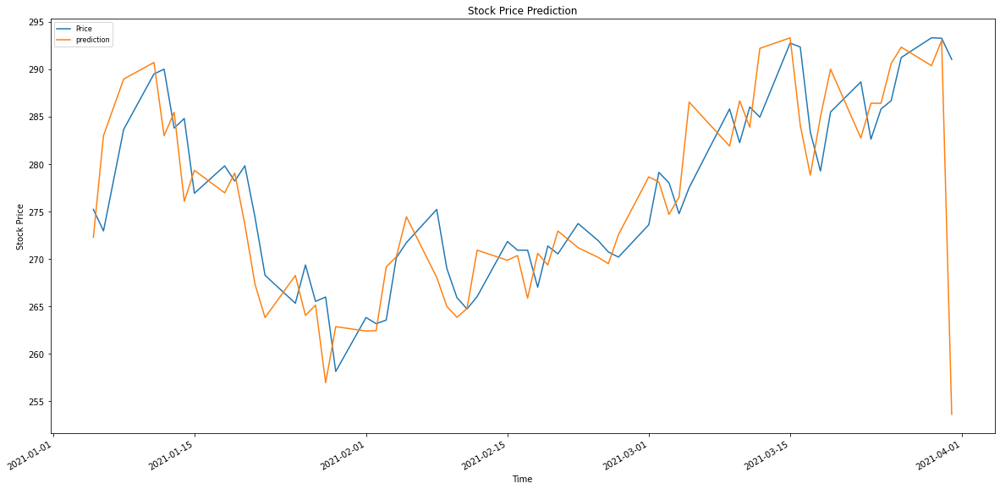

(0.015110203511727748, 6.544637360680949)

In [362]:
#plot predictions
actual_vs_pred_plot(best_GRU_prediction) 

Looks much better than the last results either for LSTM for its both approaches or the GRU model.      
#### * So our model is accurate 98.5%.

### Bollinger bands

#### What is Bolliger bands?

Bollinger Bands are a tool introduced by the quantitative trader John Bollinger in the 1980s. They are made by two lines that wrap the price time series in a way that is related to volatility. The higher the volatility, the wider the bands.
They are usually drawn in this way:

* Higher band: a 20-period Simple Moving Average plus 2 times the 20-period rolling standard deviation, both calculated on the close price
* Lower band: a 20-period Simple Moving Average minus 2 times the 20-period rolling standard deviation, both calculated on the close price

#### What are the parameters of Bolliger bands?    

Bollinger Bands have 2 parameters:  
    1- the period of the moving average and of the standard deviation (which is the same)       
    2- the multiplier of the standard deviation.

The 20-period SMA is often used to catch medium-term movements, so the value of 20 periods has been chosen empirically.     
About The multiplier of the standard deviation, according to the normal distribution, there is a probability of nearly 95% that the value of a normal variable is more than 2 standard deviations far from the mean value. That’s where the 2 number comes from.

John Bollinger himself suggests using a slightly different set of parameters, changing the multiplier and the period according to some particular situations.
Nevertheless, the 20–2 combination is widely considered almost like a standard in trading.

In [796]:
df_bands=train_lstm[['Price','Open']]

In [799]:
period = 20
multiplier = 2

In [800]:
df_bands['UpperBand'] = df_bands['Price'].rolling(period).mean() + df_bands['Price'].rolling(period).std() * multiplier
df_bands['LowerBand'] = df_bands['Price'].rolling(period).mean() - df_bands['Price'].rolling(period).std() * multiplier

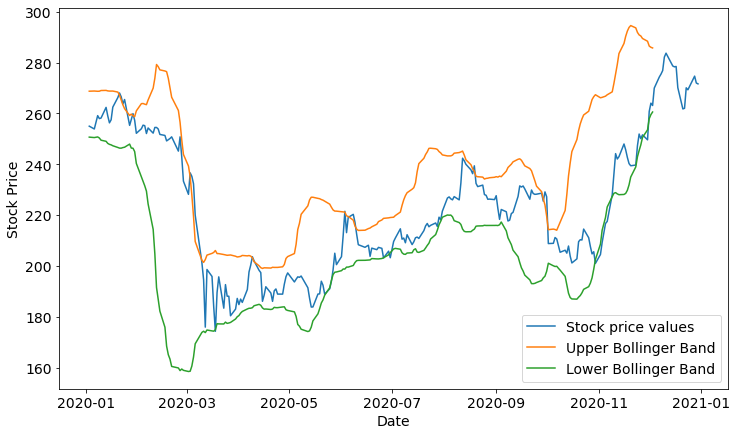

In [804]:
plt.rcParams['figure.figsize'] = [12, 7]

plt.rc('font', size=14)

plt.plot(df_bands['Price'], label = "Stock price values")
plt.plot(df_bands['UpperBand'], label = "Upper Bollinger Band")
plt.plot(df_bands['LowerBand'], label = "Lower Bollinger Band")

plt.xlabel('Date')
plt.ylabel('Stock Price')
plt.legend()
plt.show()

As we can see, the bands wrap the price just like expected.

### Comparision: 

From all the results above, we can notice that **ARIMAX** was the accurat model with an MAPE=0.009074110787921856.    
We can see clearly that in this task, statistic models outperform Deep learning models. Maybe we can explain this by the lack of dataset, as we have few rows of data, however deep learning models require large amount of data.
Also, there are many cases that statistic models or even machine learning models outperform neural networks. This improve that a clever data scientist must choose the right model that gives best results, not only using deep learning models for all cases. 

### 5. Build recommender system

In [364]:
y_train_pred=best_gru_regressor.predict(X_train)
y_train_pred = sc.inverse_transform(y_train_pred)

8/8 [==============================] - 0s 27ms/step


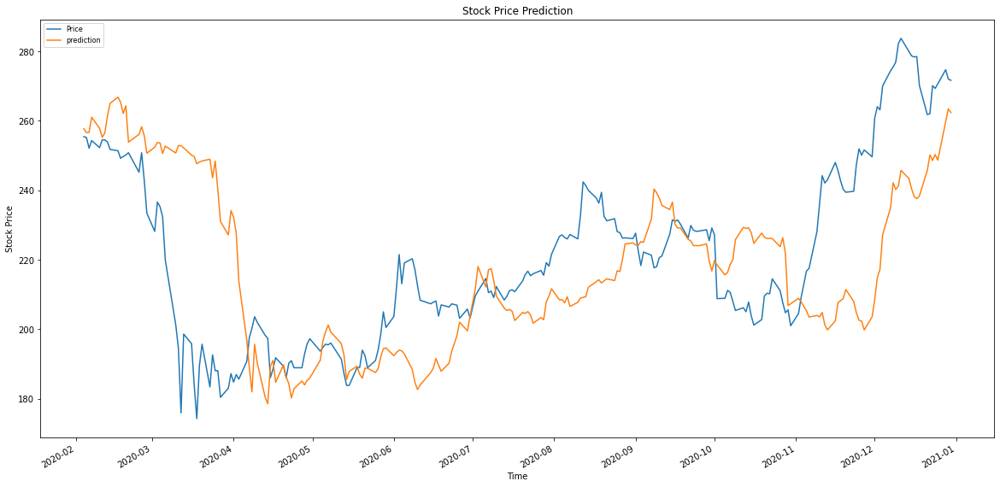

(0.08510074078207398, 24.940498125044137)

In [365]:
#plot predictions
actual_vs_pred_plot(y_train_pred, train_lstm)  

In [366]:
label_stocks = pd.DataFrame(columns = ['real', 'gru_pred','label'])
label_stocks['real'] = train_lstm.iloc[:,0:1].iloc[0:len(y_train_pred)]
label_stocks['gru_pred'] = y_train_pred[:,0]

In [367]:
label_stocks=label_stocks.sort_values(by='Date') 
label_stocks.head(5)

,real,gru_pred,label
Date,,,
2020-02-04,255.40,257.704102,NaN
2020-02-05,255.20,256.600494,NaN
2020-02-06,252.11,256.661377,NaN
2020-02-07,254.30,261.031158,NaN
2020-02-10,252.26,257.837921,NaN


In [368]:
# 0 hold , 1 buy, 2 sell
if label_stocks['gru_pred'][0]> label_stocks['real'][0]:
    diff=1
else:
    diff=0

label_stocks["label"][0]='hold'
for i in range(1,label_stocks.shape[0]):
    if label_stocks['gru_pred'][i]< label_stocks['real'][i] and diff==1:
        label_stocks["label"][i]='sell'
        diff=0
    elif label_stocks['gru_pred'][i]> label_stocks['real'][i] and diff==0:
        label_stocks["label"][i]='buy'
        diff=1
        
    else:
        label_stocks["label"][i]='hold'


In [369]:
# recommendation of buy
label_stocks[label_stocks["label"]=='buy']

,real,gru_pred,label
Date,,,
2020-04-15,186.07,189.354858,buy
2020-04-20,189.32,189.732513,buy
2020-05-05,194.75,196.655670,buy
2020-06-30,203.22,203.788742,buy
2020-07-07,210.53,217.087051,buy
2020-09-02,222.57,224.148224,buy
2020-10-02,208.80,218.495743,buy


In [370]:
# recommendation of sell
label_stocks[label_stocks["label"]=='sell']

,real,gru_pred,label
Date,,,
2020-04-07,197.63,188.814163,sell
2020-04-17,191.80,184.711212,sell
2020-04-22,190.20,184.370361,sell
2020-05-19,189.00,187.014633,sell
2020-07-06,214.61,212.178574,sell
2020-07-10,212.28,209.524826,sell
2020-09-16,231.06,230.209244,sell
2020-11-03,209.20,207.874939,sell


### Data analysis

In [371]:
label_stocks.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 229 entries, 2020-02-04 to 2020-12-30
Data columns (total 3 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   real      229 non-null    float64
 1   gru_pred  229 non-null    float32
 2   label     229 non-null    object 
dtypes: float32(1), float64(1), object(1)
memory usage: 6.3+ KB


In [372]:
label_stocks.describe()

,real,gru_pred
count,229.00000,229.000000
mean,220.98476,218.006607
std,25.62101,23.359766
min,174.27000,178.536011
25%,202.78000,201.232285
50%,216.71000,214.074173
75%,237.80000,235.637924
max,283.73000,266.795288


In [942]:
y=label_stocks['label']

In [944]:
# Encoding categorical data
labelencoder = LabelEncoder()
Y = labelencoder.fit_transform(y) 

<AxesSubplot:ylabel='count'>

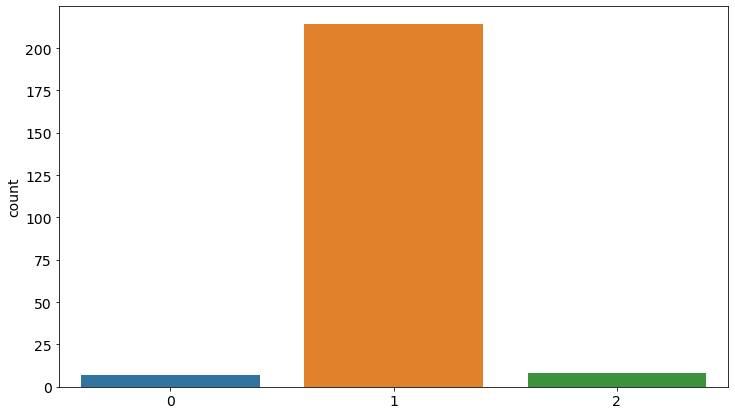

In [922]:
sns.countplot(Y)

As we can see, the dataset is highly imbalanced, so we need to balance it with SMOTE technique

In [923]:
#define X data
X = label_stocks['gru_pred']

### Handling Imbalanced Dataset
Smote helps in oversampling the examples in the minority class. The process involved in oversampling is given as:

1- Select random data from the minority class.    
2- Calculate the Euclidean distance between the random data and its k nearest neighbors.     
3- Multiply the difference with a random number between 0 and 1. Then, add the result to the minority class as a synthetic sample.      
4- Repeat the procedure until the expected proportion of minority class is met.

For our case, I choose to use SMOTE-Tomek Links. This is a modified version of SMOTE. It combines the ability of both SMOTE and Tomek Links. SMOTE is capable of generating synthetic data for minority class. And, Tomek Links is able to remove the data that are identified as Tomek links from the majority class.

In [939]:
# Define SMOTE-Tomek Links
resample=SMOTETomek(tomek=TomekLinks(sampling_strategy='majority'))# resample only the majority class
x, y = resample.fit_resample(X.values.reshape(-1, 1), Y)

<AxesSubplot:ylabel='count'>

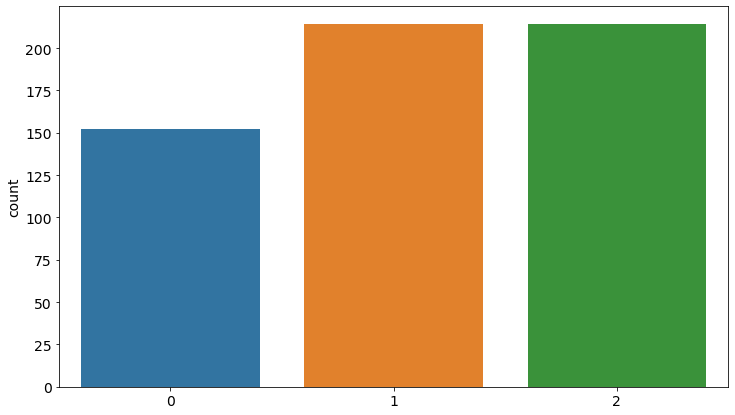

In [940]:
sns.countplot(y)

### Splitting data
The dataset can be split into training set and validation set. We will use the training set for training our model. Validation set will be used to check whether our model can perform well on new, unseen data.

In [933]:
train_x, val_x,train_y, val_y = train_test_split(x,y,test_size=0.2,random_state=1)

In [382]:
#no need, this is in case of NN
#y_train_cat=to_categorical(train_y)
#y_val_cat=to_categorical(val_y)

### Building recomender system using Multiclass Classification with Random Forest Classifier

In [934]:
#TEST with simple rf model
#training
rfc = RandomForestClassifier(n_estimators=200,random_state=1)
rfc.fit(train_x,train_y )
#evaluation
rfc_predict = rfc.predict(val_x)
print('Accuracy score:',accuracy_score(val_y, rfc_predict))

Accuracy score: 0.4883720930232558


In [522]:
print('Parameters currently in use with randomforest:\n')
pprint(rfc.get_params())

Parameters currently in use with randomforest:

{'bootstrap': True,
 'ccp_alpha': 0.0,
 'class_weight': None,
 'criterion': 'gini',
 'max_depth': None,
 'max_features': 'auto',
 'max_leaf_nodes': None,
 'max_samples': None,
 'min_impurity_decrease': 0.0,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'min_weight_fraction_leaf': 0.0,
 'n_estimators': 200,
 'n_jobs': None,
 'oob_score': False,
 'random_state': 1,
 'verbose': 0,
 'warm_start': False}


In [523]:
cm = confusion_matrix(val_y, rfc_predict)

In [524]:
# Creating a dataframe for a array-formatted Confusion matrix,so it will be easy for plotting.
cm_df = pd.DataFrame(cm,
                     index = ['buy','sell','hold'], 
                     columns = ['buy','sell','hold'])

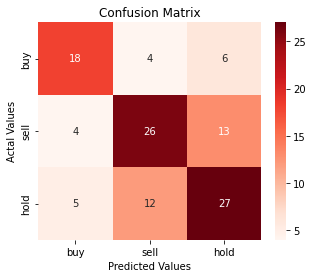

In [525]:
#Plotting the confusion matrix
plt.figure(figsize=(5,4))
sns.heatmap(cm_df, annot=True,cmap = 'Reds')
plt.title('Confusion Matrix of RF without optimization')
plt.ylabel('Actal Values')
plt.xlabel('Predicted Values')
plt.show()

## Hyperparam optimization using hyperopt

We will use three hyperparameters of the Random Forest algorithm which are n_estimators,max_depth, and criterion.

In [613]:
seed=100
def obj_rf(params):
    est=int(params['n_estimators'])
    md=int(params['max_depth'])
    msl=int(params['min_samples_leaf'])
    mss=int(params['min_samples_split'])
    model_rf=RandomForestClassifier(n_estimators=est,max_depth=md,min_samples_leaf=msl,min_samples_split=mss,random_state=seed)
    model_rf.fit(train_x,train_y)
    pred=model_rf.predict(val_x)   
    acc = accuracy_score(val_y, pred)
    return -acc

In [614]:
def optimize(trial):
    params={'n_estimators':hp.uniform('n_estimators',100,500),
           'max_depth':hp.uniform('max_depth',5,20),
           'min_samples_leaf':hp.uniform('min_samples_leaf',1,5),
           'min_samples_split':hp.uniform('min_samples_split',2,6)}
    best=fmin(fn=obj_rf,space=params,algo=tpe.suggest,trials=trial,max_evals=500,rstate=np.random.default_rng(seed))
    return best

In [615]:
def optimize_quni(trial):
    params={'n_estimators':hp.quniform("n_estimators",100,500,1),
           'max_depth':hp.quniform('max_depth',5,20,1),
           'min_samples_leaf':hp.quniform('min_samples_leaf',1,5,1),
           'min_samples_split':hp.quniform('min_samples_split',2,6,1)}
    best=fmin(fn=obj_rf,space=params,algo=tpe.suggest,trials=trial,max_evals=500,rstate=np.random.default_rng(seed))
    return best

In [616]:
trial_rf=Trials()
best_rf=optimize_quni(trial_rf)

100%|█████████████████████████████████████████████| 500/500 [05:15<00:00,  1.59trial/s, best loss: -0.6782608695652174]


In [617]:
print('best params of the randomforest model after hyperopt optimization are:\n',best_rf)

best params of the randomforest model after hyperopt optimization are:
 {'max_depth': 7.0, 'min_samples_leaf': 5.0, 'min_samples_split': 5.0, 'n_estimators': 141.0}


We can see how hyperopt makes the parameters approach some value as tid increases. This is done to minimize the loss.

In [618]:
TID=[t['tid'] for t in trial_rf.trials]
Loss=[t['result']['loss'] for t in trial_rf.trials]
maxd=[t['misc']['vals']['max_depth'][0] for t in trial_rf.trials]
nest=[t['misc']['vals']['n_estimators'][0] for t in trial_rf.trials]
min_ss=[t['misc']['vals']['min_samples_split'][0] for t in trial_rf.trials]
min_sl=[t['misc']['vals']['min_samples_leaf'][0] for t in trial_rf.trials]

hyperopt_rf=pd.DataFrame({'tid':TID,'loss':Loss,
                          'max_depth':maxd,'n_estimators':nest,
                          'min_samples_split':min_ss, 'min_samples_leaf':min_sl})

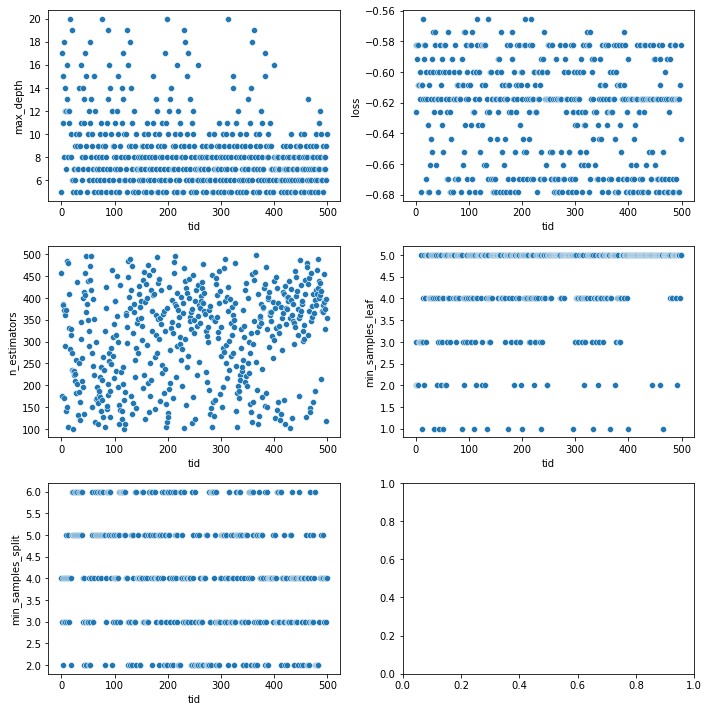

In [619]:
plt.subplots(3,2,figsize=(10,10))
plt.subplot(3,2,1)
sns.scatterplot(x='tid',y='max_depth',data=hyperopt_rf)
plt.subplot(3,2,2)
sns.scatterplot(x='tid',y='loss',data=hyperopt_rf)
plt.subplot(3,2,3)
sns.scatterplot(x='tid',y='n_estimators',data=hyperopt_rf)
plt.subplot(3,2,4)
sns.scatterplot(x='tid',y='min_samples_leaf',data=hyperopt_rf)
plt.subplot(3,2,5)
sns.scatterplot(x='tid',y='min_samples_split',data=hyperopt_rf)
plt.title('Hyperopt approach to tune hyperparams for RandomForest')
plt.tight_layout()

* ### best accuracy with RF after hyper param optimization is :acc= 0.6956521739130435

# whith xgboost

In [574]:
seed=1
def obj_xgb(params):
    est=int(params['n_estimators'])
    md=int(params['max_depth'])
    learning=params['learning_rate']  
    model=xgb.XGBClassifier(n_estimators=est,max_depth=md,learning_rate=learning,random_state=seed)
    model.fit(train_x,train_y)
    pred=model.predict(val_x)
    acc = accuracy_score(val_y, pred)
    return -acc

In [575]:
def optimize_xgb(trial):
    params={'n_estimators':hp.quniform("n_estimators",100,500,1),
           'max_depth':hp.quniform('max_depth',5,20,1),
           'learning_rate':hp.uniform('learning_rate',0.01,0.1)}
    best_xg=fmin(fn=obj_xgb,space=params,algo=tpe.suggest,trials=trial,max_evals=500,rstate=np.random.default_rng(seed))
    return best_xg

In [576]:
trial_xgb=Trials()
best_xgb=optimize_xgb(trial_xgb)

100%|█████████████████████████████████████████████| 500/500 [05:44<00:00,  1.45trial/s, best loss: -0.6260869565217392]


In [577]:
trial_xgb.results

[{'loss': -0.6173913043478261, 'status': 'ok'},
 {'loss': -0.6086956521739131, 'status': 'ok'},
 {'loss': -0.6086956521739131, 'status': 'ok'},
 {'loss': -0.6, 'status': 'ok'},
 {'loss': -0.5826086956521739, 'status': 'ok'},
 {'loss': -0.591304347826087, 'status': 'ok'},
 {'loss': -0.6173913043478261, 'status': 'ok'},
 {'loss': -0.6, 'status': 'ok'},
 {'loss': -0.6173913043478261, 'status': 'ok'},
 {'loss': -0.6260869565217392, 'status': 'ok'},
 {'loss': -0.6173913043478261, 'status': 'ok'},
 {'loss': -0.6, 'status': 'ok'},
 {'loss': -0.591304347826087, 'status': 'ok'},
 {'loss': -0.5826086956521739, 'status': 'ok'},
 {'loss': -0.6173913043478261, 'status': 'ok'},
 {'loss': -0.6086956521739131, 'status': 'ok'},
 {'loss': -0.6173913043478261, 'status': 'ok'},
 {'loss': -0.6173913043478261, 'status': 'ok'},
 {'loss': -0.6173913043478261, 'status': 'ok'},
 {'loss': -0.6173913043478261, 'status': 'ok'},
 {'loss': -0.6173913043478261, 'status': 'ok'},
 {'loss': -0.6173913043478261, 'status'

In [641]:
print('best params of the xgboost model after hyperopt optimization are:\n',best_xgb)

best params of the xgboost model after hyperopt optimization are:
 {'learning_rate': 0.09296809572486905, 'max_depth': 17.0, 'n_estimators': 141.0}


In [579]:
TID_xgb=[t['tid'] for t in trial_xgb.trials]
Loss_xg=[t['result']['loss'] for t in trial_xgb.trials]
maxd_xg=[t['misc']['vals']['max_depth'][0] for t in trial_xgb.trials]
nest_xg=[t['misc']['vals']['n_estimators'][0] for t in trial_xgb.trials]
lr_xg=[t['misc']['vals']['learning_rate'][0] for t in trial_xgb.trials]

hyperopt_xgb=pd.DataFrame({'tid':TID_xgb,'loss':Loss_xg,
                          'max_depth':maxd_xg,'n_estimators':nest_xg,
                          'learning_rate':lr_xg})

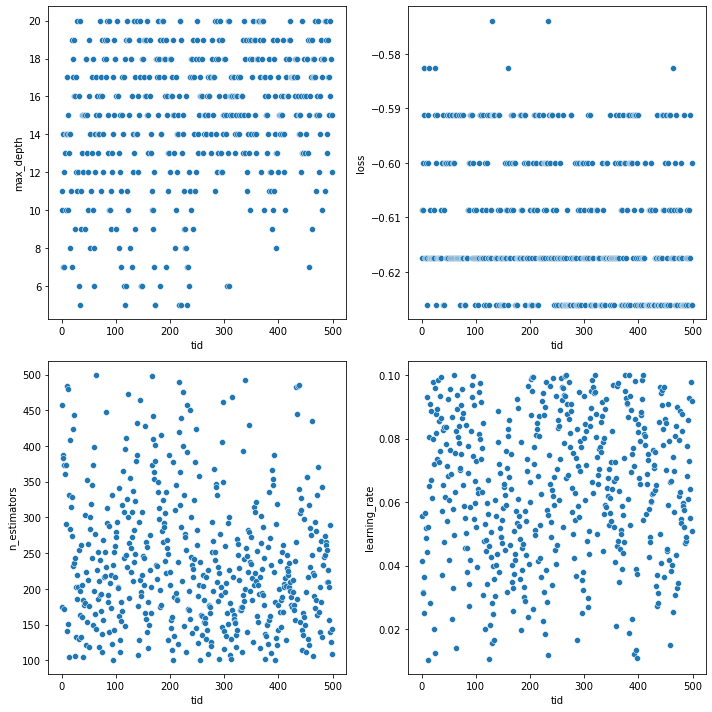

In [580]:
plt.subplots(2,2,figsize=(10,10))
plt.subplot(2,2,1)
sns.scatterplot(x='tid',y='max_depth',data=hyperopt_xgb)
plt.subplot(2,2,2)
sns.scatterplot(x='tid',y='loss',data=hyperopt_xgb)
plt.subplot(2,2,3)
sns.scatterplot(x='tid',y='n_estimators',data=hyperopt_xgb)
plt.subplot(2,2,4)
sns.scatterplot(x='tid',y='learning_rate',data=hyperopt_xgb)
plt.title('Hyperopt approach to tune hyperparams for XGboost')
plt.tight_layout()

## Lightgbm

The important parameters to tune for lightgbm model are:

Number of estimators    
Tree complexity - in lightgbm that is controlled by number of leaves (num_leaves)       
Learning rate       
Feature fraction

In [637]:
seed=1
def obj_lgbm(params):
    est=int(params['n_estimators'])
    numlv=int(params['num_leaves'])
    learning=params['learning_rate'] 
    colsample='{:.3f}'.format(params['colsample_bytree'])
    model=lgbm.LGBMClassifier(n_estimators=est,num_leaves=numlv,colsample_bytree=colsample, learning_rate=learning,random_state=seed)
    model.fit(train_x,train_y)
    pred=model.predict(val_x)
    acc = accuracy_score(val_y, pred)
    return -acc

In [638]:
def optimize_lgbm(trial):
    params={'n_estimators':hp.quniform("n_estimators",100,600,1),
           'num_leaves': hp.quniform('num_leaves', 8, 128, 2),
            'colsample_bytree': hp.uniform('colsample_bytree', 0.3, 1.0),
           'learning_rate':hp.uniform('learning_rate',0.01,0.1)}
    best_xg=fmin(fn=obj_lgbm,space=params,algo=tpe.suggest,trials=trial,max_evals=400,rstate=np.random.default_rng(seed))
    return best_xg

In [639]:
trial_lgbm=Trials()
best_lgbm=optimize_lgbm(trial_lgbm)

100%|█████████████████████████████████████████████| 400/400 [02:10<00:00,  3.07trial/s, best loss: -0.6869565217391305]


In [640]:
print('best params of the lightgbm model after hyperopt optimization are:\n',best_lgbm)

best params of the lightgbm model after hyperopt optimization are:
 {'colsample_bytree': 0.6751135460878382, 'learning_rate': 0.016693356602951882, 'n_estimators': 101.0, 'num_leaves': 114.0}


## Catboost
One of CatBoost’s core edges is its ability to integrate a variety of different data types, such as images, audio, or text features into one framework.       
It is hable to handl categorical data, requiring a minimum of categorical feature transformation, opposed to the majority of other machine learning algorithms, that cannot handle non-numeric values. 
CatBoost builds upon the theory of decision trees and gradient boosting.     
* Gradient boosting fits the decision trees sequentially, the fitted trees will learn from the mistakes of former trees and hence reduce the errors. This process of adding a new function to existing ones is continued until the selected loss function is no longer minimized.
* Instead, CatBoost grows oblivious trees, which means that the trees are grown by imposing the rule that all nodes at the same level, test the same predictor with the same condition, **and hence an index of a leaf can be calculated with bitwise operations.**

In [651]:
#combining features and target variables into a train and test dataset.
D_train = cb.Pool(train_x,train_y)
D_test = cb.Pool(val_x,val_y)

Hyperparameter to tune:    
* Depth: depth of trees(Tree complexity). In most cases, the optimal depth ranges from 4 to 10. Values in the range from 6 to 10 are recommended. 
* l2_leaf_reg: it tries different values for the L2 regularizer to find the best possible.
* Learning rate : This setting is used for reducing the gradient step. It affects the overall time of training: the smaller the value, the more iterations are required for training. If there is no overfitting on the last iterations of training then it's better to increase the learning rate. If an Overfitting is detected, then decrease the learning rate.
* Iteration: Number of trees




In [661]:
seed=1
def obj_cat(params):
    dpt=int(params['depth'])
    l2=int(params['l2_leaf_reg'])
    learning=params['learning_rate'] 
    itera=params['iterations']
    model=cb.CatBoostClassifier(iterations=itera,learning_rate=learning,depth=dpt, l2_leaf_reg=l2,random_state=seed)
    model.fit(D_train,verbose=False)
    pred=model.predict(val_x)
    acc = accuracy_score(val_y, pred)
    return -acc

In [662]:
def optimize_cat(trial):
    params={'iterations':hp.quniform("iterations",100,800,10),
           'depth':hp.quniform("depth", 1, 6, 1),
           'learning_rate':hp.uniform('learning_rate',0.03,0.1),
           'l2_leaf_reg': hp.uniform('l2_leaf_reg', 2, 8)}
    best_cat=fmin(fn=obj_cat,space=params,algo=tpe.suggest,trials=trial,max_evals=500,rstate=np.random.default_rng(seed))
    return best_cat

In [663]:
trial_cat=Trials()
best_cat=optimize_cat(trial_cat)

100%|█████████████████████████████████████████████| 500/500 [09:04<00:00,  1.09s/trial, best loss: -0.6869565217391305]


In [664]:
print('best params of the catboost model after hyperopt optimization are:\n',best_cat)

best params of the catboost model after hyperopt optimization are:
 {'depth': 6.0, 'iterations': 290.0, 'l2_leaf_reg': 4.314313792713666, 'learning_rate': 0.03857978462659196}


## Comparision between models

### 1- RandomForest

In [665]:
#RForest
rf_opt=RandomForestClassifier(max_depth=7, min_samples_leaf= 5,min_samples_split= 5, n_estimators=141,random_state=100)
rf_opt.fit(train_x,train_y)
pred_rf_opt=rf_opt.predict(val_x)
rf_acc_opt=accuracy_score(val_y, pred_rf_opt)
print("The accuracy of RandomForest model is:",rf_acc_opt)

The accuracy of RandomForest model is: 0.6782608695652174


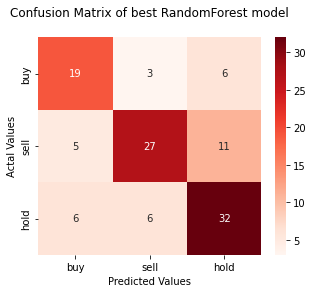

In [667]:
cm_rf_opt = confusion_matrix(val_y, pred_rf_opt)
# Creating a dataframe for a array-formatted Confusion matrix,so it will be easy for plotting.
cm_rf_opt_df = pd.DataFrame(cm_rf_opt,
                     index = ['buy','sell','hold'], 
                     columns = ['buy','sell','hold'])
#Plotting the confusion matrix
plt.figure(figsize=(5,4))
sns.heatmap(cm_rf_opt_df, annot=True,cmap = 'Reds')
plt.title('Confusion Matrix of best RandomForest model\n')
plt.ylabel('Actal Values')
plt.xlabel('Predicted Values')
plt.show()

In [727]:
print('classification_report of the best RandomForest:\n\n', classification_report(val_y, pred_rf_opt,digits=4))

classification_report of the best RandomForest:

               precision    recall  f1-score   support

           0     0.6333    0.6786    0.6552        28
           1     0.7500    0.6279    0.6835        43
           2     0.6531    0.7273    0.6882        44

    accuracy                         0.6783       115
   macro avg     0.6788    0.6779    0.6756       115
weighted avg     0.6845    0.6783    0.6784       115



### 2- XGBoost

In [677]:
#XGB
xgb_opt=xgb.XGBClassifier(n_estimators=141,max_depth=17,learning_rate=0.0929,random_state=1)
xgb_opt.fit(train_x,train_y)
pred_xgb_opt=xgb_opt.predict(val_x)
xgb_acc_opt=accuracy_score(val_y, pred_xgb_opt)
print("The accuracy of XGBOOST model is:",xgb_acc_opt)

The accuracy of XGBOOST model is: 0.6260869565217392


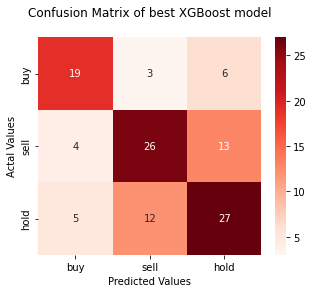

In [678]:
cm_xgb_opt = confusion_matrix(val_y, pred_xgb_opt)
# Creating a dataframe for a array-formatted Confusion matrix,so it will be easy for plotting.
cm_xgb_opt_df = pd.DataFrame(cm_xgb_opt,
                     index = ['buy','sell','hold'], 
                     columns = ['buy','sell','hold'])
#Plotting the confusion matrix
plt.figure(figsize=(5,4))
sns.heatmap(cm_xgb_opt_df, annot=True,cmap = 'Reds')
plt.title('Confusion Matrix of best XGBoost model\n')
plt.ylabel('Actal Values')
plt.xlabel('Predicted Values')
plt.show()

In [728]:
print('classification_report of the best RandomForest:\n\n', classification_report(val_y, pred_xgb_opt,digits=4))

classification_report of the best RandomForest:

               precision    recall  f1-score   support

           0     0.6786    0.6786    0.6786        28
           1     0.6341    0.6047    0.6190        43
           2     0.5870    0.6136    0.6000        44

    accuracy                         0.6261       115
   macro avg     0.6332    0.6323    0.6325       115
weighted avg     0.6269    0.6261    0.6263       115



### 3- LightGBM

In [679]:
#LGBM 
lgbm_opt=lgbm.LGBMClassifier(n_estimators=101,learning_rate=0.016,colsample_bytree= 0.675,num_leaves= 114,random_state=1)
lgbm_opt.fit(train_x,train_y)
pred_lgbm_opt=lgbm_opt.predict(val_x)
lgbm_acc_opt=accuracy_score(val_y, pred_lgbm_opt)
print("The accuracy of LGBM model is:",lgbm_acc_opt)

The accuracy of LGBM model is: 0.6869565217391305


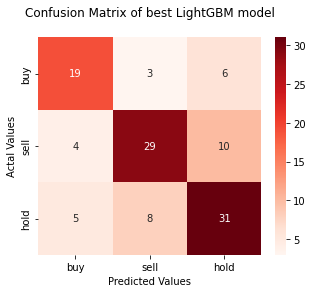

In [680]:
cm_lgbm_opt = confusion_matrix(val_y, pred_lgbm_opt)
# Creating a dataframe for a array-formatted Confusion matrix,so it will be easy for plotting.
cm_lgbm_opt_df = pd.DataFrame(cm_lgbm_opt,
                     index = ['buy','sell','hold'], 
                     columns = ['buy','sell','hold'])
#Plotting the confusion matrix
plt.figure(figsize=(5,4))
sns.heatmap(cm_lgbm_opt_df, annot=True,cmap = 'Reds')
plt.title('Confusion Matrix of best LightGBM model\n')
plt.ylabel('Actal Values')
plt.xlabel('Predicted Values')
plt.show()

In [729]:
print('classification_report of the best RandomForest:\n\n', classification_report(val_y, pred_lgbm_opt,digits=4))

classification_report of the best RandomForest:

               precision    recall  f1-score   support

           0     0.6786    0.6786    0.6786        28
           1     0.7250    0.6744    0.6988        43
           2     0.6596    0.7045    0.6813        44

    accuracy                         0.6870       115
   macro avg     0.6877    0.6858    0.6862       115
weighted avg     0.6887    0.6870    0.6872       115



### 4- CatBoost

In [681]:
#Catboost
cat_opt=cb.CatBoostClassifier(iterations=290,learning_rate=0.038,depth=6, l2_leaf_reg=4.314,random_state=1)
cat_opt.fit(D_train,verbose=False)
pred_cat_opt=cat_opt.predict(val_x)
cat_acc_opt=accuracy_score(val_y, pred_cat_opt)
print("The accuracy of Catboost model is:",cat_acc_opt)

The accuracy of Catboost model is: 0.6695652173913044


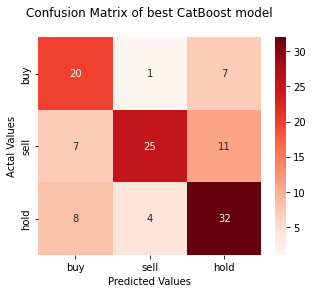

In [682]:
cm_cat_opt = confusion_matrix(val_y, pred_cat_opt)
# Creating a dataframe for a array-formatted Confusion matrix,so it will be easy for plotting.
cm_cat_opt_df = pd.DataFrame(cm_cat_opt,
                     index = ['buy','sell','hold'], 
                     columns = ['buy','sell','hold'])
#Plotting the confusion matrix
plt.figure(figsize=(5,4))
sns.heatmap(cm_cat_opt_df, annot=True,cmap = 'Reds')
plt.title('Confusion Matrix of best CatBoost model\n')
plt.ylabel('Actal Values')
plt.xlabel('Predicted Values')
plt.show()

In [730]:
print('classification_report of the best RandomForest:\n\n', classification_report(val_y, pred_cat_opt,digits=4))

classification_report of the best RandomForest:

               precision    recall  f1-score   support

           0     0.5714    0.7143    0.6349        28
           1     0.8333    0.5814    0.6849        43
           2     0.6400    0.7273    0.6809        44

    accuracy                         0.6696       115
   macro avg     0.6816    0.6743    0.6669       115
weighted avg     0.6956    0.6696    0.6712       115



### 5- Stacking method

In [763]:
stacking_model=StackingClassifier([('rf',rf_opt),('xgb',xgb_opt),('lgbm',lgbm_opt),('cat',cat_opt)],final_estimator=xgb_opt)

In [764]:
stacking_model.fit(train_x,train_y)
pred_stack=stacking_model.predict(val_x)
stack_ac=accuracy_score(val_y, pred_stack)

0:	learn: 1.0869951	total: 3.26ms	remaining: 942ms
1:	learn: 1.0746927	total: 5.84ms	remaining: 841ms
2:	learn: 1.0629000	total: 8.36ms	remaining: 800ms
3:	learn: 1.0519733	total: 11.1ms	remaining: 792ms
4:	learn: 1.0403472	total: 13.6ms	remaining: 776ms
5:	learn: 1.0319462	total: 16.2ms	remaining: 765ms
6:	learn: 1.0245684	total: 18.7ms	remaining: 757ms
7:	learn: 1.0150343	total: 21.2ms	remaining: 748ms
8:	learn: 1.0074803	total: 23.7ms	remaining: 739ms
9:	learn: 1.0006659	total: 26.1ms	remaining: 731ms
10:	learn: 0.9923173	total: 28.7ms	remaining: 729ms
11:	learn: 0.9862753	total: 31.3ms	remaining: 725ms
12:	learn: 0.9805819	total: 33.7ms	remaining: 719ms
13:	learn: 0.9754166	total: 36.3ms	remaining: 715ms
14:	learn: 0.9696498	total: 38.4ms	remaining: 704ms
15:	learn: 0.9626907	total: 40.6ms	remaining: 695ms
16:	learn: 0.9568759	total: 42.7ms	remaining: 685ms
17:	learn: 0.9527041	total: 45.2ms	remaining: 682ms
18:	learn: 0.9483037	total: 47.7ms	remaining: 680ms
19:	learn: 0.9437820	t

204:	learn: 0.7540941	total: 487ms	remaining: 202ms
205:	learn: 0.7536512	total: 489ms	remaining: 199ms
206:	learn: 0.7533743	total: 492ms	remaining: 197ms
207:	learn: 0.7529144	total: 494ms	remaining: 195ms
208:	learn: 0.7527234	total: 496ms	remaining: 192ms
209:	learn: 0.7523590	total: 499ms	remaining: 190ms
210:	learn: 0.7520852	total: 501ms	remaining: 188ms
211:	learn: 0.7516751	total: 504ms	remaining: 185ms
212:	learn: 0.7512784	total: 506ms	remaining: 183ms
213:	learn: 0.7508364	total: 508ms	remaining: 181ms
214:	learn: 0.7502402	total: 511ms	remaining: 178ms
215:	learn: 0.7494424	total: 513ms	remaining: 176ms
216:	learn: 0.7490968	total: 516ms	remaining: 173ms
217:	learn: 0.7484695	total: 518ms	remaining: 171ms
218:	learn: 0.7479596	total: 521ms	remaining: 169ms
219:	learn: 0.7473916	total: 525ms	remaining: 167ms
220:	learn: 0.7468663	total: 527ms	remaining: 164ms
221:	learn: 0.7465849	total: 529ms	remaining: 162ms
222:	learn: 0.7460993	total: 531ms	remaining: 160ms
223:	learn: 

137:	learn: 0.7778197	total: 317ms	remaining: 349ms
138:	learn: 0.7773523	total: 319ms	remaining: 347ms
139:	learn: 0.7769103	total: 322ms	remaining: 345ms
140:	learn: 0.7765574	total: 324ms	remaining: 343ms
141:	learn: 0.7758298	total: 327ms	remaining: 340ms
142:	learn: 0.7756086	total: 329ms	remaining: 338ms
143:	learn: 0.7750253	total: 332ms	remaining: 336ms
144:	learn: 0.7744124	total: 334ms	remaining: 334ms
145:	learn: 0.7739331	total: 336ms	remaining: 332ms
146:	learn: 0.7730135	total: 339ms	remaining: 330ms
147:	learn: 0.7725822	total: 341ms	remaining: 327ms
148:	learn: 0.7722581	total: 343ms	remaining: 325ms
149:	learn: 0.7717543	total: 346ms	remaining: 323ms
150:	learn: 0.7713088	total: 349ms	remaining: 321ms
151:	learn: 0.7704885	total: 351ms	remaining: 319ms
152:	learn: 0.7698938	total: 354ms	remaining: 317ms
153:	learn: 0.7695449	total: 356ms	remaining: 314ms
154:	learn: 0.7689773	total: 358ms	remaining: 312ms
155:	learn: 0.7686886	total: 361ms	remaining: 310ms
156:	learn: 

76:	learn: 0.8112896	total: 178ms	remaining: 492ms
77:	learn: 0.8100858	total: 181ms	remaining: 491ms
78:	learn: 0.8091930	total: 183ms	remaining: 488ms
79:	learn: 0.8083261	total: 185ms	remaining: 486ms
80:	learn: 0.8076796	total: 187ms	remaining: 483ms
81:	learn: 0.8065854	total: 190ms	remaining: 481ms
82:	learn: 0.8057331	total: 192ms	remaining: 479ms
83:	learn: 0.8047773	total: 194ms	remaining: 477ms
84:	learn: 0.8038370	total: 197ms	remaining: 475ms
85:	learn: 0.8026390	total: 199ms	remaining: 473ms
86:	learn: 0.8018883	total: 202ms	remaining: 470ms
87:	learn: 0.8012261	total: 204ms	remaining: 468ms
88:	learn: 0.8004359	total: 206ms	remaining: 466ms
89:	learn: 0.7999571	total: 209ms	remaining: 464ms
90:	learn: 0.7986097	total: 212ms	remaining: 464ms
91:	learn: 0.7981641	total: 215ms	remaining: 462ms
92:	learn: 0.7972386	total: 217ms	remaining: 460ms
93:	learn: 0.7960517	total: 220ms	remaining: 458ms
94:	learn: 0.7954239	total: 222ms	remaining: 455ms
95:	learn: 0.7949038	total: 225

282:	learn: 0.7045715	total: 659ms	remaining: 16.3ms
283:	learn: 0.7038826	total: 662ms	remaining: 14ms
284:	learn: 0.7034930	total: 664ms	remaining: 11.7ms
285:	learn: 0.7030472	total: 666ms	remaining: 9.32ms
286:	learn: 0.7026080	total: 669ms	remaining: 6.99ms
287:	learn: 0.7023596	total: 671ms	remaining: 4.66ms
288:	learn: 0.7019148	total: 674ms	remaining: 2.33ms
289:	learn: 0.7012855	total: 676ms	remaining: 0us
0:	learn: 1.0860822	total: 8.43ms	remaining: 2.44s
1:	learn: 1.0749060	total: 16ms	remaining: 2.3s
2:	learn: 1.0629239	total: 22.1ms	remaining: 2.12s
3:	learn: 1.0521390	total: 26.9ms	remaining: 1.93s
4:	learn: 1.0402103	total: 29.5ms	remaining: 1.68s
5:	learn: 1.0306813	total: 32.1ms	remaining: 1.52s
6:	learn: 1.0236451	total: 34.7ms	remaining: 1.4s
7:	learn: 1.0150906	total: 37.6ms	remaining: 1.32s
8:	learn: 1.0071158	total: 41.2ms	remaining: 1.28s
9:	learn: 1.0006047	total: 43.7ms	remaining: 1.22s
10:	learn: 0.9940813	total: 45.8ms	remaining: 1.16s
11:	learn: 0.9879716	to

198:	learn: 0.7634246	total: 480ms	remaining: 220ms
199:	learn: 0.7630191	total: 483ms	remaining: 217ms
200:	learn: 0.7622045	total: 485ms	remaining: 215ms
201:	learn: 0.7615666	total: 488ms	remaining: 212ms
202:	learn: 0.7611326	total: 490ms	remaining: 210ms
203:	learn: 0.7606630	total: 492ms	remaining: 208ms
204:	learn: 0.7601785	total: 495ms	remaining: 205ms
205:	learn: 0.7595075	total: 497ms	remaining: 203ms
206:	learn: 0.7592294	total: 500ms	remaining: 200ms
207:	learn: 0.7584473	total: 502ms	remaining: 198ms
208:	learn: 0.7579585	total: 504ms	remaining: 196ms
209:	learn: 0.7571960	total: 507ms	remaining: 193ms
210:	learn: 0.7565801	total: 509ms	remaining: 191ms
211:	learn: 0.7561641	total: 512ms	remaining: 188ms
212:	learn: 0.7555204	total: 514ms	remaining: 186ms
213:	learn: 0.7550587	total: 516ms	remaining: 183ms
214:	learn: 0.7547610	total: 519ms	remaining: 181ms
215:	learn: 0.7543762	total: 521ms	remaining: 179ms
216:	learn: 0.7538618	total: 523ms	remaining: 176ms
217:	learn: 

120:	learn: 0.8114682	total: 315ms	remaining: 440ms
121:	learn: 0.8109954	total: 318ms	remaining: 437ms
122:	learn: 0.8107399	total: 320ms	remaining: 435ms
123:	learn: 0.8100818	total: 322ms	remaining: 432ms
124:	learn: 0.8094679	total: 325ms	remaining: 429ms
125:	learn: 0.8091342	total: 327ms	remaining: 426ms
126:	learn: 0.8087211	total: 330ms	remaining: 423ms
127:	learn: 0.8081653	total: 332ms	remaining: 420ms
128:	learn: 0.8076091	total: 334ms	remaining: 417ms
129:	learn: 0.8067572	total: 336ms	remaining: 414ms
130:	learn: 0.8060287	total: 339ms	remaining: 411ms
131:	learn: 0.8056528	total: 341ms	remaining: 408ms
132:	learn: 0.8052681	total: 344ms	remaining: 406ms
133:	learn: 0.8042207	total: 346ms	remaining: 403ms
134:	learn: 0.8036053	total: 349ms	remaining: 401ms
135:	learn: 0.8030955	total: 352ms	remaining: 398ms
136:	learn: 0.8026162	total: 354ms	remaining: 396ms
137:	learn: 0.8020632	total: 357ms	remaining: 393ms
138:	learn: 0.8018403	total: 359ms	remaining: 390ms
139:	learn: 

282:	learn: 0.7296265	total: 712ms	remaining: 17.6ms
283:	learn: 0.7292068	total: 715ms	remaining: 15.1ms
284:	learn: 0.7286677	total: 717ms	remaining: 12.6ms
285:	learn: 0.7280707	total: 720ms	remaining: 10.1ms
286:	learn: 0.7277038	total: 722ms	remaining: 7.55ms
287:	learn: 0.7273738	total: 725ms	remaining: 5.03ms
288:	learn: 0.7268654	total: 727ms	remaining: 2.52ms
289:	learn: 0.7262302	total: 729ms	remaining: 0us
0:	learn: 1.0872536	total: 9.08ms	remaining: 2.62s
1:	learn: 1.0759392	total: 12ms	remaining: 1.73s
2:	learn: 1.0662810	total: 13.2ms	remaining: 1.26s
3:	learn: 1.0560453	total: 15.6ms	remaining: 1.12s
4:	learn: 1.0434158	total: 19.5ms	remaining: 1.11s
5:	learn: 1.0334005	total: 21.9ms	remaining: 1.03s
6:	learn: 1.0266015	total: 24.5ms	remaining: 991ms
7:	learn: 1.0197517	total: 27.2ms	remaining: 958ms
8:	learn: 1.0132240	total: 28ms	remaining: 873ms
9:	learn: 1.0058035	total: 30.4ms	remaining: 852ms
10:	learn: 0.9992360	total: 33.3ms	remaining: 845ms
11:	learn: 0.9926665	

200:	learn: 0.7543985	total: 484ms	remaining: 214ms
201:	learn: 0.7539991	total: 486ms	remaining: 212ms
202:	learn: 0.7535615	total: 489ms	remaining: 209ms
203:	learn: 0.7531858	total: 491ms	remaining: 207ms
204:	learn: 0.7529419	total: 493ms	remaining: 204ms
205:	learn: 0.7523620	total: 495ms	remaining: 202ms
206:	learn: 0.7516703	total: 498ms	remaining: 200ms
207:	learn: 0.7512384	total: 500ms	remaining: 197ms
208:	learn: 0.7507039	total: 502ms	remaining: 195ms
209:	learn: 0.7505461	total: 505ms	remaining: 192ms
210:	learn: 0.7502317	total: 507ms	remaining: 190ms
211:	learn: 0.7499147	total: 510ms	remaining: 187ms
212:	learn: 0.7494445	total: 512ms	remaining: 185ms
213:	learn: 0.7491583	total: 514ms	remaining: 183ms
214:	learn: 0.7486011	total: 517ms	remaining: 180ms
215:	learn: 0.7480940	total: 520ms	remaining: 178ms
216:	learn: 0.7476721	total: 523ms	remaining: 176ms
217:	learn: 0.7472127	total: 526ms	remaining: 174ms
218:	learn: 0.7467404	total: 528ms	remaining: 171ms
219:	learn: 

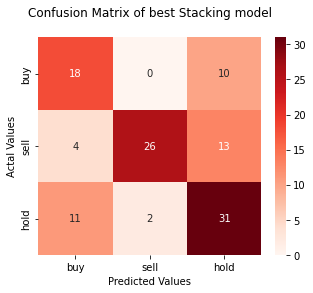

In [744]:
cm_stack = confusion_matrix(val_y, pred_stack)
# Creating a dataframe for a array-formatted Confusion matrix,so it will be easy for plotting.
cm_stack_df = pd.DataFrame(cm_stack,
                     index = ['buy','sell','hold'], 
                     columns = ['buy','sell','hold'])
#Plotting the confusion matrix
plt.figure(figsize=(5,4))
sns.heatmap(cm_stack_df, annot=True,cmap = 'Reds')
plt.title('Confusion Matrix of best Stacking model\n')
plt.ylabel('Actal Values')
plt.xlabel('Predicted Values')
plt.show()

In [735]:
print('classification_report of the best RandomForest:\n\n', classification_report(val_y, pred_stack,digits=4))

classification_report of the best RandomForest:

               precision    recall  f1-score   support

           0     0.5455    0.6429    0.5902        28
           1     0.9286    0.6047    0.7324        43
           2     0.5741    0.7045    0.6327        44

    accuracy                         0.6522       115
   macro avg     0.6827    0.6507    0.6517       115
weighted avg     0.6997    0.6522    0.6596       115



### Verdict 

In [743]:
print(colored("Comparision between RandomForest , XBGoost, LightGBM, CatBoost models \n",'green'))
print('-'*72)
print('model           |   Accuracy    |   Precision  |  recall   |   F1-score')
print('-'*72)
print("RandomForest    |    67.83 %    |    67.88 %   |   67.79 % |   67.56 % ")
print("XGBoost         |    62.61 %    |    63.32 %   |   63.23 % |   63.25 % ")
print("LightGBM        |    68.70 %    |    68.77 %   |   68.58 % |   68.62 % ")
print(colored("CatBoost        |    69.96 %    |    68.16 %   |   67.43 % |   66.69 % ",'yellow'))
print("Stacking        |    65.22 %    |    68.27 %   |   65.07 % |   65.17 % ")

Comparision between RandomForest , XBGoost, LightGBM, CatBoost models 

------------------------------------------------------------------------
model           |   Accuracy    |   Precision  |  recall   |   F1-score
------------------------------------------------------------------------
RandomForest    |    67.83 %    |    67.88 %   |   67.79 % |   67.56 % 
XGBoost         |    62.61 %    |    63.32 %   |   63.23 % |   63.25 % 
LightGBM        |    68.70 %    |    68.77 %   |   68.58 % |   68.62 % 
CatBoost        |    69.96 %    |    68.16 %   |   67.43 % |   66.69 % 
Stacking        |    65.22 %    |    68.27 %   |   65.07 % |   65.17 % 


In [782]:
print(colored("\t\t\tComparision between final estimators with stacking method \n",'green'))
print('-'*40 ,'\t\t','-'*40)
print('final estimator         |   Accuracy  \t\t\t  final estimator        |   Accuracy ')
print('-'*40 ,'\t\t','-'*40)
print(colored("Optimized RandomForest  |    65.22 %  ",'yellow'), "\t\t\t Normal RandomForest     |    61.74 % " )
print("Optimized XGBoost       |    60.87 % ",  "\t\t\t Normal XGBoost          |    60.87 % ")
print("Optimized LightGBM      |    57.39 % ",  "\t\t\t Normal LightGBM         |    60.00 % ")
print("Optimized CatBoost      |    59.13 % ",  "\t\t\t Normal CatBoost         |    57.39 % ")

			Comparision between final estimators with stacking method 

---------------------------------------- 		 ----------------------------------------
final estimator         |   Accuracy  			  final estimator        |   Accuracy 
---------------------------------------- 		 ----------------------------------------
Optimized RandomForest  |    65.22 %   			 Normal RandomForest     |    61.74 % 
Optimized XGBoost       |    60.87 %  			 Normal XGBoost          |    60.87 % 
Optimized LightGBM      |    57.39 %  			 Normal LightGBM         |    60.00 % 
Optimized CatBoost      |    59.13 %  			 Normal CatBoost         |    57.39 % 


## 6. Conclusion

To sum up, this project has for goal to forecast stock price market. 
The methodoly that I worked with was as followed:
* Read and explored the data
* Visulized data with multi plots techniques
* Preprocessed the data 
* Used 4 main models for the modeling part: 
* 2 statistical models(Arima and Arimax) 
* 2 deep learning models (LSTM and GRU). I also tunned their hyperparamters with two techniques (the classical one and using Hyperopt method)
* Compared forecasting results 
* Used Bollinguer Bands thecnique to visualize my forecasting prices 
* Build a recommender system to recommend to the company either to Buy, Sell or Hold actions.
* Labeled the data set based on the cross points in the forecasting plot
* Balanced the dataset using SmoteTomek method
* Used 4 tree based models (RandomForest, XGBoost, LightGBM, CatBoost models) as well as the stacking ensembling method.
* Used Hyperopt to optimize their hyperparams 
* Compared all resuls using classification reports, based on the accuracy score.

We can dedicate that the best model for the forecasting step was ARIMAX with an MAPE= 0.009074110787921856, compared to other used models. That means that it's about 91% aaccurate. Also for the recommendation step, The CatBoot model was the best with an accuracy equal to 69.96 %, compared to other used models. 

I should notice that the statistical model ARIMAX outperformed deep learning models. This improve that neural networks are not always good for all tasks. We should have enought data to use them.